# Character by Design: Exploring the Link Between Actor Traits and Movie Characters Archetypes

### Abstract 

The project goal is to explore the relationship between actors' traits — such as age, gender, ethnicity — and the character archetypes they portray in films. By analyzing casting patterns, this project aims to find out how specific actor profiles consistently coincide with archetypal roles like heroes, villains, mentors, or lovers. Our goal is to uncover whether certain traits predispose actors to particular roles and identify any underlying biases in casting decisions. This research also explores how these patterns vary across different film industries and across time. Ultimately, we aim to tell the story of how an actor's characteristics shape their cinematic destiny, influencing not only their career trajectory but also how audiences perceive iconic characters on screen.

## Analyzing the initial CMU dataset
Responsible: Seva

---

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import seaborn as sns

Firstly, let's download data and convert it to a convenient format. To do this, I've written a script `src/scripts/basic_process_cmu.py`

Also, there's a script for freebase dataset processing `src/scripts/download_freebase2wikidata.py`, but we're still working on it.

Data parsing and basic processing can be found there

In [14]:
!wget http://www.cs.cmu.edu/~ark/personas/data/MovieSummaries.tar.gz

--2024-11-15 20:30:45--  http://www.cs.cmu.edu/~ark/personas/data/MovieSummaries.tar.gz
Resolving www.cs.cmu.edu (www.cs.cmu.edu)... 128.2.42.95
Connecting to www.cs.cmu.edu (www.cs.cmu.edu)|128.2.42.95|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48002242 (46M) [application/x-gzip]
Saving to: ‘MovieSummaries.tar.gz’

MovieSummaries.tar. 100%[===================>]  45.78M   140KB/s    in 3m 8s   

2024-11-15 20:33:53 (250 KB/s) - ‘MovieSummaries.tar.gz’ saved [48002242/48002242]



In [15]:
! mkdir -p ./data/MovieSummaries
! tar xvf ./MovieSummaries.tar.gz --strip-components=1 -C ./data/MovieSummaries

x tvtropes.clusters.txt
x name.clusters.txt
x plot_summaries.txt
x README.txt
x movie.metadata.tsv
x character.metadata.tsv


Now the processing script

In [24]:
! python ./src/scripts/basic_process_cmu.py \
    --data_dir ./data/MovieSummaries \
    --output_dir ./data/MovieSummaries \
    --process_movies_helper ./src/scripts/scripts_json_helpers/process_movies_helper.json \
    --process_actors_helper ./src/scripts/scripts_json_helpers/process_actors_helper.json \
    --process_ethnicities_helper ./src/scripts/scripts_json_helpers/process_ethnicities_helper.json

[INFO] Movie: languages are processed
[INFO] Movie: releases dates are processed
[INFO] Movie: countries are processed
[INFO] Movie: old2new countries are processed
[INFO] Movie: genres are processed
[INFO] Characters: (Actor date of birth) are processed
[INFO] Characters: (Movie release date) are processed
Process Ethnicities


## Characters NaN

In [17]:
char_processed = pd.read_csv(
    "./data/MovieSummaries/character_processed.csv",
    parse_dates=["actor_date_of_birth", "movie_release_date"],
)

First important information is amount of missing values:

In [11]:
char_processed.isna().sum(axis=0) / char_processed.shape[0]

Wikipedia movie ID                 0.000000
Freebase movie ID                  0.000000
Character name                     0.557159
Actor gender                       0.006152
Actor height (in meters)           0.553138
Actor ethnicity (Freebase ID)      0.705642
Actor name                         0.000039
Freebase character/actor map ID    0.000000
Freebase character ID              0.557147
Freebase actor ID                  0.000000
actor_date_of_birth                0.000000
movie_release_date                 0.000000
ethn_name                          0.742623
race                               0.742623
dtype: float64

As we can see there are a lot of missing values:
- Character name                     ~55%
- Actor height (in meters)           ~55%
- Freebase character ID              ~55%
- Actor ethnicity (Freebase ID)      ~70%
- ethn_name                          ~74%
- race                               ~74%

All these features correspond to actor's traits, wich are important to our project 

In [12]:
char_processed.isna().sum(axis=1).value_counts()

6    103185
4     54281
3     53046
5     44665
0     40255
2     26844
1     11133
7      1577
8         1
Name: count, dtype: int64

## Movies NaN

In [25]:
movies_processed = pd.read_csv(
    "./data/MovieSummaries/movie_processed.csv",
    parse_dates=["movie_release_date"],
)

In [19]:
movies_processed.isna().sum(axis=0) / movies_processed.shape[0]

Wikipedia movie ID          0.000000
Freebase movie ID           0.000000
Movie name                  0.000000
Movie box office revenue    0.897224
Movie runtime               0.250180
languages                   0.000000
movie_release_date          0.084437
countries_old               0.000000
countries                   0.000000
genres                      0.000000
dtype: float64

Let's also consider the number of NaN in plot_summaries

In [20]:
all_plots_wikiids = set()

with open("./data/MovieSummaries/plot_summaries.txt") as f:
    lines = f.read().splitlines()
    for line in lines:
        wikiid, plot_summ = line.split("\t")
        if len(plot_summ) > 0:
            all_plots_wikiids.add(int(wikiid))

len(
    set(movies_processed["Wikipedia movie ID"].values.tolist()) - all_plots_wikiids
) / len(movies_processed)

0.4836495761001211

- Movie box office revenue    ~90%
- Movie runtime               ~25%
- movie_release_date          ~10%
- plot_summary                ~50%

That's quite a big fraction of nans, so data enrichment methods should be used.

## Descriptive statistics for characters

In [18]:
char_processed = char_processed.rename(
    columns={
        "Wikipedia movie ID": "wikipedia_movie_id",
        "Freebase movie ID": "fb_movie_id",
        "Character name": "character_name",
        "Actor gender": "actor_gender",
        "Actor height (in meters)": "actor_height",
        "Actor ethnicity (Freebase ID)": "fb_actor_eth_id",
        "Actor name": "actor_name",
        "Freebase character/actor map ID": "fb_char_actor_map_id",
        "Freebase character ID": "fb_char_id",
        "Freebase actor ID": "fb_actor_id",
    }
)

char_processed

,wikipedia_movie_id,fb_movie_id,character_name,actor_gender,actor_height,fb_actor_eth_id,actor_name,fb_char_actor_map_id,fb_char_id,fb_actor_id,actor_date_of_birth,movie_release_date,ethn_name,race
0,975900,/m/03vyhn,Akooshay,F,1.620,NaN,Wanda De Jesus,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,1958-08-26,2001-08-24,NaN,NaN
1,975900,/m/03vyhn,Lieutenant Melanie Ballard,F,1.780,/m/044038p,Natasha Henstridge,/m/0jys3m,/m/0bgchn4,/m/0346l4,1974-08-15,2001-08-24,NaN,NaN
2,975900,/m/03vyhn,Desolation Williams,M,1.727,/m/0x67,Ice Cube,/m/0jys3g,/m/0bgchn_,/m/01vw26l,1969-06-15,2001-08-24,African American,African
3,975900,/m/03vyhn,Sgt Jericho Butler,M,1.750,NaN,Jason Statham,/m/02vchl6,/m/0bgchnq,/m/034hyc,1967-09-12,2001-08-24,NaN,NaN
4,975900,/m/03vyhn,Bashira Kincaid,F,1.650,NaN,Clea DuVall,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,1977-09-25,2001-08-24,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334982,913762,/m/03pcrp,UN Spacy Commander,M,NaN,NaN,Sonny Byrkett,/m/0kr407w,/m/0kr407_,/m/0gn4bz,1954-01-01,1992-05-21,NaN,NaN
334983,913762,/m/03pcrp,Silvie Gena,F,NaN,NaN,Susan Byrkett,/m/0kr40b9,/m/0kr40bf,/m/0gn4nd,1958-01-01,1992-05-21,NaN,NaN
334984,913762,/m/03pcrp,Elensh,F,NaN,NaN,Dorothy Elias-Fahn,/m/0kr406c,/m/0kr406h,/m/0b_vcv,1970-05-01,1992-05-21,NaN,NaN
334985,913762,/m/03pcrp,Hibiki,M,NaN,NaN,Jonathan Fahn,/m/0kr405_,/m/0kr4090,/m/0bx7_j,1965-04-12,1992-05-21,NaN,NaN


Get the independent pandas table (dont look at the movies ids)

In [19]:
char_indep = char_processed[
    [
        "actor_gender",
        "actor_height",
        "actor_name",
        "actor_date_of_birth",
        "fb_actor_id",
        "ethn_name",
        "race",
    ]
].drop_duplicates(subset=["fb_actor_id"])

In [20]:
char_indep.shape

(58176, 7)

In [21]:
char_indep["actor_gender"].value_counts()

actor_gender
M    36053
F    21022
Name: count, dtype: int64

We need to drop some values which are too high and not realistic

In [22]:
char_indep.loc[char_indep["actor_height"] > 3, "actor_height"] = char_indep.loc[
    char_indep["actor_height"] <= 3, "actor_height"
].max()

In [23]:
char_indep[["actor_height", "actor_gender"]].groupby(by="actor_gender").describe()

actor_height                                                     
                    count      mean       std    min   25%   50%    75%    max
actor_gender                                                                  
F                  5541.0  1.658681  0.077256  0.610  1.60  1.66  1.702  1.910
M                  6700.0  1.800782  0.100692  0.813  1.75  1.80  1.850  2.356

In [24]:
char_indep[["actor_height", "actor_name"]].sort_values(
    by="actor_height", ascending=True
).head(10)

,actor_height,actor_name
328376,0.610,Shelby Hoffman
328375,0.610,Kara Hoffman
6664,0.813,Verne Troyer
23365,0.830,Weng Weng
15070,0.880,Angelo Rossitto
91266,0.940,Ian Michael Smith
74137,1.000,Laurent Lucas
82771,1.060,Taylor Geare
57257,1.060,Arturo Gil
3475,1.067,Phil Fondacaro


It is noticeable that M are higher than F, but let's consider that's going on in every race

<Axes: xlabel='actor_gender', ylabel='actor_height'>

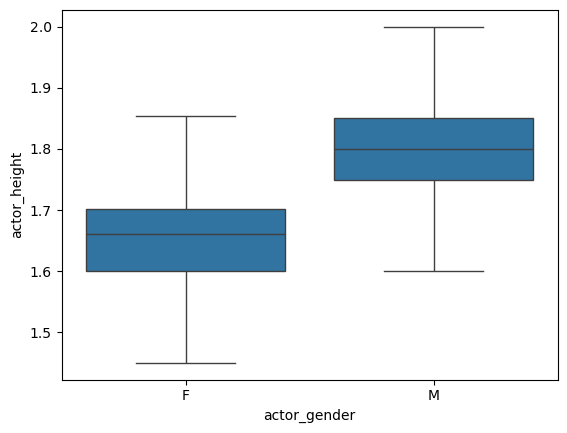

In [25]:
sns.boxplot(data=char_indep, x="actor_gender", y="actor_height", showfliers=False)

M is higher than F noticeably almost for every race except Carribean, where they are almost the same

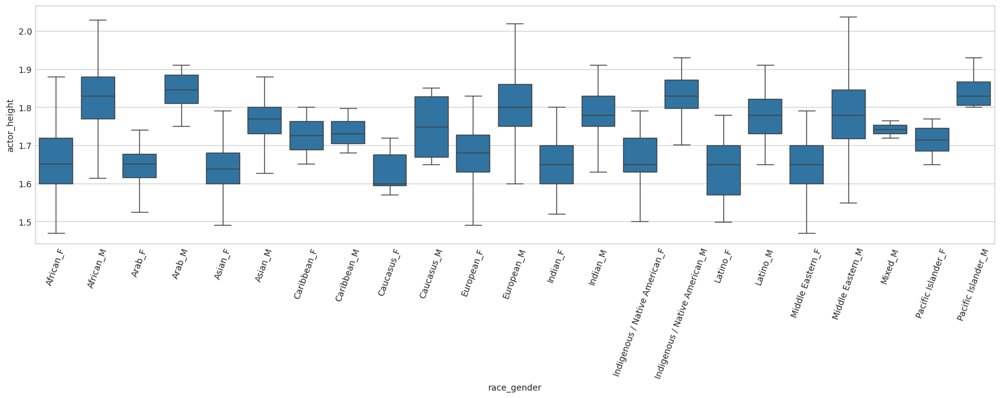

In [27]:
char_indep["race_gender"] = char_indep["race"] + "_" + char_indep["actor_gender"]

with plt.style.context("seaborn-v0_8-whitegrid"):
    plt.figure(figsize=(20, 5))

    sns.boxplot(
        data=char_indep,
        x="race_gender",
        y="actor_height",
        showfliers=False,
        order=char_indep["race_gender"].dropna().sort_values().unique(),
    )
    plt.xticks(rotation=70)

Now let's consider the ratio between M and F in every race.\
It can be seen that the ratios are almost the same in the Asian group. They are completely different in Carribean group, where more than 70% of actors are male.

In [28]:
char_indep_gender_by_race = (
    char_indep[["actor_gender", "race"]]
    .groupby("race")["actor_gender"]
    .value_counts()
    .unstack(fill_value=0)
    .reset_index()
)
char_indep_gender_by_race["total"] = char_indep_gender_by_race[["F", "M"]].sum(axis=1)

char_indep_gender_by_race["F"] /= char_indep_gender_by_race["total"]
char_indep_gender_by_race["M"] /= char_indep_gender_by_race["total"]

<Axes: title={'center': 'Gender by race'}, ylabel='race'>

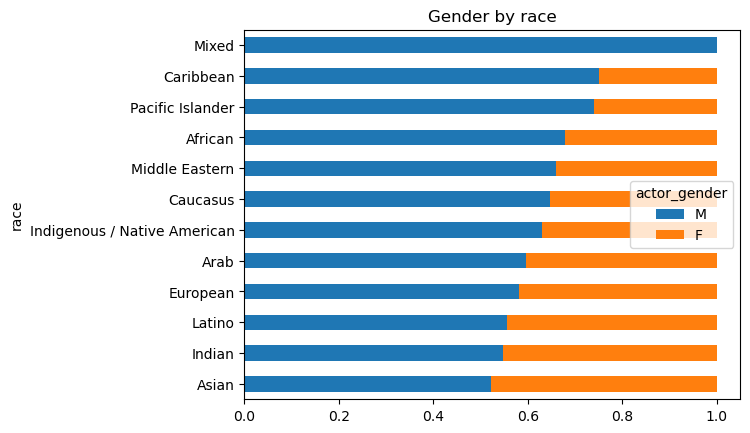

In [29]:
char_indep_gender_by_race[["race", "M", "F"]].sort_values(by="M", ascending=True).plot(
    x="race",
    kind="barh",
    stacked=True,
    title="Gender by race",
    mark_right=True,
)

It also might be instumental to know the distribution of races.\
It can be seen that Europeans are the hugest part, and together with Africans they are about 60% of the whole races distribution

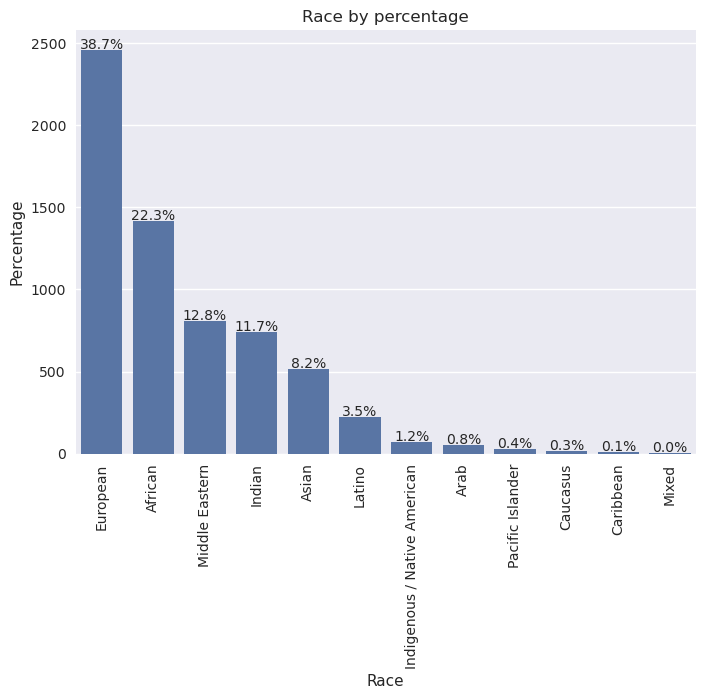

In [30]:
# Taken from https://www.kaggle.com/code/werooring/nfl-big-data-bowl-basic-eda-for-beginner
def write_percent(ax, total_size):
    """Traverse the figure object and display the ratio at the top of the bar graph."""
    for patch in ax.patches:
        height = patch.get_height()  # Figure height (number of data)
        width = patch.get_width()  # Figure width
        left_coord = patch.get_x()  # The x-axis position on the left edge of the figure
        percent = height / total_size * 100  # percent

        # Type text in the (x, y) coordinates
        ax.text(
            x=left_coord + width / 2.0,  # x-axis position
            y=height + total_size * 0.001,  # y-axis position
            s=f"{percent:1.1f}%",  # Text
            ha="center",
        )  # in the middle


with plt.style.context("seaborn-v0_8"):
    plt.title("Race by percentage")
    ax = sns.countplot(
        x=char_indep.race,
        order=char_indep.race.value_counts().sort_values(ascending=False).index,
    )
    write_percent(ax, len(char_indep.race.dropna()))
    plt.xlabel("Race")
    plt.xticks(rotation=90)
    plt.ylabel("Percentage")

We plan to also look at the distribution of date of births.\
One can notice that the it has mode at ~1970. \
Surprusingly, the peacks for M and F are different (1970 and 1980 respectively).\


*The peak might be because of the following reasons:*
1. *Movie industry became much more famous*
2. *The overall population was increasing*
3. *And much more, we do not know a lot about History of that time...*

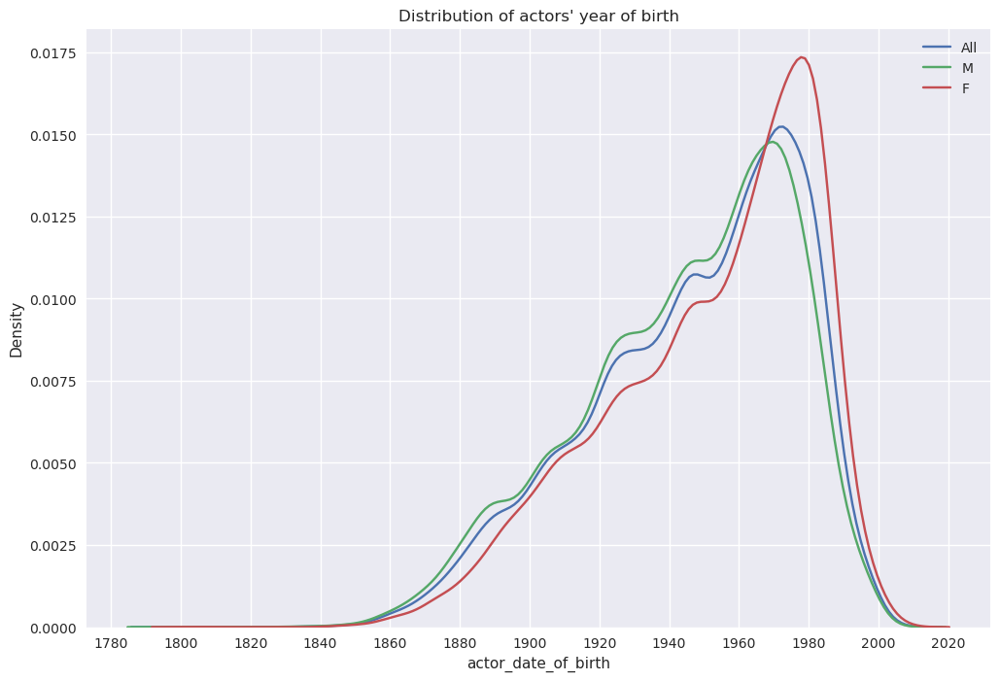

In [31]:
with plt.style.context("seaborn-v0_8"):
    plt.figure(figsize=(12, 8))
    plt.title("Distribution of actors' year of birth")
    sns.kdeplot(char_indep.actor_date_of_birth.dt.year, label="All")
    sns.kdeplot(
        char_indep.query("actor_gender=='M'").actor_date_of_birth.dt.year, label="M"
    )
    sns.kdeplot(
        char_indep.query("actor_gender=='F'").actor_date_of_birth.dt.year, label="F"
    )
    plt.xticks(ticks=[i for i in range(1780, 2021, 20)])
    plt.legend()

## Descriptive statistics for movies

In [32]:
movies_processed.rename(
    columns={
        "Wikipedia movie ID": "wikipedia_movie_id",
        "Freebase movie ID": "fb_movie_id",
        "Movie name": "movie_name",
        "Movie box office revenue": "revenue",
        "Movie runtime": "movie_runtime",
    },
    inplace=True,
)

In [33]:
movies_processed

,wikipedia_movie_id,fb_movie_id,movie_name,revenue,movie_runtime,languages,movie_release_date,countries_old,countries,genres
0,975900,/m/03vyhn,Ghosts of Mars,14010832.0,98.0,['english'],2001-08-24,['United States of America'],['United States of America'],"['Adventure', 'Horror', 'Action', 'Thriller', ..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,NaN,95.0,['english'],2000-02-16,['United States of America'],['United States of America'],"['Crime', 'Drama', 'Mystery', 'Biography']"
2,28463795,/m/0crgdbh,Brun bitter,NaN,83.0,['norwegian'],1988-01-01,['Norway'],['Norway'],"['Crime', 'Drama']"
3,9363483,/m/0285_cd,White Of The Eye,NaN,110.0,['english'],1987-01-01,['United Kingdom'],['United Kingdom'],"['Erotic', 'Thriller']"
4,261236,/m/01mrr1,A Woman in Flames,NaN,106.0,['german'],1983-01-01,['Germany'],['Germany'],['Drama']
...,...,...,...,...,...,...,...,...,...,...
81736,35228177,/m/0j7hxnt,Mermaids: The Body Found,NaN,120.0,['english'],2011-03-19,['United States of America'],['United States of America'],['Drama']
81737,34980460,/m/0g4pl34,Knuckle,NaN,96.0,['english'],2011-01-21,"['Ireland', 'United Kingdom']","['Ireland', 'United Kingdom']","['Documentary', 'Drama', 'Biography']"
81738,9971909,/m/02pygw1,Another Nice Mess,NaN,66.0,['english'],1972-09-22,['United States of America'],['United States of America'],"['Comedy', 'Satire']"
81739,913762,/m/03pcrp,The Super Dimension Fortress Macross II: Lover...,NaN,150.0,['japanese'],1992-05-21,['Japan'],['Japan'],"['Drama', 'Adventure', 'Short Film', 'Cartoon'..."


Let's check out some simple distributions and statistics

In [34]:
movies_processed.sort_values(by="revenue", ascending=False).head(10)[
    ["movie_name", "revenue"]
]

,movie_name,revenue
23702,Avatar,2.782275e+09
22256,Titanic,2.185372e+09
28192,The Avengers,1.511758e+09
30278,Harry Potter and the Deathly Hallows – Part 2,1.328111e+09
18645,Transformers: Dark of the Moon,1.123747e+09
80920,The Lord of the Rings: The Return of the King,1.119930e+09
54719,The Dark Knight Rises,1.078009e+09
69586,Toy Story 3,1.063172e+09
14303,Pirates of the Caribbean: On Stranger Tides,1.043872e+09
50039,Star Wars Episode I: The Phantom Menace,1.027045e+09


In [35]:
movies_processed.sort_values(by="movie_runtime", ascending=False).head(10)[
    ["movie_name", "movie_runtime"]
]

,movie_name,movie_runtime
12804,Zero Tolerance,1079281.00
62962,Modern Times Forever,14400.00
71100,Cinématon,9360.00
21733,Matrjoschka,5700.00
46666,The Cure for Insomnia,5220.00
16316,Paradise in Harlem,5100.00
27036,Kai Koduttha Dheivam,4875.27
68223,The Longest Most Meaningless Movie in the World,2880.00
73658,Gigantor,2425.00
73630,Dil Ne Phir Yaad Kiya,1966.00


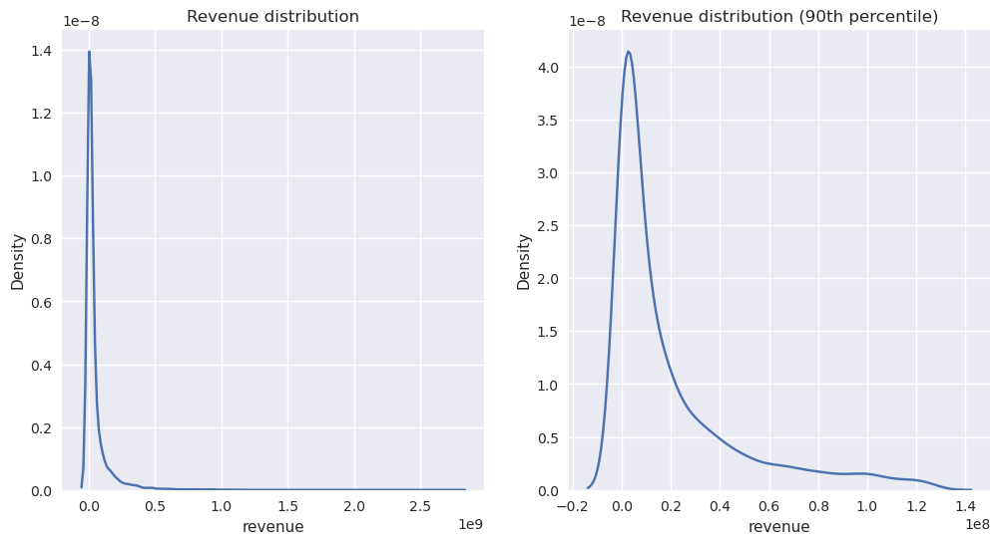

In [36]:
with plt.style.context("seaborn-v0_8"):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title("Revenue distribution")
    sns.kdeplot(movies_processed["revenue"])
    plt.subplot(1, 2, 2)
    plt.title("Revenue distribution (90th percentile)")
    sns.kdeplot(
        movies_processed["revenue"][
            movies_processed["revenue"] < movies_processed["revenue"].quantile(0.9)
        ]
    )

It is also usefull to check out the distribution of genres, languages, and countries.

1. The most frequent genre is Drama (17%), then Comedy (10%), then Romance, Action, Thriller (5%)
2. The most frequent language is english (50%), then hindi, spanish, french (4.5%)
3. The most frequent country is US (40%), India and UK (10%), then France, Germany and Italy (4-5%)

100%|██████████| 81741/81741 [00:01<00:00, 46302.74it/s]


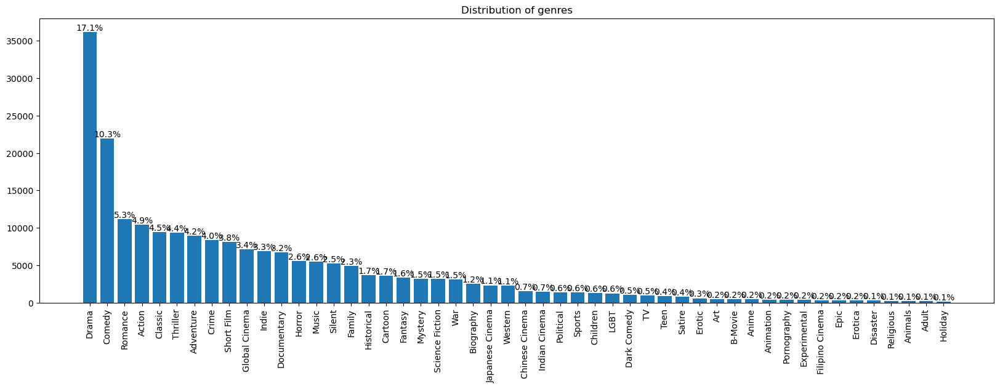

100%|██████████| 81741/81741 [00:01<00:00, 56252.77it/s]


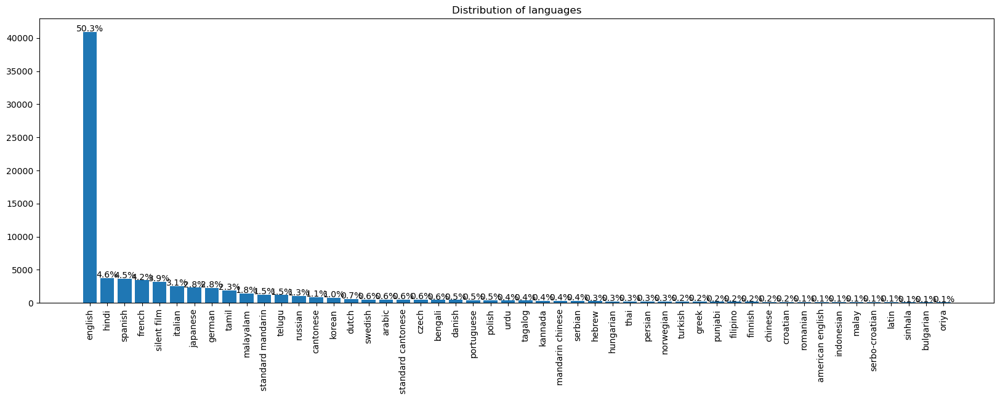

100%|██████████| 81741/81741 [00:01<00:00, 48983.95it/s]


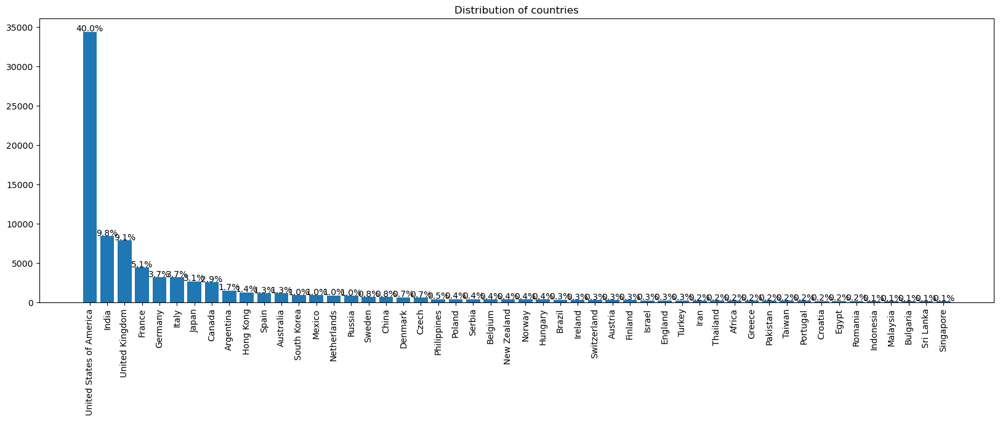

In [37]:
def get_distribution_from_list(data, column_of_list):
    data = data.copy().dropna(subset=[column_of_list])
    list_to_values = {}
    for _, row in tqdm(data.iterrows(), total=data.shape[0]):
        for el in eval(row[column_of_list]):
            if not el in list_to_values:
                list_to_values[el] = 0
            list_to_values[el] += 1
    result = (
        pd.DataFrame(pd.Series(list_to_values))
        .reset_index()
        .rename(columns={0: "value", "index": "smth"})
    )
    result.sort_values("value", ascending=False, inplace=True)
    result_cut = result.iloc[:50]
    plt.bar(result_cut["smth"], result_cut["value"])
    write_percent(plt.gca(), result["value"].sum())
    plt.xticks(rotation=90)


for column in ["genres", "languages", "countries"]:
    plt.figure(figsize=(20, 6))
    plt.title(f"Distribution of {column}")
    get_distribution_from_list(movies_processed, column)
    plt.show()

In [38]:
def list_to_values(data, column_of_list, column_value, use_sum):
    data = data.copy()
    list_to_values = {}
    for _, row in tqdm(data.iterrows(), total=data.shape[0]):
        value = row[column_value]
        if value is None:
            continue
        for el in eval(row[column_of_list]):
            if not el in list_to_values:
                list_to_values[el] = []
            list_to_values[el].append(value)

    for key in list_to_values:
        if use_sum:
            list_to_values[key] = np.sum(list_to_values[key])
        else:
            list_to_values[key] = np.median(list_to_values[key])
    return (
        pd.DataFrame(pd.Series(list_to_values))
        .reset_index()
        .rename(columns={0: "value", "index": "smth"})
    )


def get_distribution_by(
    data, column=None, func_to_apply=None, column_to_apply=None, title="", use_sum=False
):
    """
    This function helps to get the distribution of the data by:
    1. Year
    2. County
    3. Genre
    4. Language

    It also plots the distribution of the data by the above-mentioned categories.
    """
    data = data.copy().dropna(subset=[column])
    if not func_to_apply is None:
        data[column] = data[column_to_apply].apply(func_to_apply)

    # by year
    data["year"] = data["movie_release_date"].dt.year
    if use_sum:
        by_year = pd.DataFrame(data.groupby("year")[column].sum()).reset_index()
    else:
        by_year = pd.DataFrame(data.groupby("year")[column].mean()).reset_index()

    # by country
    by_country = list_to_values(data, "countries", column, use_sum=use_sum)

    # by genre
    by_genre = list_to_values(data, "genres", column, use_sum=use_sum)

    # by language
    by_language = list_to_values(data, "languages", column, use_sum=use_sum)

    with plt.style.context("seaborn-v0_8"):
        plt.figure(figsize=(15, 30))
        plt.suptitle(title)
        for i, by_smth, name in zip(
            [0, 1, 2, 3],
            [by_year, by_country, by_genre, by_language],
            ["year", "country", "genre", "language"],
        ):
            plt.subplot(4, 1, i + 1)
            plt.title(name)
            if i == 0:
                by_smth = by_smth.sort_values("year")
                xname = "year"
                yname = column
            else:
                by_smth = by_smth.sort_values("value", ascending=False)
                xname = "smth"
                yname = "value"
                by_smth = by_smth.iloc[:50]
            plt.plot(by_smth[xname], by_smth[yname])
            plt.xticks(rotation=90, ha="right")
        plt.tight_layout(rect=[0, 0.01, 1, 0.95])
    return by_year, by_country, by_genre, by_language

1. Revenue increases throughout the years
2. US, UK have the biggest revenue
3. Adventure and Drama genres have the biggest revenue
4. Cinemas made in english have the biggest revenue

100%|██████████| 8401/8401 [00:00<00:00, 33890.59it/s]


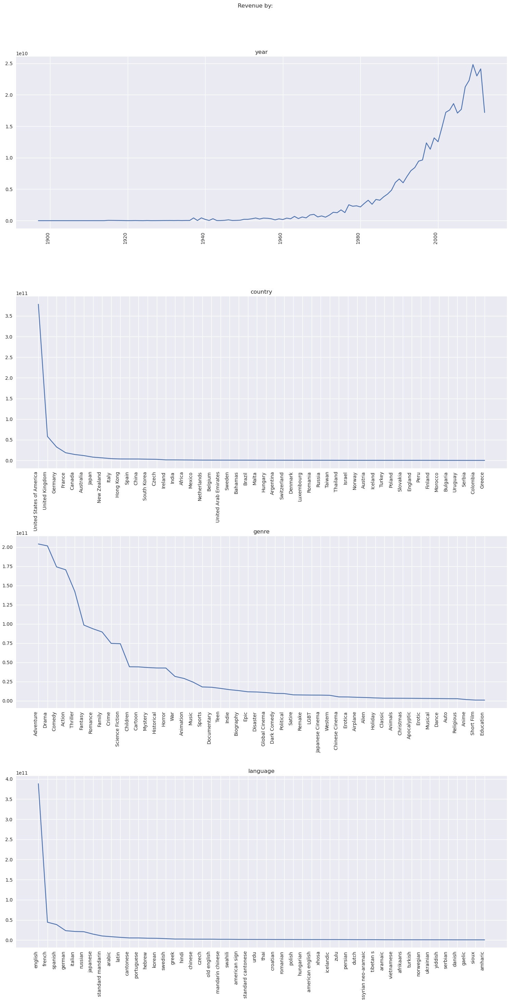

In [39]:
get_distribution_by(movies_processed, "revenue", title="Revenue by:", use_sum=True);

Let's also consider the **average** revenue

1. Average revenue increases throughout the years
2. For some reason Bahamas, Malta and Peru have the biggest average revenue
3. Apocalyptic genre has the biggest Average revenue
4. Cinemas made in old english have the biggest average revenue

  0%|          | 0/8401 [00:00<?, ?it/s]

100%|██████████| 8401/8401 [00:00<00:00, 52415.54it/s]


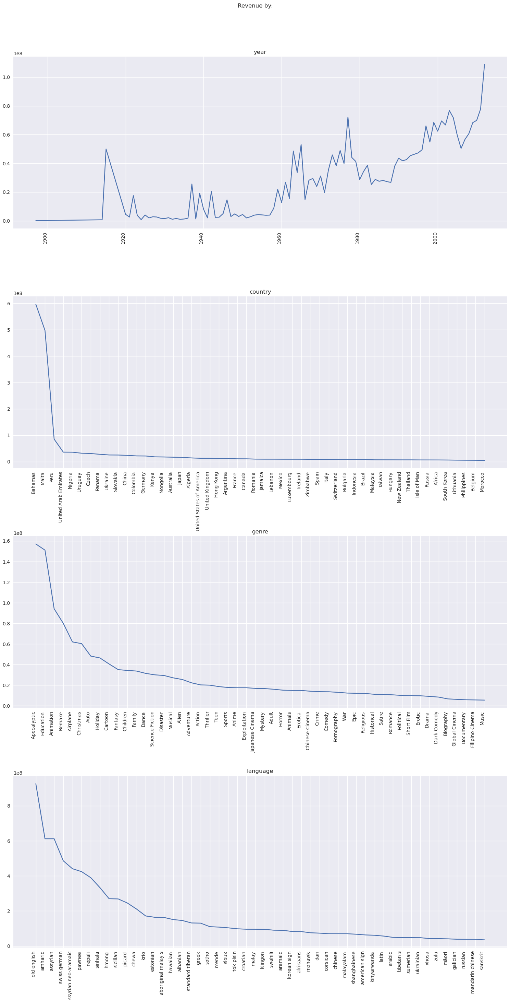

In [40]:
get_distribution_by(movies_processed, "revenue", title="Revenue by:", use_sum=False);

1. Runtime increases throughout the years
2. Libya and some Indian countries (or countries which are close to it) have the biggest runtime.
3. Serial have the highest runtime (obviously), then its indian cinema

  0%|          | 0/61291 [00:00<?, ?it/s]

100%|██████████| 61291/61291 [00:09<00:00, 6504.73it/s]


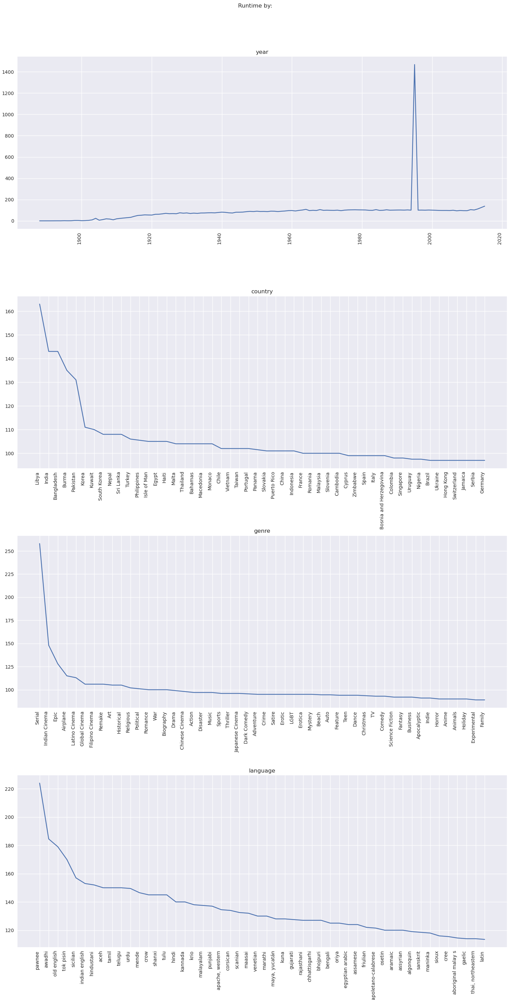

In [ ]:
get_distribution_by(movies_processed, "movie_runtime", title="Runtime by:");

Average number of languages by film throughout the time:

We see one significant drop in 1930s and slight increase until the second drop in 2010s 

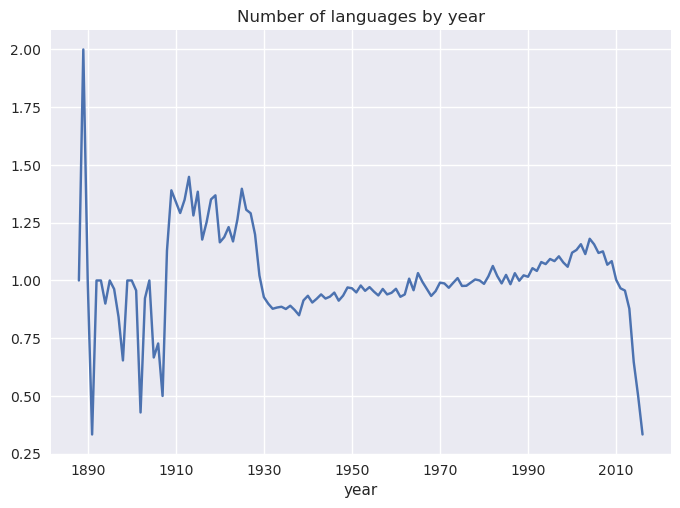

In [ ]:
with plt.style.context("seaborn-v0_8"):
    movies_processed["year"] = movies_processed["movie_release_date"].dt.year
    movies_processed["language_num"] = movies_processed["languages"].apply(
        lambda x: len(eval(x))
    )
    movies_processed[["year", "language_num"]].groupby("year")[
        "language_num"
    ].mean().plot(x="year", y="language_num", title="Number of languages by year")
    plt.xticks(ticks=[i for i in range(1890, 2021, 20)]);

Average number of genres by film throughout the time:

Slight decrease until 1950 and then slight increase until 2010

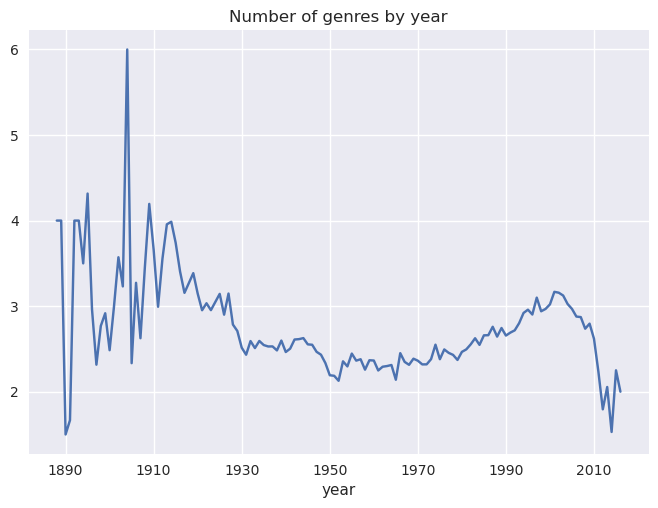

In [ ]:
with plt.style.context("seaborn-v0_8"):
    movies_processed["year"] = movies_processed["movie_release_date"].dt.year
    movies_processed["genre_num"] = movies_processed["genres"].apply(
        lambda x: len(eval(x))
    )
    movies_processed[["year", "genre_num"]].groupby("year")["genre_num"].mean().plot(
        x="year", y="genre_num", title="Number of genres by year"
    )
    plt.xticks(ticks=[i for i in range(1890, 2021, 20)]);

It is also quite interesting to look at how the average number of words changed throughout the time.

We see that it is almost constant and doesn't significantly change

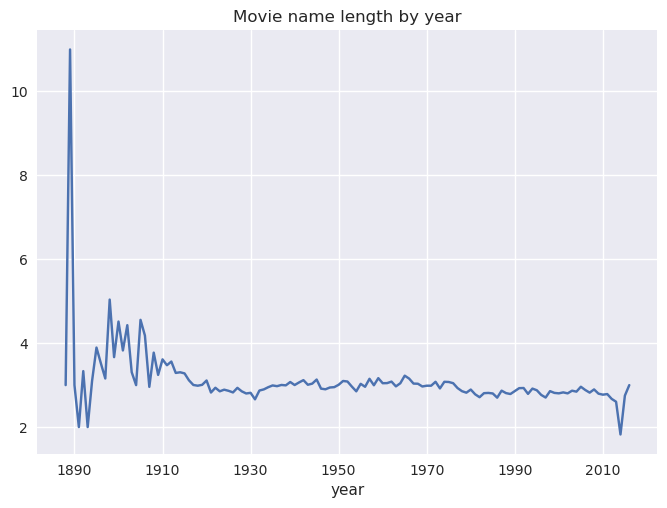

In [ ]:
with plt.style.context("seaborn-v0_8"):
    movies_processed["year"] = movies_processed["movie_release_date"].dt.year
    movies_processed["movie_name_len"] = movies_processed["movie_name"].apply(
        lambda x: len(x.split(" "))
    )
    movies_processed[["year", "movie_name_len"]].groupby("year")[
        "movie_name_len"
    ].mean().plot(x="year", y="movie_name_len", title="Movie name length by year")
    plt.xticks(ticks=[i for i in range(1890, 2021, 20)]);

Movie number by year. 

We see very fast increase of the number of films by year. Almost 5 times during 100 years

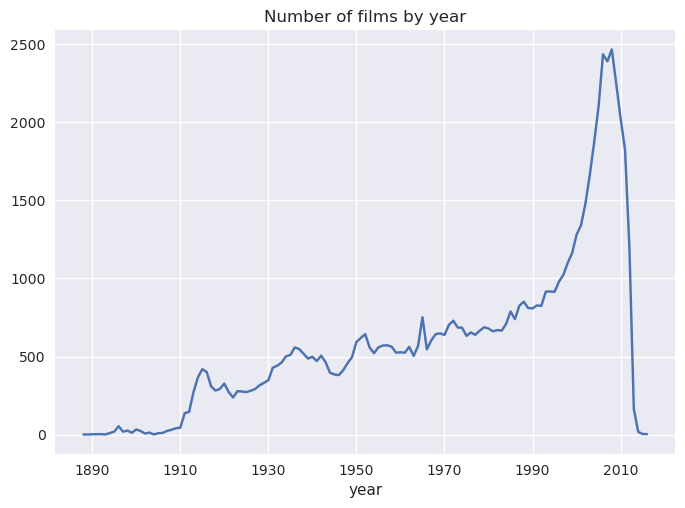

In [ ]:
with plt.style.context("seaborn-v0_8"):
    movies_processed["year"] = movies_processed["movie_release_date"].dt.year
    movies_processed[["year", "movie_name"]].groupby("year")["movie_name"].count().plot(
        x="year", y="movine_name", title="Number of films by year"
    )
    plt.xticks(ticks=[i for i in range(1890, 2021, 20)]);

Revenue by the number of languages.

It decreases with the increase of the number of languages!

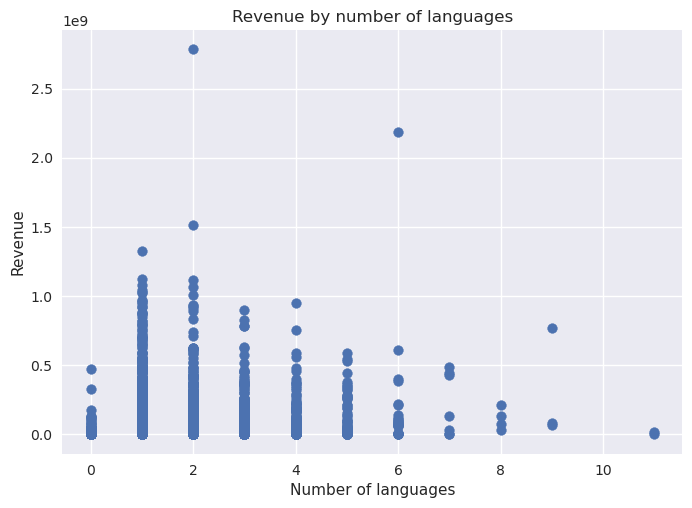

In [ ]:
with plt.style.context("seaborn-v0_8"):
    plt.title("Revenue by number of languages")
    plt.scatter(movies_processed["language_num"], movies_processed["revenue"])
    plt.xlabel("Number of languages")
    plt.ylabel("Revenue");

Most popular genre by country

In [ ]:
correspondeces_genre_country = {}

all_genres = set([i for j in movies_processed["genres"].values for i in eval(j)])
all_countries = set([i for j in movies_processed["countries"].values for i in eval(j)])

for g in all_genres:
    for c in all_countries:
        if not g in correspondeces_genre_country:
            correspondeces_genre_country[g] = {}
        correspondeces_genre_country[g][c] = 0

for _, row in tqdm(
    movies_processed[["genres", "countries"]].dropna().iterrows(),
    total=len(movies_processed),
):
    genres_curr = eval(row["genres"])
    countries_curr = eval(row["countries"])
    for g in genres_curr:
        for c in countries_curr:
            correspondeces_genre_country[g][c] += 1

100%|██████████| 81741/81741 [00:36<00:00, 2220.43it/s]


The results are quite predictable. Drama in the majority of the countries and some country specific (like Chinese Cinema in China)

In [ ]:
correspondeces_genre_country_pd = pd.DataFrame(correspondeces_genre_country)
normalized_corres_gc = (
    correspondeces_genre_country_pd.values
    / correspondeces_genre_country_pd.values.sum(axis=1)[:, None]
)
correspondeces_genre_country_pd["most_popular"] = (
    correspondeces_genre_country_pd.columns[normalized_corres_gc.argmax(axis=1)]
)
print(
    correspondeces_genre_country_pd.sort_values("most_popular")[
        "most_popular"
    ].to_string()
)

Bhutan                            Adventure
China                        Chinese Cinema
Hong Kong                    Chinese Cinema
Taiwan                       Chinese Cinema
Argentina                           Classic
Malaysia                             Comedy
Uzbekistan                           Comedy
Czech                                Comedy
Crime                                 Crime
Qatar                           Documentary
Senegal                         Documentary
Congo                           Documentary
Ethiopia                        Documentary
Switzerland                           Drama
Denmark                               Drama
Peru                                  Drama
Zambia                                Drama
United States of America              Drama
Wales                                 Drama
Indonesia                             Drama
Cuba                                  Drama
Vietnam                               Drama
Bosnia and Herzegovina          

## Characters and movies dependencies

In [ ]:
data_merged_raw = char_processed.merge(
    movies_processed.drop(columns=["fb_movie_id", "movie_release_date"]),
    on="wikipedia_movie_id",
)

In [ ]:
# we do not need every column in our current analysis
data_merged = data_merged_raw[
    [
        "wikipedia_movie_id",
        "character_name",
        "actor_gender",
        "actor_height",
        "fb_actor_eth_id",
        "actor_name",
        "fb_char_actor_map_id",
        "fb_char_id",
        "fb_actor_id",
        "actor_date_of_birth",
        "movie_release_date",
        "ethn_name",
        "race",
        "movie_name",
        "revenue",
        "movie_runtime",
        "languages",
        "countries_old",
        "countries",
        "genres",
        "year",
        "language_num",
        "genre_num",
        "movie_name_len",
    ]
]

Index(['wikipedia_movie_id', 'fb_movie_id', 'character_name', 'actor_gender',
       'actor_height', 'fb_actor_eth_id', 'actor_name', 'fb_char_actor_map_id',
       'fb_char_id', 'fb_actor_id', 'actor_date_of_birth',
       'movie_release_date', 'ethn_name', 'race', 'movie_name', 'revenue',
       'movie_runtime', 'languages', 'countries_old', 'countries', 'genres',
       'year', 'language_num', 'genre_num', 'movie_name_len'],
      dtype='object')

We can really look at a lot of dependencies between the revenue and actors (revenue and number of actors, revenue and races, revenue and actors heights, revenue and percentage of females, revenue and average age of actors and so on).
The same analysis can be made for movie_runtime.

But it is not the main part of our task so we just look at the depende between revenue and the number of actors.

We can see that there is a slight but statistically significant correlation.\
(We use spearman correlation because actors_count is non continuous)

SignificanceResult(statistic=np.float64(0.502382366433091), pvalue=np.float64(0.0))


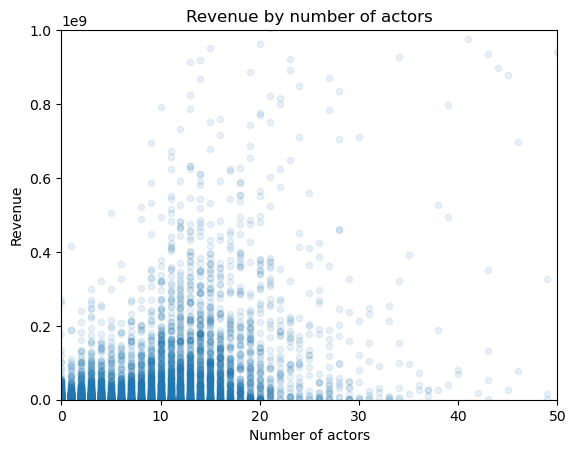

In [ ]:
from scipy.stats import spearmanr

revenue_by_actors_count = (
    data_merged[["movie_name", "character_name"]]
    .groupby(["movie_name"])
    .count()
    .reset_index()
    .rename(columns={"character_name": "actors_count"})
    .merge(movies_processed[["movie_name", "revenue"]], on="movie_name")[
        ["actors_count", "revenue"]
    ]
    .dropna()
)

print(
    spearmanr(
        revenue_by_actors_count["actors_count"], revenue_by_actors_count["revenue"]
    )
)
revenue_by_actors_count.plot(x="actors_count", y="revenue", kind="scatter", alpha=0.1)
plt.xlim(0, 50)
plt.ylim(0, 1e9)
plt.title("Revenue by number of actors")
plt.xlabel("Number of actors")
plt.ylabel("Revenue");

It might be useful to make the correspondence matrix between countries and races. 

In [ ]:
correspondeces_race_country = {}

all_races = data_merged["race"].dropna().unique()
all_countries = set([i for j in data_merged["countries"].values for i in eval(j)])

for r in all_races:
    for c in all_countries:
        if not r in correspondeces_race_country:
            correspondeces_race_country[r] = {}
        correspondeces_race_country[r][c] = 0

for _, row in tqdm(
    data_merged[["race", "countries"]].dropna().iterrows(), total=len(data_merged)
):
    race = row["race"]
    for c in eval(row["countries"]):
        correspondeces_race_country[race][c] += 1

 26%|██▌       | 86218/334987 [00:29<01:24, 2939.62it/s]


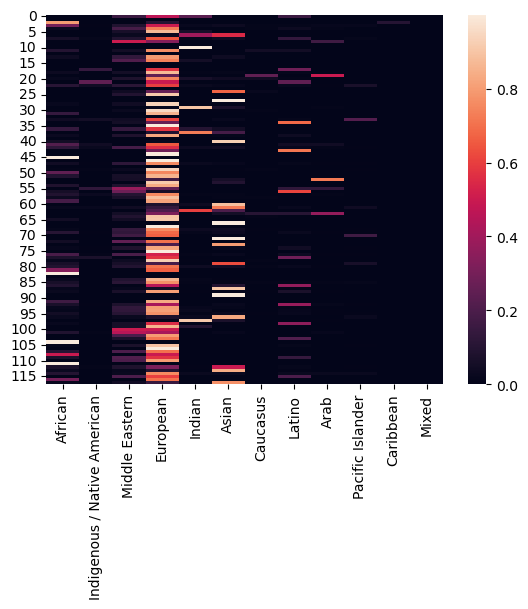

In [ ]:
correspondeces_race_country_pd = pd.DataFrame(correspondeces_race_country)
# normalize by sum of other races
normalized_corres = correspondeces_race_country_pd.values / (
    1e-6 + correspondeces_race_country_pd.values.sum(axis=1)[:, None]
)
sns.heatmap(normalized_corres)
plt.xticks(
    ticks=np.arange(0, 12) + 0.5,
    labels=correspondeces_race_country_pd.columns,
    rotation=90,
);

For every country look at the most popular race.\
*The results are quite predictable because the most popular races in movies are the same as the most popular race living in the country*

In [ ]:
correspondeces_race_country_pd["most_popular"] = correspondeces_race_country_pd.columns[
    normalized_corres.argmax(axis=1)
]
print(
    correspondeces_race_country_pd.sort_values("most_popular")[
        "most_popular"
    ].to_string()
)

Cambodia                           African
Costa Rica                         African
Estonia                            African
Azerbaijan                         African
Jordan                             African
Qatar                              African
Congo                              African
Burkina Faso                       African
Senegal                            African
Mongolia                           African
Macau                              African
Kenya                              African
Ethiopia                           African
Crime                              African
Guinea                             African
Jamaica                            African
Mali                               African
Cameroon                           African
Iran                                  Arab
Armenia                               Arab
Egypt                                 Arab
Nepal                                Asian
South Korea                          Asian
Philippines

# Data enriching: actor & character features
Responsible: Andrew

---

To gather actors information, at this point, we will use `wikipediaapi`. 

Core logic is described in `src/scripts/actor_metadata_selection.py`.

This Python script extracts character and actor descriptions from Wikipedia using the wikipedia-api library. It processes a CSV file containing movie and actor data, retrieves relevant descriptions from Wikipedia, and appends them to a new dataset.

The script uses the WikipediaMetadataSelectorForActor class to handle the extraction and several supporting functions for data reading, processing, and writing.

The main methods are:

- `extract_character_description`
    - Given a movie_id and a character_name, this method retrieves the Wikipedia page for the movie and searches for the "Plot" section.
    - It splits the plot into sentences and finds those containing the character's name.
    - If a sentence is found, it returns the first sentence mentioning the character.
- `extract_actor_description`
    - Given an actor_name, this method retrieves the actor's Wikipedia page and extracts the first significant paragraph (longer than 50 characters).
    - The paragraph is truncated if it's too long.

Using this logic, information for actors and characters extracted. Here's an example of how to use the tool:

```bash
python ./src/scripts/actor_metadata_selection.py \
    --data_dir <path1> \
    --output_dir <path2> \
    --n_rows 100
```

Enriched csv file is comited to this repository as processing takes some time. Let's take a look at it.

In [ ]:
import pandas as pd

df = pd.read_csv("./data/MovieSummaries/character_processed_enriched.csv")
df = df[["character_name", "actor_name", "character_description", "actor_description"]][
    1:
]
df

,character_name,actor_name,character_description,actor_description
1,Akooshay,Wanda De Jesus,NaN,"Wanda De Jesus (born August 26, 1958) is an Am..."
2,Lieutenant Melanie Ballard,Natasha Henstridge,NaN,"Natasha Tonya Henstridge (born August 15, 1974..."
3,Desolation Williams,Ice Cube,NaN,"O'Shea Jackson Sr. (born June 15, 1969), known..."
4,Sgt Jericho Butler,Jason Statham,NaN,Jason Statham ( STAY-thəm; born 26 July 1967) ...
5,Bashira Kincaid,Clea DuVall,NaN,Clea Helen D'Etienne DuVall (born September 25...
...,...,...,...,...
95,NaN,M. G. Soman,NaN,M. G. Soman (28 October 1941 – 12 December 199...
96,NaN,Nedumudi Venu,NaN,Kesavan Venugopal (22 May 1948 – 11 October 20...
97,Lucy,Ruby Lin,NaN,Ruby Lin Xin-ru (Chinese: 林心如; pinyin: Lín Xīn...
98,Sophie,Zhang Ziyi,NaN,Zhang Ziyi ([ʈʂáŋ tsɹ̩̀.ǐ]; Chinese: 章子怡; born...


We can see that for actors descriptions a lot of additional data was found

In [52]:
df[~df.actor_description.isna()]

,character_name,actor_name,character_description,actor_description
1,Akooshay,Wanda De Jesus,NaN,"Wanda De Jesus (born August 26, 1958) is an Am..."
2,Lieutenant Melanie Ballard,Natasha Henstridge,NaN,"Natasha Tonya Henstridge (born August 15, 1974..."
3,Desolation Williams,Ice Cube,NaN,"O'Shea Jackson Sr. (born June 15, 1969), known..."
4,Sgt Jericho Butler,Jason Statham,NaN,Jason Statham ( STAY-thəm; born 26 July 1967) ...
5,Bashira Kincaid,Clea DuVall,NaN,Clea Helen D'Etienne DuVall (born September 25...
...,...,...,...,...
95,NaN,M. G. Soman,NaN,M. G. Soman (28 October 1941 – 12 December 199...
96,NaN,Nedumudi Venu,NaN,Kesavan Venugopal (22 May 1948 – 11 October 20...
97,Lucy,Ruby Lin,NaN,Ruby Lin Xin-ru (Chinese: 林心如; pinyin: Lín Xīn...
98,Sophie,Zhang Ziyi,NaN,Zhang Ziyi ([ʈʂáŋ tsɹ̩̀.ǐ]; Chinese: 章子怡; born...


# Data enriching: movie features
Responsible: Kirill A

---

Here we will make the similar pipeline, as in enriching actor & character features, using ``wikipediaapi``.
The explanations are presented in ``src/scripts/movie_metadata_selection.py``.

The script extracts movie metadata from Wikipedia using the wikipedia-api library and produces ``.csv`` file containing movie metadata, retrieving relevant descriptions from Wikipedia, and after appends them to a new dataset.

The script uses the WikipediaMetadataSelectorForMovie class to handle the extraction and several supporting functions for data reading, processing, and writing.

The main method is:

- `extract_metadata_description`
    - Given a movie_id, this method retrieves the Wikipedia page for the movie and searches for the "(Top)" section and parses the Release date, Genre and cast by using the keywords
    - Then it searches for the "Plot" section and retrieves the ``plot_summary``
 
You can use this tool with:

```bash
python ./src/scripts/movie_metadata_selection.py \
    --data_dir <path1> \
    --output_dir <path2> \
    --n_rows 100
```

The file ``movie_processed_enriched.csv`` is commited to the repository. Let's take a look at it:

In [8]:
! python ../scripts/movie_metadata_selection.py --n_rows 10 --data_dir ../../data/MovieSummaries --input_file_name movie_processed_v2.csv

Starting movie data enrichment...
Input file: ../../data/MovieSummaries/movie_processed_v2.csv
Output file: /Users/alexdremov/DocumentsLocal/StudyLocal/epfl/ada/project/src/notebooks/data/MovieSummaries/movie_processed_enriched.json
Processing 10 rows
Processing 10 rows...
Index(['Wikipedia movie ID', 'Freebase movie ID', 'Movie name',
       'Movie box office revenue', 'Movie runtime', 'languages',
       'movie_release_date', 'countries_old', 'countries', 'genres',
       'wiki_api_title'],
      dtype='object')
100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 1231.23it/s]
Enrichment complete! Check movie_enrichment.log for details.


Data for movies is gathered this way. The final summaries can be found in `data/MovieSummaries/summaries.json` (check `data/MovieSummaries/load.sh`)

The summaries are simply assembled from data gathered from wiki (can be found in `src/notebooks/process_enriched_movies.ipynb`)

`movie_processed_v2.csv` is made by converting wiki id to wiki title, which is used to fetch data from wiki about the movie

# Freebase

Freebase data is used to gather information about actors, as the provided data is incomplete. 

We use the whole data dump (3 billion entries) and grep entries with relevant ids (aka actor freebase id). The processing code may be found in 
`src/notebooks/freebase_reader.ipynb` and `src/notebooks/freebase_movies.ipynb`.

The result of processing can be found in `data/enriched/actors`

In [11]:
import pandas as pd

pd.read_csv("../../data/enriched/actors/actors_freebase.csv").head(3)

,Unnamed: 0,education,count_guest_roles,places_lived,spouses,children,professions_num,professions,date_of_birth,nationality,...,discription,id,wiki_en_path,wiki_en_title,wiki_en_page,wiki_en_id,height,religion,weight,freebase_to_wiki_title
0,0,False,0,0,0,0,1,['Actor'],1970-01-02,Germany,...,Chris Hohenester is a German actress.,/m/0j50vrd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Chris Hohenester
1,1,False,0,1,0,0,5,"['Screenwriter', 'Comedian""-GB', 'Writer', 'Fi...",1960-02-27,United States of America,...,"Mary Joseph \""Mary Jo\"" Pehl is an American wr...",/m/03xmr6,/wikipedia/en/Mary_Jo_Pehl,Mary_Jo_Pehl,http://en.wikipedia.org/wiki/index.html?curid=...,995072.0,NaN,NaN,NaN,Mary Jo Pehl
2,2,True,14,1,0,0,5,"['Voice acting""-GB', 'Actor', 'Comedian""-GB', ...",1978-11-23,United Kingdom,...,"Kayvan Novak is a British-Iranian actor, voice...",/m/0gwpbl,/wikipedia/en_id/6912128,Kayvan_Novak,http://en.wikipedia.org/wiki/Kayvan_Novak,6912128.0,1.85,NaN,NaN,Kayvan Novak


# Archetype inference
Responsible: Kirill Z

---

Configs and model requests code can be found in `./src/models`

To use model, credentials file for Google API should be provided. They give money for API use, so we have not spent real money for the project (yet)

In [ ]:
import os
import sys

GLOUD_CREDENTIALS = "<path to credentials.json>"
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = GLOUD_CREDENTIALS

To evaluate model's perfomance we will use dataset provided as part of the `Learning Latent Personas of Film Characters` paper.

The article made a test set of 500 examples. To do this, they went to the tvtropes website, and took 72 archetypes, for example https://tvtropes.org/pmwiki/pmwiki.php/Main/TheChanteuse

The authors gathered a dataset of 500 examples. Using these 500 examples, we will tune the model. We split the data into the train/test/validation in the proportion (300/50/150). The comited `personal_identification_test_set.csv` is test set of the splitted data.

Then we took a sample of 20 different examples from the train and selected a reasonable prompt.
Using this prompt, we form a train set and validation set, and tune the LM on google cloud platform.

You can find the training notebook at `src/notebooks/kirill456z-experiments.ipynb`

In [ ]:
import pandas as pd

test_df = pd.read_csv(
    "./data/persona_identification/persona_identification_testset.csv",
    index_col="index",
)
test_df

,character_name,movie_name,persona,movie_summary
index,,,,
5,Ellen Aim,Streets of Fire,chanteuse,"In an unnamed city, Ellen Aim , lead singer of..."
15,Timothy,The Long Kiss Goodnight,casanova,Samantha Caine is a mother and schoolteacher ...
16,Johnny Wickham,Bride and Prejudice,casanova,The plot of the movie is based on Austen′s nov...
26,Roy O'Bannon,Shanghai Noon,retired_outlaw,Chon Wang is a Chinese imperial guard. After P...
36,Jackson Rippner,Red Eye,psycho_for_hire,After attending her grandmother's funeral in D...
...,...,...,...,...
496,Lt. Commander Ron Hunter,Crimson Tide,father_to_his_men,"In post-Soviet Russia, military units loyal to..."
497,Christopher Pike,Star Trek,father_to_his_men,"In 2233, the Federation starship USS Kelvin is..."
498,Zordon,Mighty Morphin' Power Rangers: The Movie,father_to_his_men,"The Power Rangers, Adam , Kimberly , Billy , A..."


Here's the code of trained model inference

In [ ]:
from langchain_core.rate_limiters import InMemoryRateLimiter
from src.models.persona_identification import PersonaIdentification
from langchain.cache import InMemoryCache
from langchain.globals import set_llm_cache
from langchain_redis import RedisCache

# to cache requests to LM, consider using remote redis server
cache = InMemoryCache()
# cache = RedisCache(redis_url="redis://localhost:6379")
set_llm_cache(cache)

rate_limiter = InMemoryRateLimiter(
    requests_per_second=4.99
    / 60,  # free google cloud account allows 5 requests per minute
    check_every_n_seconds=0.1,
    max_bucket_size=5,
)

pi = PersonaIdentification(
    config_path="./src/models/persona_identification_config.yaml",
    cache=cache,
    rate_limiter=rate_limiter,
)

test_df_results = pi.batch(test_df.to_dict(orient="records"))

/var/folders/d_/x1jfcqpx1cl4zcrx9bzpclq00000gn/T/ipykernel_61279/1898440038.py:11: LangChainBetaWarning: Introduced in 0.2.24. API subject to change.
  rate_limiter = InMemoryRateLimiter(


In [ ]:
test_df_results[0]

AIMessage(content='Chanteuse', additional_kwargs={}, response_metadata={'is_blocked': False, 'safety_ratings': [], 'usage_metadata': {'prompt_token_count': 1331, 'candidates_token_count': 4, 'total_token_count': 1335, 'cached_content_token_count': 0}, 'finish_reason': 'STOP', 'avg_logprobs': -0.005151043180376291, 'logprobs_result': {'top_candidates': [], 'chosen_candidates': []}, 'parsing_success': True}, id='run-efcef1dc-d731-4207-9e99-368a422cc09c-0', usage_metadata={'input_tokens': 1331, 'output_tokens': 4, 'total_tokens': 1335})

In [ ]:
from src.models.persona_identification import persona_lowercase
from sklearn.metrics import precision_score, recall_score, f1_score

test_df["model_predictions"] = [
    persona_lowercase(res.content) for res in test_df_results
]
test_df["is_prediction_valid"] = [
    1 if res.response_metadata["parsing_success"] else 0 for res in test_df_results
]

print("Not valid predictions:")
display(test_df[test_df.is_prediction_valid == 0])
print(
    f"Prediction accuracy: {(test_df.model_predictions == test_df.persona).mean(): .3f}"
)

micro_f1 = f1_score(test_df["persona"], test_df["model_predictions"], average="micro")
macro_f1 = f1_score(test_df["persona"], test_df["model_predictions"], average="macro")
print(f"Micro f1: {micro_f1:.2f}")
print(f"Macro f1: {macro_f1:.2f}")

test_df.to_excel("model_predictions_analysis.xlsx");

Not valid predictions:


,character_name,movie_name,persona,movie_summary,model_predictions,is_prediction_valid
index,,,,,,
322,Michael Newman,Click,ditz,"Michael Newman , an architect, is married to h...",workaholic\n\n,0
448,The Lieutenant,Bad Lieutenant,dirty_cop,"The film opens in the Bronx, where The Lieuten...",,0


Prediction accuracy:  0.426
Micro f1: 0.43
Macro f1: 0.30


We see that the model works, and considering high number of classes, actually not bad. 



# Data Story Code

Our data story is purely data-driven. The following code is precisely the code our data story is generated from (with cells removed from the data story)

# Introduction

The project goal is to explore the relationship between actors' traits — such as age, gender, ethnicity — and the character archetypes they portray in films. By analyzing casting patterns, this project aims to find out how specific actor profiles consistently coincide with archetypal roles like heroes, villains, mentors, or lovers. Our goal is to uncover whether certain traits predispose actors to particular roles and identify any underlying biases in casting decisions. This research also explores how these patterns vary across different film industries and across time. Ultimately, we aim to tell the story of how an actor's characteristics shape their cinematic destiny, influencing not only their career trajectory but also how audiences perceive iconic characters on screen.

In [1]:
# ignore
%load_ext autoreload
%autoreload 2

In [2]:
# ignore
%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [3]:
# ignore
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

import os
import sys

sys.path.append(os.path.join(os.getcwd(), "../visualization"))
from plot_3d_like import plot_2d_heatmap

In [4]:
# ignore
sys.path.insert(0, "../..")
from src.scripts.load_data import data

data.shape

(87210, 21)

### Dataset

In [5]:
# ignore

# it is easier and faster to make prints and then copy them to the markdown...
print("nationality", data["nationality"].nunique())
print(
    "known nationality",
    data[["nationality", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("gender", data["actor_gender"].nunique())
print("known gender", data[["gender", "fb_actor_id"]].dropna()["fb_actor_id"].nunique())

print("----")
print("education", data["education"].nunique())
print(
    "known education",
    data[["education", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("religion", data["religion"].nunique())
print(
    "known religion",
    data[["religion", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("race", data["race"].nunique())
print("known race", data[["race", "fb_actor_id"]].dropna()["fb_actor_id"].nunique())

print("----")
print("place_of_birth", data["place_of_birth"].nunique())
print(
    "known place_of_birth",
    data[["place_of_birth", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("professions_num", data["professions_num"].nunique())
print(
    "known professions_num",
    data[["professions_num", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print(
    "known actor_height",
    data[["actor_height", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("professions_num", data["professions_num"].nunique())
print(
    "known professions_num",
    data[["professions_num", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("archetype", data["archetype"].nunique())
print(
    "known archetype",
    data[["archetype", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print(
    "known actor_date_of_birth",
    data[["actor_date_of_birth", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print(
    "known actor_height",
    data[["actor_height", "fb_actor_id"]].dropna()["fb_actor_id"].nunique(),
)

print("----")
print("known weight", data[["weight", "fb_actor_id"]].dropna()["fb_actor_id"].nunique())

nationality 165
known nationality 25876
----
gender 2
known gender 26304
----
education 2
known education 26491
----
religion 88
known religion 1682
----
race 12
known race 4163
----
place_of_birth 6908
known place_of_birth 25690
----
professions_num 20
known professions_num 26491
----
known actor_height 9127
----
professions_num 20
known professions_num 26491
----
archetype 12
known archetype 26721
----
known actor_date_of_birth 26721
----
known actor_height 9127
----
known weight 432


We present our dataset with films, actors, characters, and **archetypes**!

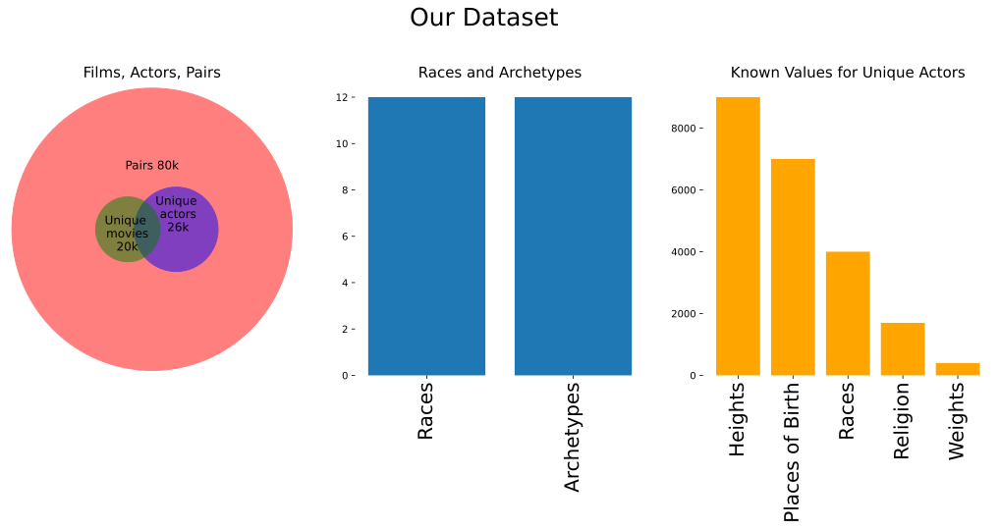

In [6]:
# hidecode

# in this cell I do a desing for the intro of our dataset

coeff = 30_000
circle1 = plt.Circle((0, 0), 87000 / coeff, color="r", alpha=0.5)
circle2 = plt.Circle((0.5, 0.0), 26000 / coeff, color="blue", alpha=0.5)
circle3 = plt.Circle((-0.5, 0.0), 20000 / coeff, color="g", alpha=0.5)

fig, axes = plt.subplots(
    nrows=1, ncols=3
)  # note we must use plt.subplots, not plt.subplot
fig.subplots_adjust(top=0.8)
fig.set_figwidth(18)
fig.set_figheight(6)
fig.suptitle("Our Dataset", fontsize=25)

# add circles
axes[0].set_title("Films, Actors, Pairs", fontsize=15)
axes[0].add_patch(circle1)
axes[0].add_patch(circle2)
axes[0].add_patch(circle3)
axes[0].text(0.0, 1.3, "Pairs 80k", fontsize=12, ha="center", va="center")
axes[0].text(0.5, 0.3, "Unique\n actors\n 26k", fontsize=12, ha="center", va="center")
axes[0].text(
    -0.55, -0.1, "Unique\n movies\n 20k", fontsize=12, ha="center", va="center"
)
axes[0].set_xlim(-3, 3)
axes[0].set_ylim(-3, 3)
axes[0].axis("off")

# add small bar for races and archetypes
axes[1].set_title("Races and Archetypes", fontsize=15)
axes[1].set_xticks([0, 1])
axes[1].set_xticklabels(["Races", "Archetypes"], rotation=90, fontsize=20)
axes[1].bar(x=["Races", "Archetypes"], height=[12, 12])
for spine in axes[1].spines.values():
    spine.set_visible(False)  # Hide the frame

# add small bar for more-less important known values
axes[2].set_title("Known Values for Unique Actors", fontsize=15)
arr2 = ["Heights", "Places of Birth", "Races", "Religion", "Weights"]
axes[2].set_xticks(np.arange(len(arr2)))
axes[2].set_xticklabels(arr2, rotation=90, fontsize=20)
axes[2].bar(height=[9000, 7000, 4000, 1700, 400], x=arr2, color="orange")
for spine in axes[2].spines.values():
    spine.set_visible(False)  # Hide the frame

The dataset consists of:

- 87000+ pairs actor-film
- 165 nationalities known for ~26k unique actors
- 2 genders known for ~26k unique actors
- no/yes education for ~26k unique actors
- 88 religions known for ~1500 unique actors
- 12 races known for 4000 unique actors
- 7000 Places of Birth known for ~25k unique actors
- Professions number known for ~26k unique actors
- 12 Archetypes known for ~26k unique actors
- Dates of birth known for 26k unique actors
- Actor heights known for ~9k unique actors
- Actor weight known for ~400 unique actors

### Data collection
Our primary dataset is the CMU Movie Summary Corpus (CMUD), which contains actor features such as height, age, and Freebase ethnicity ID. However, these features provide limited information about the actors. Additional attributes like weight, race, hairstyle, and eye color are necessary for a more comprehensive analysis. To address this, we decided to enrich the dataset by parsing additional websites and utilizing other datasets.

1. Enriching:

The initial CMUD includes links to movie and actor IDs from Freebase, which is no longer maintained. Fortunately, a Freebase data dump from 2017 is available here, containing all the data Freebase had at that time.

We processed this file to extract information about actors, such as education, number of professions, nationality, weight, religion, and place of birth.

It is also important to include the race of an actor, as it significantly affects their appearance. The initial CMUD only provides Freebase ethnicity IDs, so we reprocessed the Freebase dump to extract ethnicity information. We categorized ethnicities into 12 racial groups (a controversial issue): European, African, Indian, Asian, Pacific Islander, Middle Eastern, Latino, Indigenous/Native American, Arab, Caucasus, Caribbean, and Mixed.

Additionally, we found that the CMUD lacks a substantial number of movie summaries, which are essential for identifying character archetypes. To address this, we parsed data from IMDB and Wikipedia.

2. Archetype analysis:

There is a [paper](https://www.cs.cmu.edu/~dbamman/pubs/pdf/bamman+oconnor+smith.acl13.pdf) which indentifies archetypes in movies using statistical methods. \
We also used some specific statistical methods, which are known as LLMs. It is well known that they can do few-shot tasks with high accuracy.
But to make a few-shot task we need to have a few examples. We decided to create a tiny dataset of 200 samples with movies summaries, characters names, characters archetypes. 



# Question 1. What Are the Most Common Character Archetypes in Movies?

In [112]:
# ignore

PLOTLY_COLORS = [
    "#636EFA",
    "#EF553B",
    "#00CC96",
    "#AB63FA",
    "#FFA15A",
    "#19D3F3",
    "#FF6692",
    "#B6E880",
    "#FF97FF",
    "#FECB52",
    "#c6cafd",
    "#f7a799",
]

### Selection of archetype categories

A common method for analyzing archetypes in related literature involves using the website [TV Tropes](https://tvtropes.org/), which hosts an extensive collection of archetypes curated by TV viewers. However, we found that many archetypes on the website are highly specific and apply to only a limited number of examples (e.g., [A Chat with Satan](https://tvtropes.org/pmwiki/pmwiki.php/Main/AChatWithSatan), [The Drunken Sailor](https://tvtropes.org/pmwiki/pmwiki.php/Main/TheDrunkenSailor), [Mock Millionaire](https://tvtropes.org/pmwiki/pmwiki.php/Main/MockMillionaire)). Such specificity restricts the amount of available data, making correlations less noticeable and their insights less impactful. For our analysis, we aimed to capture a broader perspective. To achieve this, we devised a set of generalized and widely recognized archetypes. As a starting point, we used a [list](https://tvtropes.org/pmwiki/pmwiki.php/Main/ArchetypalCharacter) of archetypal tropes from TV Tropes. Building on this list, we consolidated several archetypes into more general categories, resulting in the following set of archetypes:

#### Devised archetypes

<div style="max-height: 400px; overflow-y: auto; border: 1px solid #cccccc;" class="wide-section">
  <table>
    <thead>
      <tr>
        <th>Archetype</th>
        <th>Description</th>
        <th>Example 1</th>
        <th>Example 2</th>
        <th>Example 3</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>Love Interest / Romantic Partner</td>
        <td>A character involved in a romantic relationship with a main figure, influencing emotional arcs and sometimes motivating heroic action.</td>
        <td>"Rose DeWitt Bukater" in "Titanic"</td>
        <td>"Elizabeth Swann" in "Pirates of the Caribbean"</td>
        <td>"Rachel Dawes" in "Batman Begins"</td>
      </tr>
      <tr>
        <td>Caregiver / Healer</td>
        <td>Provides nurture, comfort, or medical/spiritual healing; supports others’ well-being and stability.</td>
        <td>"Dr. Ellen Ripley" in "Aliens"</td>
        <td>"Samwise Gamgee" in "The Lord of the Rings"</td>
        <td>"Molly Weasley" in "Harry Potter series"</td>
      </tr>
      <tr>
        <td>Mentor / Wise Guide</td>
        <td>Provides knowledge, training, or insight to help the hero or others grow and succeed.</td>
        <td>"Ms. Honey" in "Matilda"</td>
        <td>"Mr. Miyagi" in "The Karate Kid"</td>
        <td>"Obi-Wan Kenobi" in "Star Wars: A New Hope"</td>
      </tr>
      <tr>
        <td>Intellectual / Creative (Scholar/Artist/Inventor)</td>
        <td>Values knowledge, innovation, or art; provides crucial insights, cultural depth, problem-solving, or visionary ideas.</td>
        <td>"Steve Jobs" in "Steve Jobs"</td>
        <td>"Leonardo da Vinci" in "The Da Vinci Code"</td>
        <td>"Ada Lovelace" in "The Imitation Game"</td>
      </tr>
      <tr>
        <td>Ruler / Politician</td>
        <td>Holds formal power or influence; shapes policies, alliances, and social orders, whether for good or ill.</td>
        <td>"President Franklin D. Roosevelt" in "Hyde Park on Hudson"</td>
        <td>"Selina Meyer" in "Veep"</td>
        <td>"Duncan Idaho" in "Dune"</td>
      </tr>
      <tr>
        <td>Sidekick / Loyal Companion</td>
        <td>A supportive ally, assisting the hero, offering loyalty, encouragement, and sometimes comic or emotional relief.</td>
        <td>"Ron Weasley" in "Harry Potter and the Philosopher's Stone"</td>
        <td>"Dr. John Watson" in "Sherlock Holmes: A Game of Shadows"</td>
        <td>"Robin" in "Batman: The Movie"</td>
      </tr>
      <tr>
        <td>Warrior / Vigilante</td>
        <td>Skilled in combat and physical confrontation; may enforce justice or defend others, sometimes outside legal boundaries.</td>
        <td>"Batman" in "The Dark Knight"</td>
        <td>"John Wick" in "John Wick"</td>
        <td>"The Bride" in "Kill Bill"</td>
      </tr>
      <tr>
        <td>Rogue / Trickster / Con Artist</td>
        <td>A cunning, rule-bending manipulator who achieves goals through deception, charm, or clever schemes.</td>
        <td>"Frank Abagnale Jr." in "Catch Me If You Can (2002)"</td>
        <td>"Irving Rosenfeld" in "American Hustle (2013)"</td>
        <td>"Lawrence Jamieson" in "Dirty Rotten Scoundrels (1988)"</td>
      </tr>
      <tr>
        <td>Mystic / Seer</td>
        <td>Offers spiritual guidance, foresight, or mystical understanding, often steering characters with visions or cryptic wisdom.</td>
        <td>"The Oracle" in "The Matrix"</td>
        <td>"Yoda" in "The Empire Strikes Back"</td>
        <td>"Galadriel" in "The Lord of the Rings: The Fellowship of the Ring"</td>
      </tr>
      <tr>
        <td>Outsider / Loner</td>
        <td>Operates on the fringe of society, often misunderstood or self-isolated, bringing a unique perspective.</td>
        <td>"Edward Scissorhands" in "Edward Scissorhands"</td>
        <td>"Rick Deckard" in "Blade Runner"</td>
        <td>"Chuck Noland" in "Cast Away"</td>
      </tr>
      <tr>
        <td>Innocent / Vulnerable</td>
        <td>Naive, inexperienced, or in need of guidance; prompts protection or mentoring, and highlights moral stakes.</td>
        <td>"Daniel LaRusso" in "The Karate Kid"</td>
        <td>"Charlie Bucket" in "Willy Wonka & the Chocolate Factory"</td>
        <td>"Newt" in "Aliens"</td>
      </tr>
      <tr>
        <td>Other</td>
        <td>Doesn't align with any of the proposed archetype categories</td>
        <td>"George McFly" in "Back to the Future"</td>
        <td>"Victor" in "John Wick"</td>
        <td>"Mayor" in "Ghostbusters"</td>
      </tr>
    </tbody>
  </table>
</div>

These categories encompass the majority of characters portrayed on television and have minimal overlap. We decided to classify characters in the dataset into these categories using large language models. The specific task for the model was to select the most appropriate archetype from the list based on the movie summary. To ensure the quality of predictions, we compiled a set of examples for each analyzed archetype. After extensive testing and evaluation of different models with various prompts, we achieved an accuracy of 0.7 on the test set. Further manual analysis of the predictions revealed that 96% of the predictions were appropriate for the characters, even when they differed from the archetypes we had assigned. Using Gemini and GPT models, archetypes were inferred for over 80,000 characters from the CMU dataset. To test the soundness of predictions we can analyse the distribution of the archetypes with relation to the movie genre

In [145]:
# ignore
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

archetype_data = pd.read_csv(
    "../../data/enriched/persona_identification/archetype_predictions_joined.csv"
)

character_data = pd.read_csv("../../data/MovieSummaries/character_processed.csv")

character_data = character_data.rename(
    columns={
        "Wikipedia movie ID": "wikipedia_movie_id",
        "Freebase movie ID": "fb_movie_id",
        "Character name": "character_name",
        "Actor gender": "actor_gender",
        "Actor height (in meters)": "actor_height",
        "Actor ethnicity (Freebase ID)": "fb_actor_eth_id",
        "Actor name": "actor_name",
        "Freebase character/actor map ID": "fb_char_actor_map_id",
        "Freebase character ID": "fb_char_id",
        "Freebase actor ID": "fb_actor_id",
    }
)

character_data = character_data.drop_duplicates(
    subset=["fb_movie_id", "fb_actor_id", "character_name"]
)

actor_data = pd.read_csv("../../data/enriched/actors/actors_freebase.csv")
actor_data = actor_data[
    [
        "education",
        "professions_num",
        "date_of_birth",
        "nationality",
        "gender",
        "place_of_birth",
        "height",
        "weight",
        "religion",
        "id",
    ]
]

merged = pd.merge(
    archetype_data,
    character_data,
    how="inner",
    left_on=["actor_fb_id", "movie_fb_id", "character_name"],
    right_on=["fb_actor_id", "fb_movie_id", "character_name"],
)
merged = pd.merge(
    merged, actor_data, how="left", left_on="actor_fb_id", right_on="id"
).copy()

merged.loc[merged.actor_height.isna() & ~merged.height.isna(), "actor_height"] = merged[
    merged.actor_height.isna() & ~merged.height.isna()
].height
merged.loc[merged.actor_gender.isna() & ~merged.gender.isna(), "actor_gender"] = merged[
    merged.actor_gender.isna() & ~merged.gender.isna()
].gender

data = merged[
    [
        "prediction",
        "character_name",
        "movie_name",
        "actor_gender",
        "actor_height",
        "actor_name",
        "actor_date_of_birth",
        "movie_release_date",
        "ethn_name",
        "race",
        "education",
        "professions_num",
        "nationality",
        "gender",
        "place_of_birth",
        "weight",
        "religion",
        "fb_movie_id",
        "fb_actor_id",
    ]
].copy()
# # delete some ourliers, by looking at the histogram
MIN_HEIGHT = 0.8
MAX_HEIGHT = 2.7  # Max Palmen had height 249 cm
data = data[
    ((data.actor_height >= MIN_HEIGHT) & (data.actor_height <= MAX_HEIGHT))
    | data.actor_height.isna()
].copy()
data["years_in_film"] = (
    pd.to_datetime(data.movie_release_date) - pd.to_datetime(data.actor_date_of_birth)
).dt.days / 365.25
data["actor_bmi"] = data.weight / (data.actor_height**2)
data.loc[~data.education.isna(), "education"] = data.loc[
    ~data.education.isna(), "education"
].astype(int)
data.loc[data.actor_gender == "Male", "actor_gender"] = "M"
data.loc[data.actor_gender == "Female", "actor_gender"] = "F"
data.rename(columns={"prediction": "archetype"}, inplace=True)
data.shape

(87210, 21)

In [146]:
# ignore
from collections import Counter
import json

movie_meta = pd.read_csv("../../data/MovieSummaries/movie_processed.csv")
movie_meta = movie_meta.rename(columns={"Freebase movie ID": "fb_movie_id"})

movie_meta["genres"] = movie_meta["genres"].map(
    lambda x: json.loads(x.replace("'", '"'))
)

genre_counter = Counter()
for genre_list in movie_meta.genres:
    genre_counter.update(genre_list)

In [147]:
# ignore
for i, (genre, count) in enumerate(genre_counter.most_common(15)):
    print(f"{i}.\t{genre} ({count})")

genres = [r[0] for r in genre_counter.most_common(9)]
genres += ["Documentary"]
genres = ["All"] + genres
genres

0.	Drama (36170)
1.	Comedy (21919)
2.	Romance (11131)
3.	Action (10432)
4.	Classic (9464)
5.	Thriller (9345)
6.	Adventure (8975)
7.	Crime (8396)
8.	Short Film (8141)
9.	Global Cinema (7155)
10.	Indie (6897)
11.	Documentary (6761)
12.	Horror (5587)
13.	Music (5467)
14.	Silent (5250)


['All',
 'Drama',
 'Comedy',
 'Romance',
 'Action',
 'Classic',
 'Thriller',
 'Adventure',
 'Crime',
 'Short Film',
 'Documentary']

In [148]:
# hidecode
import plotly.graph_objects as go
import pandas as pd
from itertools import chain

chars_with_movie_meta = pd.merge(data, movie_meta, on="fb_movie_id")
archetypes_list = list(chars_with_movie_meta.archetype.value_counts().keys())

color_map = {arch: color for arch, color in zip(archetypes_list, PLOTLY_COLORS)}


fig = go.Figure()

# Add a pie chart trace for each genre

for genre in genres:
    if genre != "All":
        filtered_by_genre = chars_with_movie_meta[
            chars_with_movie_meta.genres.map(lambda x: genre in x)
        ]
    else:
        filtered_by_genre = chars_with_movie_meta
    pie_data = filtered_by_genre.archetype.value_counts()

    archetypes = list(pie_data.keys())
    colors = [color_map[archetype] for archetype in archetypes]

    fig.add_trace(
        go.Pie(
            labels=archetypes,
            values=pie_data.values,
            name=genre,
            marker=dict(colors=colors),
        )
    )

# Create dropdown menu
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "method": "update",
                    "label": genre,
                    "args": [{"visible": [i == j for i in range(len(genres))]}],
                }
                for j, genre in enumerate(genres)
            ],
            "direction": "down",
            "showactive": True,
            "x": 0.0,
            "xanchor": "left",
            "y": 1.15,
            "yanchor": "top",
        }
    ],
    annotations=[
        {
            "text": "Select Genre:",
            "x": 0,
            "xref": "paper",
            "y": 1.25,
            "yref": "paper",
            "showarrow": False,
            "font": {"size": 14},
        }
    ],
    title="Archetype Distribution by Genre",
    title_x=0.5,
)

# Initially show only the first genre
fig.update_traces(visible=False)
fig.data[0].visible = True

from IPython.display import display, HTML
import io

buffer = io.StringIO()

fig.write_html(buffer, full_html=False, include_plotlyjs="cdn")

html = buffer.getvalue()
display(HTML(html))

# fig.show()

The distribution of archetypes across different genres aligns closely with expectations based on the themes and structures typically associated with each genre. For instance, in Romance movies, the Love Interest archetype is most prominent. Action movies feature a higher proportion of Warriors than other genres. Documentaries frequently feature impactful characters such as Rulers, Mentors, and Intellectuals. Interestingly, short movies include characters that don't fit into any archetype much more often then other genres. Likely this is due to the limited runtime, which doesn't allow characters to show themselves within the boundries of any archetype. 

# Question 2

*Which Actor Traits Correspond to Specific Archetypes?\
Which actor traits — such as age, gender, ethnicity, and other physical attributes — are typically associated with specific archetypes? For instance, are certain traits more frequently linked to roles like heroes, villains, or mentors? Investigating these correlations can reveal patterns in casting decisions.*

In [1]:
# ignore
%load_ext autoreload
%autoreload 2

In [2]:
# ignore
%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [3]:
# ignore
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from IPython import display

pio.renderers.default = "notebook"
plotly.offline.init_notebook_mode(connected=True)

import os
import sys

sys.path.append(os.path.join(os.getcwd(), "../visualization"))
from plot_3d_like import plot_2d_heatmap

In [4]:
# ignore
sys.path.insert(0, "../..")
from src.scripts.load_data import data

data.shape

(87210, 21)

This question shapes our understanding of how features related to specific archetypes, i.e. what are the most probable features for an archetype.

In [5]:
# ignore

actor_traits_numerical_columns = [
    "actor_height",
    "weight",
    "years_in_film",
    "actor_bmi",
]
actor_traits_categorial_columns = [
    "actor_gender",
    "race",
    "education",
    "religion",
    "nationality",
    "place_of_birth",
]

In [6]:
# ignore

# in this cell we calculate the most probable features for each archetype
# (taking into account that distribution of numerical features is gaussian)

# take the most probable value for categorial features
data_categorial = data[actor_traits_categorial_columns + ["archetype"]].copy()
data_categorial = (
    data_categorial.groupby("archetype")
    .agg(lambda x: x.value_counts().index[0])
    .reset_index()
)

# take the mean = most probable value for numerical features
data_numerical = data[actor_traits_numerical_columns + ["archetype"]].copy()
data_numerical = (
    data_numerical.groupby("archetype").agg(lambda x: x.dropna().mean()).reset_index()
)
archetype_features_most_probable = pd.merge(
    data_categorial, data_numerical, on="archetype"
)
archetype_features_most_probable

,archetype,actor_gender,race,education,religion,nationality,place_of_birth,actor_height,weight,years_in_film,actor_bmi
0,Caregiver / Healer,F,European,1,Catholicism,United States of America,New York City,1.700686,65.397276,42.071826,20.974190
1,Innocent / Vulnerable,F,European,0,Catholicism,United States of America,Los Angeles,1.680676,57.836413,24.451378,20.295291
2,Intellectual / Creative (Scholar/Artist/Inventor),M,European,1,Catholicism,United States of America,New York City,1.758763,67.782252,39.353574,21.365027
3,Love Interest / Romantic Partner,F,European,1,Catholicism,United States of America,Mumbai,1.706257,61.322289,31.001326,20.377126
4,Mentor / Wise Guide,M,European,1,Catholicism,United States of America,New York City,1.776903,77.673471,46.709551,23.488200
5,Mystic / Seer,M,European,1,Catholicism,United States of America,New York City,1.742670,70.441211,42.123938,22.175049
6,Other,M,European,0,Catholicism,United States of America,New York City,1.732071,70.536072,39.338174,21.608705
7,Outsider / Loner,M,European,1,Catholicism,United States of America,New York City,1.754119,73.186161,35.076492,22.653687
8,Rogue / Trickster / Con Artist,M,European,1,Catholicism,United States of America,New York City,1.768333,75.793107,39.673057,23.195485
9,Ruler / Politician,M,European,1,Catholicism,United States of America,New York City,1.794513,79.449172,49.752175,23.545650


We found that there are several common traits across most archetypes:

- `Race` is predominantly European, `Religion` is Catholicism, `Nationality` is USA, and `Place of Birth` is New York City. Exceptions include the archetype `Love Interest/Romantic Partner`, where the `Place of Birth` is Mumbai, and `Innocent/Vulnerable`, where it is Los Angeles. This pattern likely reflects the fact that most films are produced in the United States.
- `Gender` is Female only for the archetypes `Innocent/Vulnerable`, `Caregiver/Healer`, and `Love Interest/Romantic Partner`.

The figure below presents the behavior of averaged, scaled values for each archetype on a single plot. Notably, `BMI` and `Weight` exhibit similar trends.
The oldest archetype is `Ruler/Politician`, while the tallest, heaviest, and highest in BMI is `Warrior/Vigilante`.
In contrast, the shortest, youngest, lightest, and lowest in BMI is a single archetype: `Innocent/Vulnerable`.

In [7]:
# hidecode

fig = go.Figure()

for s, title in zip(
    ["actor_height", "weight", "years_in_film", "actor_bmi"],
    ["Height", "Weight", "Years in film", "BMI"],
):
    # scale the values to [0, 1]
    curr_values = data[s].dropna().values.reshape(-1, 1)
    mmax = np.quantile(curr_values, 0.95)
    mmin = np.quantile(curr_values, 0.05)
    scaled = (archetype_features_most_probable[s].values.reshape(-1, 1) - mmin) / (
        mmax - mmin
    )

    # plot them
    fig.add_trace(
        go.Scatter(
            x=archetype_features_most_probable["archetype"],
            y=scaled.flatten().round(2),
            mode="markers+lines",
            name=title,
            hovertemplate=(
                f"<b>{title}</b><br>"
                "Archetype: %{x}<br>"
                "Original Value: %{customdata[0]}<br>"
                "Scaled Value: %{y}<extra></extra>"
            ),
            customdata=archetype_features_most_probable[s]
            .values.reshape(-1, 1)
            .round(2),
        )
    )

fig.update_layout(
    title="Features of Archetypes",
    xaxis_title="Archetype",
    yaxis_title="Scaled Values",
    legend_title="Features",
    height=800,
    width=800,
)

# fig.show()

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

In [8]:
# ignore
# python pages/merger.py src/story/Question_2.ipynb src/story/Question_3.ipynb > pages/merged.ipynb
# python pages/render.py pages/merged.ipynb > pages/index.markdown

# Question 3

*Do Casting Patterns Exhibit Biases Based on Actor Traits?\
Do casting patterns exhibit biases based on actor traits like age, gender, or ethnicity? Are there noticeable trends in how certain demographics are cast in specific roles? Examining these patterns can shed light on potential biases within the casting industry.*

In [1]:
# ignore
%load_ext autoreload
%autoreload 2

In [2]:
# ignore
%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [3]:
# ignore
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

import os
import sys

sys.path.append(os.path.join(os.getcwd(), "../visualization"))
from plot_3d_like import plot_2d_heatmap

In [4]:
# ignore
sys.path.insert(0, "../..")
from src.scripts.load_data import data

data.shape

(87210, 21)

The specific feature value affects archetype, if the probability to play a character with this archetype differs significantly between an actor with fixed feature value and an actor with no fixed value. It means that if \\(P(Archetype)\\) differs significantly from \\(P(Archetype|Feature)\\).\
The heatmap below represents \\(P(Archetype|Feature) - P(Archetype)\\). The blue color is for the negative values, the orange color is for the positive ones, and `NSS` (Not Statistically Significant).

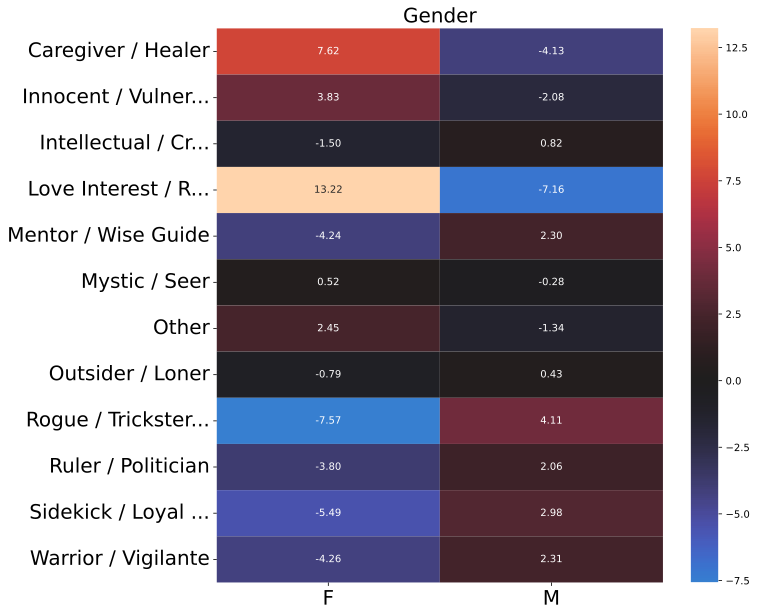

In [5]:
# hidecode

# We wrote a function to plot the 2D heatmap, which is a wrapper around
# the seaborn heatmap function.
# please take a look at the function in the `plot_3d_like.py` file
plt.figure(figsize=(1 * 10, 1 * 10))
for i, (s, title) in enumerate(
    zip(
        ["actor_gender"],
        ["Gender"],
    )
):
    plt.title(title, fontsize=20)
    grid = plot_2d_heatmap(
        data,
        s,
        "archetype",
        normalize="first",
        compare_default_value="subtract",
        percentage=True,
        num_ybins=13,
        mht=True,
        do_not_show_x=["Other"] if title in ["Education", "Gender"] else None,
    )
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

Conditioning on `Gender` reveals a striking pattern: when the probability of playing a specific archetype increases for `Female` actors, it correspondingly decreases for `Male` actors, and vice versa. This asymmetry underscores how men and women are differently positioned within cinematic narratives, highlighting potential biases in how directors and screenwriters envision characters based on gender. The implications are profound, as the film industry not only reflects societal norms but actively shapes them. The figure illustrates this bias vividly, with the most significant differences observed in archetypes such as `Love Interest/Romantic Partner` (Female +13%, Male -7%), `Caregiver / Healer` (Female +7%, Male -4%), `Rogue / Trickster / Con Artist` (Female -7%, Male +4%), and `Sidekick / Local Companion` (Female -5%, Male +3%). Our dataset has films only until 2017, so there is a hope that this situation is different now.

The heatmaps below represent the difference in distributions when conditioning on features closely related to Race: `Race`, `Religion`, `Nationality`, and `Place of Birth`.

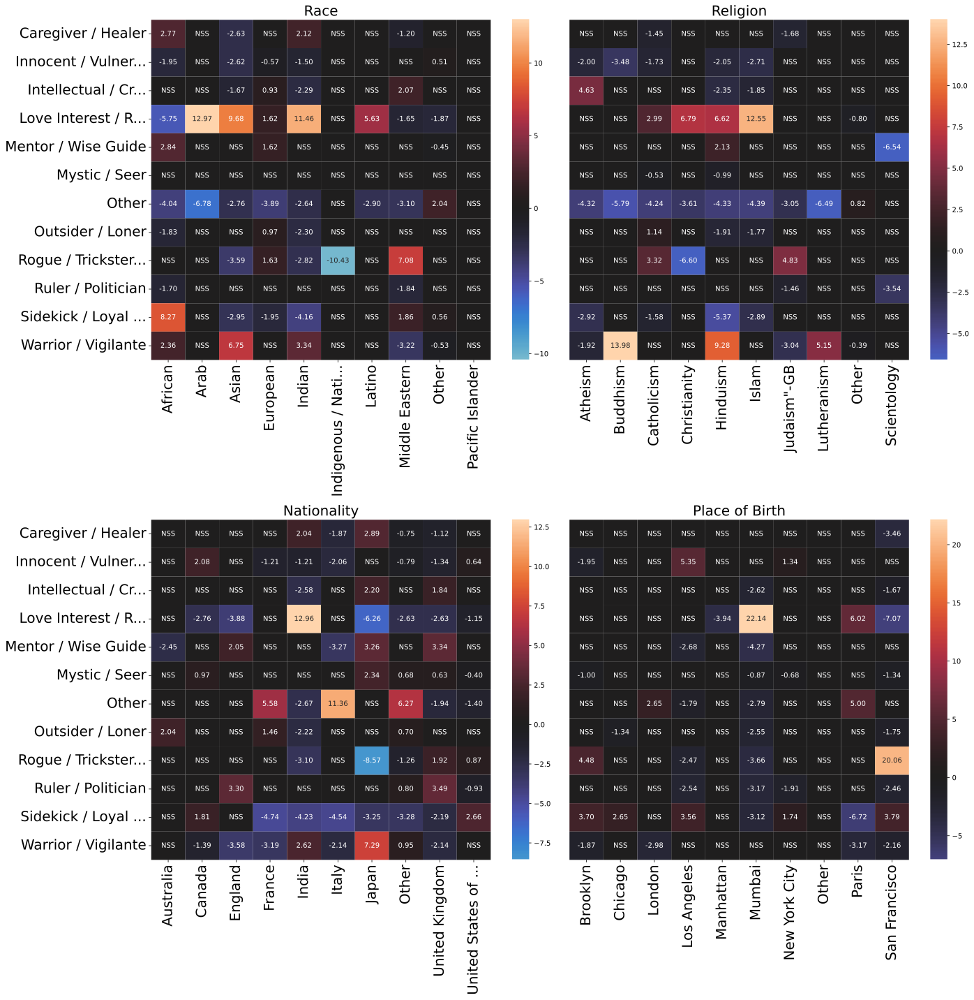

In [6]:
# hidecode

from plot_3d_like import plot_2d_heatmap

plt.figure(figsize=(2 * 10, 2 * 10))
for i, (s, title) in enumerate(
    zip(
        ["race", "religion", "nationality", "place_of_birth"],
        ["Race", "Religion", "Nationality", "Place of Birth"],
    )
):
    plt.subplot(2, 2, i + 1)
    plt.title(title, fontsize=20)
    grid = plot_2d_heatmap(
        data,
        s,
        "archetype",
        normalize="first",
        compare_default_value="subtract",
        percentage=True,
        num_ybins=13,
        mht=True,
    )
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    if not i in [0, 2]:
        plt.yticks([])
plt.tight_layout()

- For `Love Interest / Romantic Partner`, conditioning on these features reveals a significant increase in probability for actors from India and the Middle East. This trend could reflect the influence of Turkish and Bollywood melodramas, which may have reshaped the distribution.

- For `Warrior / Vigilante`, conditioning on the features shows a notable increase in probability for actors from Asia and India. This is particularly intriguing, as the intertwined histories of Asian and Indian cultures, dating back to ancient times, are reflected here. The observation becomes even more compelling as the probabilities for Asian and Indian actors exhibit the same directional trends for almost **all other archetypes**, underscoring a deeper cultural connection.

- Another fascinating finding is that the probability of playing a `Rogue/Trickster/Con Artist` increases by 20% for actors born in San Francisco. This is difficult to understand why this happens, because `Los Angeles` and `San Francisco` are in the same state and this [website](https://www.spolinlaw.com/criminal-defense/most-dangerous-cities-in-california/) says that `Los Angeles` has higher crime rates in 2019. Maybe people from `San Francisco` just look more suspicious.

For the features `Number of Professions` and `Education` one can see that the effect is small, which means that there is no bias towards the number of professions or education of the actor.

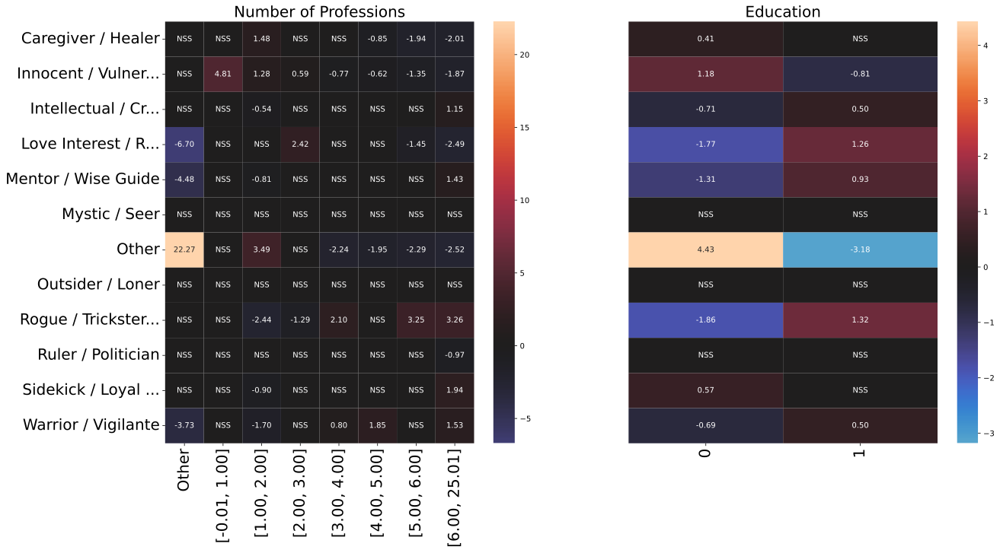

In [7]:
# hidecode

plt.figure(figsize=(2 * 10, 1 * 10))
for i, (s, title) in enumerate(
    zip(
        ["professions_num", "education"],
        ["Number of Professions", "Education"],
    )
):
    plt.subplot(1, 2, i + 1)
    plt.title(title, fontsize=20)
    data.loc[~data.education.isna(), "education"] = data.loc[
        ~data.education.isna(), "education"
    ].astype(str)
    grid = plot_2d_heatmap(
        data,
        s,
        "archetype",
        normalize="first",
        compare_default_value="subtract",
        percentage=True,
        num_ybins=13,
        mht=True,
        do_not_show_x=["Other"] if title in ["Education", "Gender"] else None,
    )
    if not i in [0]:
        plt.yticks([])
    plt.xticks(fontsize=20, rotation=90)
    plt.yticks(fontsize=20)

The figures below represents the values if we condition on numerical values such as `Weight`, `Height`, `Age in Film`, and `BMI`. The bins are sampled such that the **probability** of each bin is uniform, i.e. we \\(\text{bin}_i\\) represents \\([\operatorname{quantile}(\frac{i}{n}), \operatorname{quantile}(\frac{i}{n + 1})]\\). 

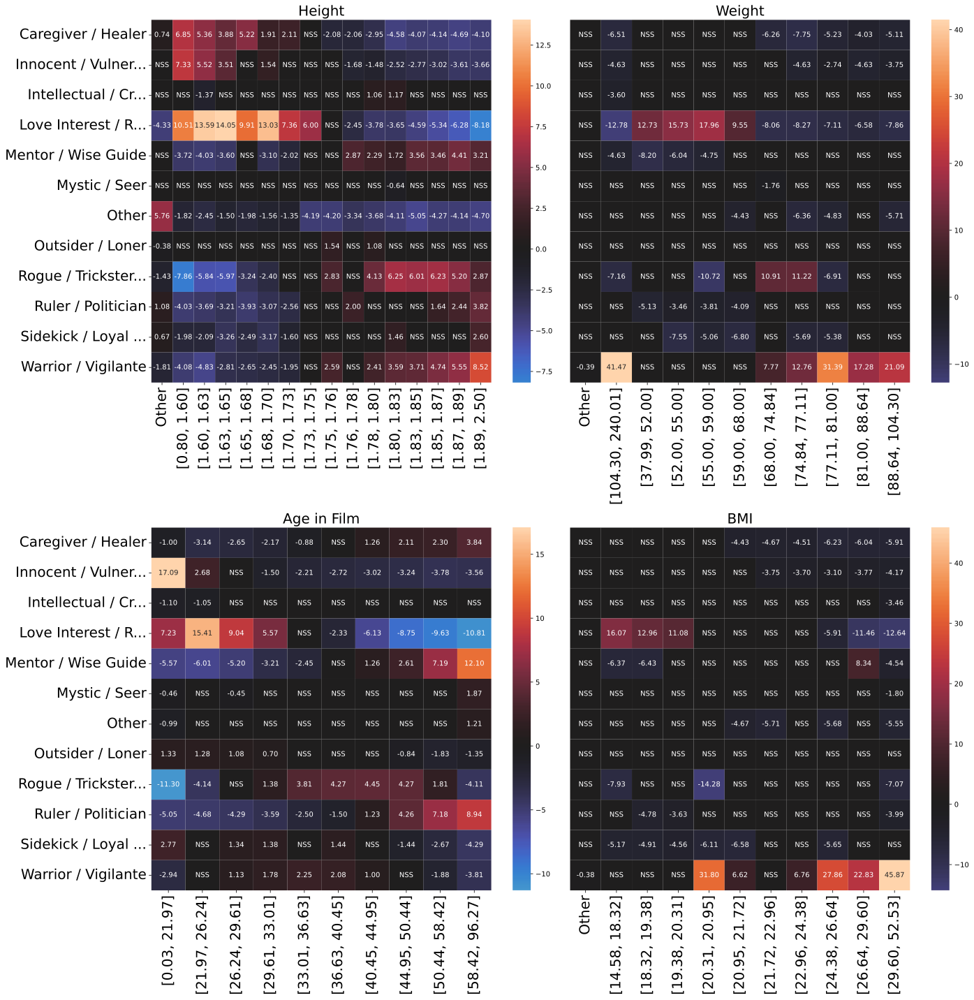

In [8]:
# hidecode

plt.figure(figsize=(2 * 10, 2 * 10))
for i, (s, title) in enumerate(
    zip(
        ["actor_height", "weight", "years_in_film", "actor_bmi"],
        ["Height", "Weight", "Age in Film", "BMI"],
    )
):
    plt.subplot(2, 2, i + 1)

    plt.title(title, fontsize=20)
    grid = plot_2d_heatmap(
        data,
        s,
        "archetype",
        normalize="first",
        compare_default_value="subtract",
        percentage=True,
        num_ybins=13,
        num_xbins=15 if title == "Height" else 10,
        mht=True,
    )
    if not i in [0, 2]:
        plt.yticks([])
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
plt.tight_layout()

*Here, we refer to the difference between probability and conditional probability simply as probability.*

- For `Love Interest/Romantic Partner`, the probability exhibits a consistent pattern across various features: it initially increases monotonically, reaches a peak, and then decreases monotonically. This indicates a clear bias among directors and screenwriters in defining the ideal archetype for this role. Based on the maxima, the "perfect" actor for this archetype would be 1.63m tall, weigh 57kg, and be 24 years old. This suggests a significant disadvantage for older, overweight, or taller actors, highlighting the film industry's limited and unfair representation of love, which can take many forms.

- For `Caregiver/Healer` and `Innocent/Vulnerable`, when conditioned on Height, the probability follows a similar pattern to Love Interest/Romantic Partner, though the peaks differ by about 3cm. An interesting observation is that for Age in Film, the probability increases monotonically for older actors. This trend also applies to archetypes like Mentor/Wise Guide and Ruler/Politician. This is logical, because those roles require a lot of experience, and in usual world elder people tend to have more experience. Or at least they know how to pretend that they have more experience.

- For `Rogue/Trickster/Con` Artist and `Warrior/Vigilante`, the probability increases with both Height and Weight. Notably, the probability of being cast as a `Warrior/Vigilante` jumps by nearly 50% for actors with a BMI of 29 or higher. This reflects the expectation that warriors should have a strong, muscular build 💪💪💪

- Another intriguing finding is that the probability of being cast as a `Ruler/Politician` increases with height. As noted in this [article](https://www.economist.com/graphic-detail/2020/02/19/in-politics-height-matters), U.S. presidents tend to be taller than the average American citizen.

# Question 4. How Do Casting Trends Vary Across Genres and Film Industries?

How do these casting trends vary across different genres and film industries, such as Hollywood compared to Bollywood? Are there differences in how actors are cast for similar archetypes in different cultural or geographic contexts? Comparing casting practices can highlight cultural influences on the film industry. 


In [1]:
# ignore
import pandas as pd
import numpy as np
import json
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn.objects as so
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from collections import Counter
from IPython import display
import matplotlib
import scipy.stats as sps
import matplotlib.patches as mpatches

pio.renderers.default = "notebook"
plotly.offline.init_notebook_mode(connected=True)

font = {"size": 22}
matplotlib.rc("font", **font)

%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [2]:
# ignore


def contains(x):
    if not isinstance(x, list):
        x = [x]
    return lambda i: any(j in i for j in x)

In [3]:
# ignore
actors_data = pd.read_csv(
    "../../data/enriched/actors/actors_freebase.csv", low_memory=False, index_col=0
)
character_data = pd.read_csv(
    "../../data/MovieSummaries/character_processed.csv", low_memory=False, index_col=0
)
archetypes_data = pd.read_csv(
    "../../data/enriched/persona_identification/archetype_predictions_joined.csv",
    low_memory=False,
    index_col=0,
)
movies_data = pd.read_csv(
    "../../data/MovieSummaries/movie_processed.csv", low_memory=False
)

In [4]:
# ignore
actors_data

,education,count_guest_roles,places_lived,spouses,children,professions_num,professions,date_of_birth,nationality,gender,...,discription,id,wiki_en_path,wiki_en_title,wiki_en_page,wiki_en_id,height,religion,weight,freebase_to_wiki_title
0,False,0,0,0,0,1,['Actor'],1970-01-02,Germany,Female,...,Chris Hohenester is a German actress.,/m/0j50vrd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Chris Hohenester
1,False,0,1,0,0,5,"['Screenwriter', 'Comedian""-GB', 'Writer', 'Fi...",1960-02-27,United States of America,Female,...,"Mary Joseph \""Mary Jo\"" Pehl is an American wr...",/m/03xmr6,/wikipedia/en/Mary_Jo_Pehl,Mary_Jo_Pehl,http://en.wikipedia.org/wiki/index.html?curid=...,995072.0,NaN,NaN,NaN,Mary Jo Pehl
2,True,14,1,0,0,5,"['Voice acting""-GB', 'Actor', 'Comedian""-GB', ...",1978-11-23,United Kingdom,Male,...,"Kayvan Novak is a British-Iranian actor, voice...",/m/0gwpbl,/wikipedia/en_id/6912128,Kayvan_Novak,http://en.wikipedia.org/wiki/Kayvan_Novak,6912128.0,1.85,NaN,NaN,Kayvan Novak
3,False,31,0,0,0,1,['Actor'],1912-10-30,England,Male,...,Preston Lockwood was an English actor.\nHe is ...,/m/0ck5l5,/wikipedia/en_id/4724456,Preston_Lockwood,http://en.wikipedia.org/wiki/index.html?curid=...,4724456.0,NaN,NaN,NaN,Preston Lockwood
4,False,0,0,2,0,1,['Actor'],1907-08-09,United States of America,Female,...,Marion Burns was an American film actress of t...,/m/02wbw52,/wikipedia/en_id/12532780,Marion_Burns,http://en.wikipedia.org/wiki/Marion_Burns,12532780.0,1.63,NaN,NaN,Marion Burns
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57571,False,0,1,0,0,1,['Actor'],1996-02-19,United States of America,Male,...,Allen Alvarado is an American teen actor. He p...,/m/0bfwvk,/wikipedia/en/Allen_Alvarado,Allen_Alvarado,http://en.wikipedia.org/wiki/index.html?curid=...,4056707.0,NaN,NaN,NaN,NaN
57572,False,0,0,2,2,1,['Actor'],1919,Greece,Female,...,Ilya Livykou or Ilia Livykou was a Greek actre...,/m/05f3dq5,/wikipedia/en_id/21389123,Ilya_Livykou,http://en.wikipedia.org/wiki/Ilya_Livykou,21389123.0,NaN,NaN,NaN,Ilya Livykou
57573,False,0,0,0,3,3,"['Actor', 'Film director""-GB', 'Screenwriter']",1962-10-25,France,Female,...,"Christine Citti is an actress, film director a...",/m/04p68qc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Christine Citti
57574,False,0,0,0,0,1,['Actor'],1978-12-19,India,Male,...,Hiten Paintal is an actor.,/m/04gl2kv,/wikipedia/en_title/Hiten_Paintal,Hiten_Paintal,http://en.wikipedia.org/wiki/index.html?curid=...,18698581.0,NaN,NaN,NaN,Hiten Paintal


In [5]:
# ignore
archetypes_data

,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model
0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo
1,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'2-Gun' Gertie Baxter,Roxie Hart,/m/026l5ym,/m/049wny,gpt-4o
2,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,gpt-3.5-turbo
3,Warrior / Vigilante,Warrior / Vigilante,'Ace' Cooper,The Dude Bandit,/m/07s5z0d,/m/05ddzx,gpt-3.5-turbo
4,Warrior / Vigilante,Warrior / Vigilante,'Baby Face' Martin,Dead End,/m/0gnrt,/m/03n6r,gpt-4o
...,...,...,...,...,...,...,...
87212,Other,Other,Öregasszony,Cserepek,/m/064qw9w,/m/064n8zg,gpt-4o
87213,Other,Other,Østergaard,The Castle,/m/04q8y_g,/m/04n2_kz,gpt-4o
87214,Sidekick / Loyal Companion,Sidekick / Loyal Companion,Şaban,Hababam Sınıfı Tatilde,/m/0g5rqxx,/m/02lbb_,gpt-4o
87215,Sidekick / Loyal Companion,Sidekick / Loyal Companion,Şaban,Hababam sinifi,/m/02q9v9h,/m/02lbb_,gpt-3.5-turbo


In [6]:
# ignore
movies_data

,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres
0,975900,/m/03vyhn,Ghosts of Mars,14010832.0,98.0,['english'],2001-08-24,['United States of America'],['United States of America'],"['Adventure', 'Horror', 'Action', 'Thriller', ..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,NaN,95.0,['english'],2000-02-16,['United States of America'],['United States of America'],"['Crime', 'Drama', 'Mystery', 'Biography']"
2,28463795,/m/0crgdbh,Brun bitter,NaN,83.0,['norwegian'],1988-01-01,['Norway'],['Norway'],"['Crime', 'Drama']"
3,9363483,/m/0285_cd,White Of The Eye,NaN,110.0,['english'],1987-01-01,['United Kingdom'],['United Kingdom'],"['Erotic', 'Thriller']"
4,261236,/m/01mrr1,A Woman in Flames,NaN,106.0,['german'],1983-01-01,['Germany'],['Germany'],['Drama']
...,...,...,...,...,...,...,...,...,...,...
81736,35228177,/m/0j7hxnt,Mermaids: The Body Found,NaN,120.0,['english'],2011-03-19,['United States of America'],['United States of America'],['Drama']
81737,34980460,/m/0g4pl34,Knuckle,NaN,96.0,['english'],2011-01-21,"['Ireland', 'United Kingdom']","['Ireland', 'United Kingdom']","['Documentary', 'Drama', 'Biography']"
81738,9971909,/m/02pygw1,Another Nice Mess,NaN,66.0,['english'],1972-09-22,['United States of America'],['United States of America'],"['Comedy', 'Satire']"
81739,913762,/m/03pcrp,The Super Dimension Fortress Macross II: Lover...,NaN,150.0,['japanese'],1992-05-21,['Japan'],['Japan'],"['Drama', 'Adventure', 'Short Film', 'Cartoon'..."


In [7]:
# ignore
character_data

,Freebase movie ID,Character name,Actor gender,Actor height (in meters),Actor ethnicity (Freebase ID),Actor name,Freebase character/actor map ID,Freebase character ID,Freebase actor ID,actor_date_of_birth,movie_release_date,ethn_name,race
Wikipedia movie ID,,,,,,,,,,,,,
975900,/m/03vyhn,Akooshay,F,1.620,NaN,Wanda De Jesus,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,1958-08-26,2001-08-24,NaN,NaN
975900,/m/03vyhn,Lieutenant Melanie Ballard,F,1.780,/m/044038p,Natasha Henstridge,/m/0jys3m,/m/0bgchn4,/m/0346l4,1974-08-15,2001-08-24,NaN,NaN
975900,/m/03vyhn,Desolation Williams,M,1.727,/m/0x67,Ice Cube,/m/0jys3g,/m/0bgchn_,/m/01vw26l,1969-06-15,2001-08-24,African American,African
975900,/m/03vyhn,Sgt Jericho Butler,M,1.750,NaN,Jason Statham,/m/02vchl6,/m/0bgchnq,/m/034hyc,1967-09-12,2001-08-24,NaN,NaN
975900,/m/03vyhn,Bashira Kincaid,F,1.650,NaN,Clea DuVall,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,1977-09-25,2001-08-24,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
913762,/m/03pcrp,UN Spacy Commander,M,NaN,NaN,Sonny Byrkett,/m/0kr407w,/m/0kr407_,/m/0gn4bz,1954-01-01,1992-05-21,NaN,NaN
913762,/m/03pcrp,Silvie Gena,F,NaN,NaN,Susan Byrkett,/m/0kr40b9,/m/0kr40bf,/m/0gn4nd,1958-01-01,1992-05-21,NaN,NaN
913762,/m/03pcrp,Elensh,F,NaN,NaN,Dorothy Elias-Fahn,/m/0kr406c,/m/0kr406h,/m/0b_vcv,1970-05-01,1992-05-21,NaN,NaN


In [8]:
# ignore
actors_data = pd.merge(
    actors_data,
    character_data[
        ["Freebase actor ID", "ethn_name", "race", "actor_date_of_birth", "Actor name"]
    ].drop_duplicates(),
    left_on=["id"],
    right_on=["Freebase actor ID"],
    how="left",
)
characters_data = pd.merge(
    archetypes_data[
        ["prediction", "character_name", "movie_name", "movie_fb_id", "actor_fb_id"]
    ].rename(dict(prediction="archetype"), axis=1),
    actors_data,
    how="inner",
    left_on=["actor_fb_id"],
    right_on=["id"],
)
characters_data

,archetype,character_name,movie_name,movie_fb_id,actor_fb_id,education,count_guest_roles,places_lived,spouses,children,...,wiki_en_id,height,religion,weight,freebase_to_wiki_title,Freebase actor ID,ethn_name,race,actor_date_of_birth,Actor name
0,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,False,0,0,1,0,...,4538715.0,1.540,NaN,NaN,Mieko Harada,/m/0c7tjc,NaN,NaN,1958-12-26,Mieko Harada
1,Rogue / Trickster / Con Artist,'2-Gun' Gertie Baxter,Roxie Hart,/m/026l5ym,/m/049wny,False,14,0,3,0,...,1141212.0,1.630,NaN,NaN,Iris Adrian,/m/049wny,NaN,NaN,1912-05-29,Iris Adrian
2,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,False,22,0,5,0,...,64612.0,1.638,Christian Science,NaN,Ginger Rogers,/m/0h7dd,NaN,NaN,1911-07-16,Ginger Rogers
3,Warrior / Vigilante,'Ace' Cooper,The Dude Bandit,/m/07s5z0d,/m/05ddzx,False,0,1,4,1,...,1585014.0,1.750,NaN,NaN,Hoot Gibson,/m/05ddzx,NaN,NaN,1892-08-06,Hoot Gibson
4,Warrior / Vigilante,'Baby Face' Martin,Dead End,/m/0gnrt,/m/03n6r,True,7,3,4,2,...,14045.0,1.740,Episcopal Church,NaN,Humphrey Bogart,/m/03n6r,Dutch,European,1899-12-25,Humphrey Bogart
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86939,Other,Öregasszony,Cserepek,/m/064qw9w,/m/064n8zg,False,0,0,1,0,...,23023729.0,NaN,NaN,NaN,Irma Patkós,/m/064n8zg,NaN,NaN,1900-03-08,Irma Patkós
86940,Other,Østergaard,The Castle,/m/04q8y_g,/m/04n2_kz,False,0,0,0,0,...,19637850.0,NaN,NaN,NaN,Bent Vejlby,/m/04n2_kz,NaN,NaN,1924-03-20,Bent Vejlby
86941,Sidekick / Loyal Companion,Şaban,Hababam Sınıfı Tatilde,/m/0g5rqxx,/m/02lbb_,True,0,1,1,2,...,523675.0,NaN,NaN,NaN,Kemal Sunal,/m/02lbb_,NaN,NaN,1944-11-11,Kemal Sunal
86942,Sidekick / Loyal Companion,Şaban,Hababam sinifi,/m/02q9v9h,/m/02lbb_,True,0,1,1,2,...,523675.0,NaN,NaN,NaN,Kemal Sunal,/m/02lbb_,NaN,NaN,1944-11-11,Kemal Sunal


In [9]:
# ignore
def load_list(x):
    if not isinstance(x, str):
        return None
    return list(json.loads(x.replace("'", '"')))


df = pd.merge(
    characters_data,
    movies_data,
    how="inner",
    left_on=["movie_fb_id"],
    right_on=["Freebase movie ID"],
)
df["countries"] = df["countries"].map(load_list)
df["genres"] = df["genres"].map(load_list)
df

,archetype,character_name,movie_name,movie_fb_id,actor_fb_id,education,count_guest_roles,places_lived,spouses,children,...,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres
0,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,False,0,0,1,0,...,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['France', 'United Kingdom', 'Belgium', 'Unite...","[France, United Kingdom, Belgium, United State...","[Japanese Cinema, Drama, Biography]"
1,Rogue / Trickster / Con Artist,'2-Gun' Gertie Baxter,Roxie Hart,/m/026l5ym,/m/049wny,False,14,0,3,0,...,7950950,/m/026l5ym,Roxie Hart,NaN,75.0,['english'],1942-02-20,['United States of America'],[United States of America],"[Comedy, Classic, Satire, Crime, Drama]"
2,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,False,22,0,5,0,...,33509255,/m/05nszz2,The Groom Wore Spurs,NaN,80.0,['english'],1951-01-01,['United States of America'],[United States of America],"[Comedy, Romance]"
3,Warrior / Vigilante,'Ace' Cooper,The Dude Bandit,/m/07s5z0d,/m/05ddzx,False,0,1,4,1,...,24400406,/m/07s5z0d,The Dude Bandit,NaN,62.0,['english'],1933-04-06,['United States of America'],[United States of America],"[Action, Adventure, Western]"
4,Warrior / Vigilante,'Baby Face' Martin,Dead End,/m/0gnrt,/m/03n6r,True,7,3,4,2,...,61525,/m/0gnrt,Dead End,NaN,93.0,['english'],1937-01-01,['United States of America'],[United States of America],"[Crime, Drama, Classic]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86939,Other,Öregasszony,Cserepek,/m/064qw9w,/m/064n8zg,False,0,0,1,0,...,23023687,/m/064qw9w,Cserepek,NaN,91.0,['hungarian'],1981-05-01,['Hungary'],[Hungary],[Drama]
86940,Other,Østergaard,The Castle,/m/04q8y_g,/m/04n2_kz,False,0,0,0,0,...,19802726,/m/04q8y_g,The Castle,NaN,82.0,['danish'],1964-07-03,['Denmark'],[Denmark],[Family]
86941,Sidekick / Loyal Companion,Şaban,Hababam Sınıfı Tatilde,/m/0g5rqxx,/m/02lbb_,True,0,1,1,2,...,30353952,/m/0g5rqxx,Hababam Sınıfı Tatilde,NaN,90.0,[],1977-01-01,['Turkey'],[Turkey],[Comedy]
86942,Sidekick / Loyal Companion,Şaban,Hababam sinifi,/m/02q9v9h,/m/02lbb_,True,0,1,1,2,...,10376295,/m/02q9v9h,Hababam sinifi,NaN,87.0,['turkish'],1975-04-01,['Turkey'],[Turkey],[Comedy]


In [10]:
# ignore

all_countries = list()
for i, row in df.iterrows():
    if not isinstance(row.countries, list):
        continue
    all_countries += list(row.countries)

In [11]:
# hidecode
def histplot_limited(
    data, x_label="x_label", title="title", fig_kwargs=None, portion=0.005
):
    fig_kwargs = fig_kwargs or {}
    counter = Counter(data)

    # Calculate the threshold for the least prevalent 10%
    total_count = sum(counter.values())
    threshold = total_count * 0.005

    other_count = 0
    filtered_counts = {}
    for string, count in counter.items():
        if count < threshold:
            other_count += count
        else:
            filtered_counts[string] = count

    # Plotting
    labels, values = zip(*filtered_counts.items())
    labels = sorted(labels, key=lambda x: filtered_counts[x], reverse=True)
    values = sorted(values, reverse=True)

    labels += ["Other"]
    values += [other_count]

    fig = px.bar(
        x=labels,
        y=values,
        labels={
            "x": x_label,
            "y": "count",
        },
        text_auto=True,
        title=title,
        height=400,
        **fig_kwargs
    )

    return fig

In [12]:
# hidecode
fig = histplot_limited(
    all_countries, x_label="country", title="Movie country distribution"
)

fig.update_layout(font_size=18)

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

So, there are several large movie producing countries. We can compare just them. One of the most polar comparisons is USA vs India vs Japan. Let's see general archetypes distributions for them at first

In [13]:
# ignore
interesting_countries = [
    "United States of America",
    "India",
    "Japan",
    "United Kingdom",
]
filtered = df[df.countries.map(lambda x: len(x) > 0)].copy().explode("countries")
filtered["country"] = filtered.countries
filtered = filtered[filtered.country.isin(interesting_countries)].copy()[
    ["country", "archetype"]
]

fig = px.histogram(
    filtered,
    x="archetype",
    barmode="group",
    histnorm="probability density",
    height=500,
    title="Distribution of archetypes",
    text_auto=True,
)
fig = fig.update_xaxes(categoryorder="total descending")

fig.update_layout(
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1,
    )
)
fig.update_layout(font_size=18)

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

In [14]:
# hidecode
fig = px.histogram(
    filtered,
    x="archetype",
    color="country",
    barmode="group",
    histnorm="percent",
    height=500,
    title="Distribution of archetypes by country",
    text_auto=True,
)
fig = fig.update_xaxes(categoryorder="total descending")

fig.update_layout(
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)
fig.update_layout(font_size=18)
display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

Some of the most popular archetypes are Trickster, Romantic Partner, Mentor, and Caregiver. Let's analyze them one by one.

## How trickster image is different across cultures?

At first, let's look at gender: 

In [15]:
# hidecode
archetype = "Rogue / Trickster / Con Artist"
df_filtered = df[(df.archetype == archetype)].explode("countries")
df_filtered = df_filtered[df_filtered.countries.isin(interesting_countries)]
df_filtered["country"] = df_filtered.countries

fig = go.Figure()
for country in df_filtered.country.unique()[:10]:
    fig.add_trace(
        go.Histogram(
            x=df_filtered[df_filtered.country == country].gender,
            histnorm="percent",
            name=country,
            texttemplate="%{y:.2f}%",
        ),
    )
fig = fig.update_xaxes(categoryorder="total descending")

fig.update_layout(
    title=f'Distribution of gender in "{archetype}" by country',
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
)
fig.update_layout(font_size=18)

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

Seems like there's no significant differnece between countries. Though, Japan has a bit higher portion of female con artists.

Let's look at the height differences. As mean height is different in every country, we will subtract mean height by country of movie. This way, we will compare "higher than mean" or "lower than mean" 

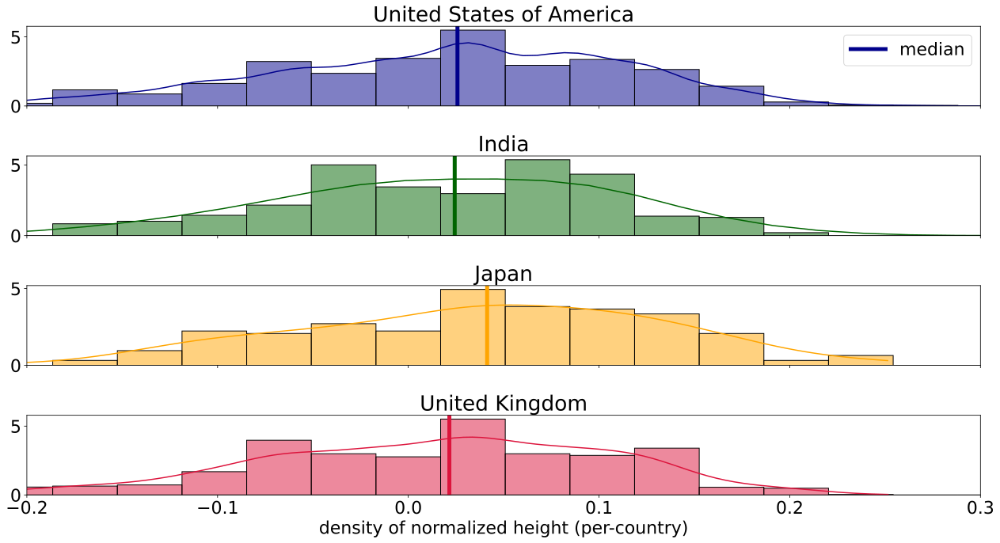

In [16]:
# hidecode
archetype = "Rogue / Trickster / Con Artist"
df_filtered = df.explode("countries").rename(dict(countries="country"), axis=1)
df_filtered = df_filtered[df_filtered.country.isin(interesting_countries)]
mean_heights = df_filtered.groupby("country").height.mean()

filtered = df_filtered[
    (~df_filtered.height.isna()) & (df_filtered.archetype == archetype)
].copy()
filtered["height_normalized"] = filtered.apply(
    lambda x: x["height"] - mean_heights[x.country], axis=1
)

colors = ["darkblue", "darkgreen", "orange", "crimson", "gray"]

fig, ax = plt.subplots(len(interesting_countries), figsize=(18, 10), sharex=True)
for i, (country, color) in enumerate(zip(interesting_countries, colors)):
    sns.histplot(
        filtered[filtered.country == country],
        x="height_normalized",
        bins=np.linspace(-1, 1, 60),
        ax=ax[i],
        stat="density",
        color=color,
        kde=True,
    )
    ax[i].set_xlim((-0.2, 0.3))
    ax[i].axvline(
        np.median(filtered[filtered.country == country].height_normalized),
        label="median",
        linewidth=5,
        color=color,
    )
    ax[i].set_title(country)
    ax[i].set_ylabel("")

ax[0].legend(loc="upper right")

plt.xlabel("density of normalized height (per-country)")
plt.tight_layout()

That's an interesting finding! While in all countries Tricksters are higher than the average actor of the corresponding country, in Japan this finding is the more noticeable. So, we can concludee that **in Japan movies Trickster charecters are higher than average actor by the magnitude biger than in India or USA**.

The difference between USA and India is not statistically significant. As well as the difference between Russia and USA.

In [17]:
stat = sps.ttest_ind(
    filtered[filtered.country == "United States of America"].height_normalized,
    filtered[filtered.country == "Japan"].height_normalized,
)
print(f"USA vs Japan statistic = {stat.statistic:.3f}, pvalue = {stat.pvalue:.4f}")
stat = sps.ttest_ind(
    filtered[filtered.country == "United States of America"].height_normalized,
    filtered[filtered.country == "India"].height_normalized,
)
print(f"USA vs India statistic = {stat.statistic:.3f}, pvalue = {stat.pvalue:.4f}")

USA vs Japan statistic = -2.789, pvalue = 0.0053
USA vs India statistic = -1.914, pvalue = 0.0556


The prominence of taller actors playing trickster roles in Japan may be linked to cultural associations between height and status. In Japanese culture, height often symbolizes superiority, authority, or being "above" others, which denotes both physical tallness and higher stature in terms of value or rank. Tricksters in Japanese folklore, such as the Tengu or Kitsune, are often depicted as figures of power and cunning, blending mischief with a commanding presence. Height could amplify this perception of dominance and charisma, making taller actors more fitting for these roles. Additionally, societal admiration for height as "cool" may further elevate the appeal of such portrayals. This contrasts with other cultures where tricksters are less tied to physical stature and more associated with wit or humor alone

In [18]:
# hidecode
def histplot_limited(
    data, x_label="x_label", title="title", fig_kwargs=None, portion=0.005, ax=None
):
    fig_kwargs = fig_kwargs or {}

    # Calculate the threshold for the least prevalent 10%
    total_count = sum(data.values())
    threshold = total_count * portion

    other_count = 0
    filtered_counts = {}
    for string, count in data.items():
        if count < threshold:
            other_count += count
        else:
            filtered_counts[string] = count / total_count

    # Plotting
    labels, values = zip(*filtered_counts.items())
    labels = sorted(labels, key=lambda x: filtered_counts[x], reverse=True)
    values = sorted(values, reverse=True)

    if other_count > 0:
        labels += ["Other"]
        values += [other_count / total_count]

    sns.barplot(x=labels, y=values, ax=ax, **fig_kwargs)

Are there any interesting differences in race?

Yes!

Again, to address different distributions of races in every country's actors, we will compute portion of tricksters for every race normalized by total actors race presence in country's movies. 

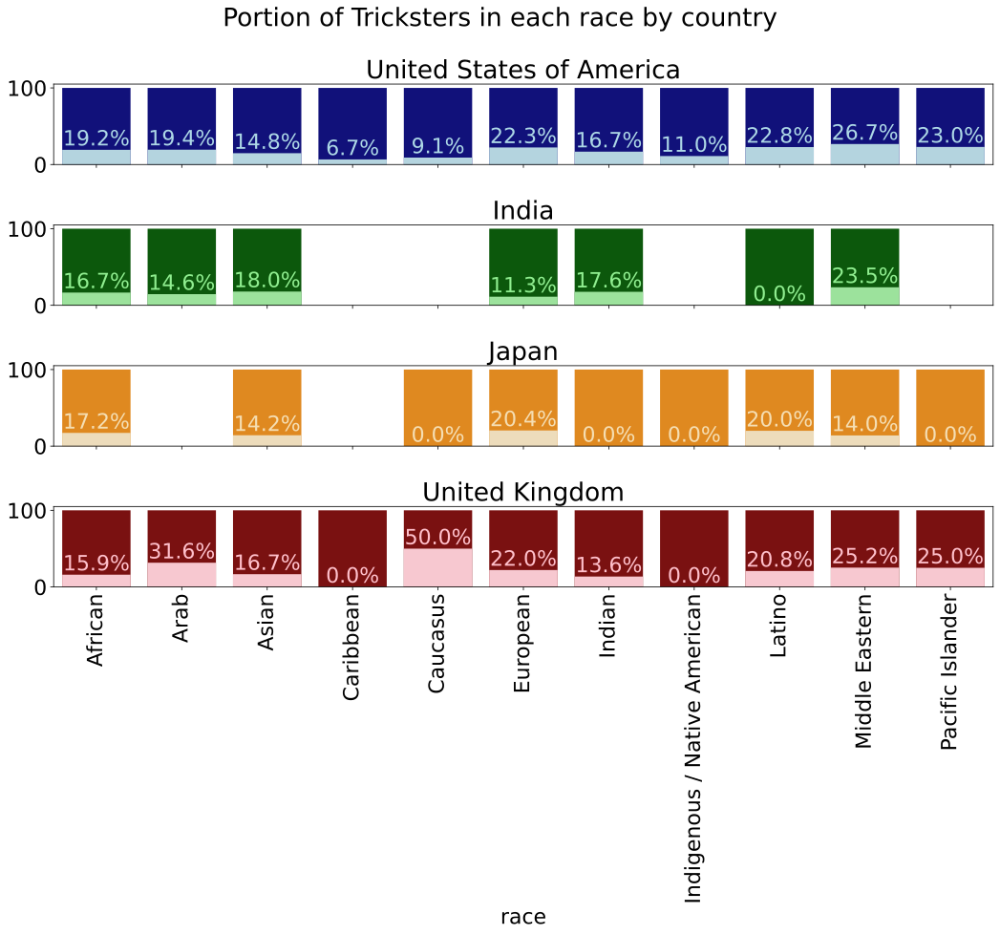

In [19]:
# hidecode
colors = [
    ("darkblue", "lightblue"),
    ("darkgreen", "lightgreen"),
    ("darkorange", "wheat"),
    ("darkred", "pink"),
    ("darkgray", "lightgray"),
]
archetype = "Rogue / Trickster / Con Artist"

fig, axes = plt.subplots(len(interesting_countries), 1, figsize=(15, 14), sharex=True)

df_filtered = df.explode("countries").rename(dict(countries="country"), axis=1)
df_filtered = df_filtered[df_filtered.country.isin(interesting_countries)]

for ax, country, (color_d, color_l) in zip(axes, interesting_countries, colors):
    filtered = df_filtered[
        (~df_filtered.race.isna()) & (df_filtered.country == country)
    ].copy()

    total = filtered.groupby("race")["archetype"].count()
    con = filtered[filtered.archetype == archetype].groupby("race")["archetype"].count()

    total.drop("Mixed", inplace=True, errors="ignore")
    con.drop("Mixed", inplace=True, errors="ignore")

    con = con / total * 100
    con.fillna(0, inplace=True)
    total[:] = 100

    bar1 = sns.barplot(
        x="race", y="archetype", data=total.reset_index(), color=color_d, ax=ax
    )
    bar2 = sns.barplot(
        x="race",
        y="archetype",
        data=con.reset_index(),
        color=color_l,
        ax=ax,
    )
    bar2.bar_label(
        bar2.containers[1],
        labels=con.map(lambda x: f"{x:.1f}%"),
        label_type="edge",
        padding=0,
        color=color_l,
    )

    # add legend
    top_bar = mpatches.Patch(color=color_d, label="non-trickster")
    bottom_bar = mpatches.Patch(color=color_l, label="trickster")
    ax.tick_params(axis="x", labelrotation=90)
    ax.tick_params(axis="y", labelrotation=0)
    ax.set_ylabel("")
    ax.set_title(country)

plt.suptitle("Portion of Tricksters in each race by country")
plt.tight_layout()

Interesting observation is not what present, but what is not here. In Japan there were no entries of Caucasus, Indian, Native American, and Pacific Islander. Interesting how there were no Latino entries for India.

Also, UK is very different by casting Arab and Caucasus as tricksters relatively more frequently than in other countries

Let's analyze a different archetype.

## How "Love Interest / Romantic Partner" vary?

In [20]:
# hidecode
archetype = "Love Interest / Romantic Partner"
df_filtered = df[(df.archetype == archetype) & (~df.gender.isna())].explode("countries")
df_filtered = df_filtered[df_filtered.countries.isin(interesting_countries)]
df_filtered["country"] = df_filtered.countries

fig = px.histogram(
    df_filtered,
    x="gender",
    color="country",
    barmode="group",
    histnorm="probability density",
    height=400,
    title=f'Distribution of gender in "{archetype}" by country',
    text_auto=True,
)
fig = fig.update_xaxes(categoryorder="total descending")

fig.update_layout(
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)
fig.update_layout(font_size=18)

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

In [21]:
df_filtered["male_indicator"] = (df_filtered.gender == "Male").map(int)
mean_by_country = df[(~df.gender.isna())].explode("countries").copy()
mean_by_country["male_indicator"] = (mean_by_country.gender == "Male").map(int)
mean_by_country = mean_by_country.groupby("countries").male_indicator.mean()

stat = sps.ttest_ind(
    df_filtered[df_filtered.country == "United States of America"].male_indicator
    - mean_by_country["United States of America"],
    df_filtered[df_filtered.country == "India"].male_indicator
    - mean_by_country["India"],
)
print(f"USA vs India statistic = {stat.statistic:.3f}, pvalue = {stat.pvalue:.4f}")
stat = sps.ttest_ind(
    df_filtered[df_filtered.country == "United States of America"].male_indicator
    - mean_by_country["United States of America"],
    df_filtered[df_filtered.country == "Japan"].male_indicator
    - mean_by_country["Japan"],
)
print(f"USA vs Japan statistic = {stat.statistic:.3f}, pvalue = {stat.pvalue:.4f}")

USA vs India statistic = -6.816, pvalue = 0.0000
USA vs Japan statistic = -1.322, pvalue = 0.1861


Here, females prevail, and India has higher portion of males statistically significantly, the conducted ttest accounted for the base distribution of male / female in the country. That's quite a funny fact.

## General Observations

Now, let's move on from cherry-picks to general observations

In [22]:
# ignore
def draw_3d_rectangle(min_corner, max_corner, color="blue", opacity=0.5):
    # Unpack the corners
    x_min, y_min, z_min = min_corner
    x_max, y_max, z_max = max_corner

    # Define the vertices of the rectangular prism
    x = [x_min, x_max, x_max, x_min, x_min, x_max, x_max, x_min]
    y = [y_min, y_min, y_max, y_max, y_min, y_min, y_max, y_max]
    z = [z_min, z_min, z_min, z_min, z_max, z_max, z_max, z_max]

    # Define the faces using vertex indices
    triangles = [
        [0, 1, 3],
        [1, 2, 3],  # Bottom
        [4, 5, 7],
        [5, 6, 7],  # Top
        [0, 1, 4],
        [1, 5, 4],  # Front
        [1, 2, 5],
        [2, 6, 5],  # Right
        [2, 3, 6],
        [3, 7, 6],  # Back
        [3, 0, 7],
        [0, 4, 7],  # Left
    ]
    i = [el[0] for el in triangles]
    j = [el[1] for el in triangles]
    k = [el[2] for el in triangles]

    # Create the Mesh3d object
    return go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, color=color, opacity=opacity)


def normalize_1d(arr):
    return arr / (arr.sum() + 1e-7)


def find_percentiles(data, col, num_bins):
    """
    When data is continuous, we need to discretize it into bins.
    """
    # calculate the percentiles
    data_no_nan = data[[col]].dropna()
    percentiles = np.quantile(
        data_no_nan[col], [i / num_bins for i in range(num_bins + 1)]
    )
    # adjust them a little bit
    percentiles[0] -= 0.01
    percentiles[-1] += 0.01
    # discretize the data
    data_no_nan[col + "_bin"] = np.digitize(data_no_nan[col], percentiles)
    col = col + "_bin"
    # change the ticks name
    ticks_name = [
        f"[{percentiles[i - 1]:.2f}, {percentiles[i]:.2f}]"
        for i in range(1, len(percentiles))
    ]
    data_no_nan[col] = data_no_nan[col].apply(lambda x: ticks_name[x - 1])

    # merge the data back, and rename nans
    if sum(data[col].isna()) > 0:
        ticks_name = ticks_name + ["nan"]
    data.loc[~data[col].isna(), col] = data_no_nan[col]
    data[col].fillna("Other", inplace=True)

    return col, data_no_nan


def remove_nans(data, col):
    data.loc[data[col].isna(), col] = "Other"
    return col, data


def ttest_bernoulli_ind(theta1, theta2, num1, num2, mht=False, alpha=0.05):
    """
    theta1: shape (n1, n2) probabilities
    theta2: shape (n1, n2) probabilities
    num1: shape (n1, n2) of numbers of samples for the first group
    num2: shape (n1, n2) of numbers of samples for the second group
    """

    std = np.sqrt(theta1 * (1 - theta1) / num1 + theta2 * (1 - theta2) / num2)
    ZZZ_score = (theta1 - theta2) / std
    p_value = 2 * sps.norm.sf(np.absolute(ZZZ_score))
    if mht:
        p_value = np.minimum(1.0, p_value * num1.size)
    return p_value <= alpha


def add_column_other(data, col, num_bins):
    """
    When the number of columns is too high then we need to drop some values
    and write them as "Other"
    """
    # calculate the appearance of each value and sort by decreasing order
    vc = data[col].value_counts().reset_index().sort_values(by="count", ascending=False)
    # take top and bottom values
    top_num = set(vc[col].values[:num_bins])
    bottom_num = set(vc[col].values[num_bins:])
    # create a function that will rename the values
    # it might be faster to use a the first or the second
    if len(top_num) < len(bottom_num):
        rename_to_other = lambda x: x if x in top_num else "Other"
    else:
        rename_to_other = lambda x: x if not x in bottom_num else "Other"
    # rename the values
    data[col + "_other"] = data[col].apply(rename_to_other)
    col = col + "_other"
    return col, data


def calculate_ticks_and_norm(
    data,
    xcol,
    ycol,
    num_xbins=10,
    num_ybins=10,
    normalize="first",
    compare_default_value="none",
    alpha=0.05,
    mht=False,
):
    """

    parameters:
    - xcol: str
        which column would be on x axis
    - ycol: str
        which column would be on y axis
    - num_xbins: int=10
        number of bins for x axis
    - num_ybins: int=10
        number of bins for y axis
    - normalize: "first" | "second" | "both" | "none"="first",
        how to normalize the data
    - compare_default_value: "none" | "divide" | "subtract" = "none
        We want to look at how "abnormal" the data is if we look at the distribution with the fixed ycol or xcol
        If True, then we will normalize the data by the sum of the non-normalized column
    """
    # drop the rows with missing values
    data_part = data[[xcol, ycol]].copy()

    # if the data is not categorical, then we need to discretize it
    if data_part[xcol].dtype != "object":
        xcol, data_part = find_percentiles(data_part, xcol, num_xbins)
    else:
        xcol, data_part = remove_nans(data_part, xcol)

    if data_part[ycol].dtype != "object":
        ycol, data_part = find_percentiles(data_part, ycol, num_ybins)
    else:
        ycol, data_part = remove_nans(data_part, ycol)

    # if the number of unique values is too high, then we need to drop some of them
    if len(data_part[xcol].unique()) > num_xbins + 1:
        xcol, data_part = add_column_other(data_part, xcol, num_xbins)
    if len(data_part[ycol].unique()) > num_ybins + 1:
        ycol, data_part = add_column_other(data_part, ycol, num_ybins)

    xticks_name = data_part[xcol].unique()
    yticks_name = data_part[ycol].unique()

    # calculate the appearance of each bin
    occurences = data_part[[xcol, ycol]].value_counts().reset_index(name="cnt")
    label2index_x = {label: i for i, label in enumerate(data_part[xcol].unique())}
    label2index_y = {label: i for i, label in enumerate(data_part[ycol].unique())}

    # fill the grid with those values
    grid = np.zeros((len(label2index_y), len(label2index_x)), dtype=float)
    for i, row in occurences.iterrows():
        grid[label2index_y[row[ycol]], label2index_x[row[xcol]]] = row["cnt"]

    # maybe normalize the grid
    # (this is a little bit tricky)
    if normalize == "first":
        # normalize each column
        first_part = grid / grid.sum(axis=0).reshape(1, -1)
    elif normalize == "second":
        # normalize each row
        first_part = grid / grid.sum(axis=1).reshape(-1, 1)
    elif normalize == "both":
        first_part = grid / grid.sum()
    else:
        first_part = grid

    if normalize == "first":
        # normalize column which is sum of rows
        second_part = normalize_1d(grid.sum(axis=1)).reshape(-1, 1)
    elif normalize == "second":
        # normalize row which is sum of colums
        second_part = normalize_1d(grid.sum(axis=0)).reshape(1, -1)

    ret_grid = first_part
    # compare the results with the original distribution
    if compare_default_value != "none":
        if compare_default_value == "divide":
            ret_grid = first_part / second_part
        elif compare_default_value == "subtract":
            ret_grid = first_part - second_part
        else:
            raise RuntimeError("Unknown value for compare_default_value")

    # calculate statistical meaningfulness
    if normalize == "first":
        num1 = grid.sum(axis=0).reshape(1, -1)
        num2 = grid.sum()
        ttest_result = ttest_bernoulli_ind(
            first_part, second_part, num1, num2, alpha=alpha, mht=mht
        )
    elif normalize == "second":
        num1 = grid.sum(axis=1).reshape(-1, 1)
        num2 = grid.sum()
        ttest_result = ttest_bernoulli_ind(
            first_part, second_part, num1, num2, alpha=alpha, mht=mht
        )
    else:
        ttest_result = None

    return (
        ret_grid,
        ttest_result,
        xticks_name,
        yticks_name,
        label2index_x,
        label2index_y,
        [occurences],
    )


def histogram_3d_plotly(
    data,
    xcol,
    ycol,
    title,
    num_xbins=10,
    num_ybins=10,
    normalize="first",
    compare_default_value="none",
    gap=0.01,
    alpha=0.05,
    mht=False,
):
    """
    # Example of usage:
    fig = histogram_3d_plotly(data, "race", "archetype", "test", normalize="y", gap=0.1)
    fig.update_layout(
        width=800,
        height=800,
    )
    fig.show()
    """
    grid, xticks_name, yticks_name, label2index_x, label2index_y, _ = (
        calculate_ticks_and_norm(
            data=data,
            xcol=xcol,
            ycol=ycol,
            num_xbins=num_xbins,
            num_ybins=num_ybins,
            normalize=normalize,
            compare_default_value=compare_default_value,
            alpha=alpha,
            mht=mht,
        )
    )

    # create the histogram
    fig = go.Figure()
    for i in range(num_xbins):
        for j in range(num_ybins):
            fig.add_trace(
                draw_3d_rectangle(
                    (i + gap / 2, j + gap / 2, 0),
                    (i + 1 - gap / 2, j + 1 - gap / 2, grid[i, j]),
                    color="blue",
                    opacity=1.0,
                )
            )
    # add titles
    fig.update_layout(
        scene=dict(
            xaxis=dict(
                ticktext=xticks_name,
                tickvals=[i + 0.5 for i in range(len(label2index_x))],
                tickmode="array",
                title=xcol,
            ),
            yaxis=dict(
                ticktext=yticks_name,
                tickvals=[i + 0.5 for i in range(len(label2index_y))],
                tickmode="array",
                title=ycol,
            ),
        ),
        title=dict(text=title, x=0.5),
    )
    return fig


def plot_2d_heatmap(
    data,
    xcol,
    ycol,
    num_xbins=10,
    num_ybins=10,
    normalize="first",
    compare_default_value="none",
    percentage=True,
    alpha=0.05,
    mht=True,
):
    (
        grid,
        ttest_result,
        xticks_name,
        yticks_name,
        label2index_x,
        label2index_y,
        to_debug,
    ) = calculate_ticks_and_norm(
        data=data,
        xcol=xcol,
        ycol=ycol,
        num_xbins=num_xbins,
        num_ybins=num_ybins,
        normalize=normalize,
        compare_default_value=compare_default_value,
        alpha=alpha,
        mht=mht,
    )

    if compare_default_value == "none":
        center = None
    elif compare_default_value == "divide":
        center = 1
    elif compare_default_value == "subtract":
        center = 0
    else:
        raise RuntimeError("Unknown value for compare_default_value")

    if percentage:
        grid = grid * 100

    if ttest_result is not None:
        grid[~ttest_result] = 0.0

    sns.heatmap(
        grid,
        xticklabels=xticks_name,
        yticklabels=yticks_name,
        center=center,
        annot=True,
        fmt=".0f",
        square=True,
        cbar=False,
    )

    return grid, to_debug

On the heatmap normalized for each contry we see that India really loves a lot of roles with Love Interest. At the same time, Netherlands mannaged to confuse our archetype inference pipeline the most. Hong Kong loves featuring Warriors 

Non-significant values are turned to 0

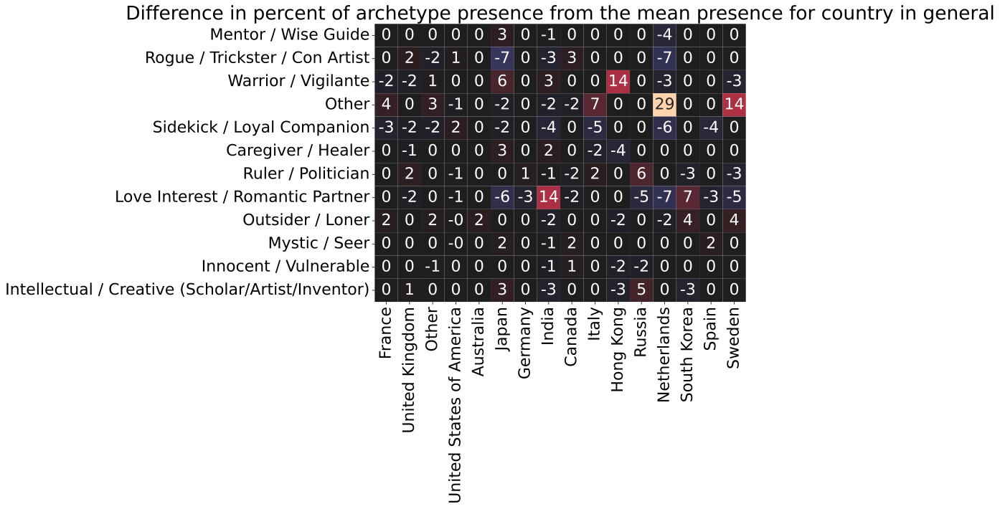

In [23]:
# hidecode
df_filtered = df.explode("countries").rename(dict(countries="country"), axis=1)

plt.figure(figsize=(15, 15))
plot_2d_heatmap(
    df_filtered,
    "country",
    "archetype",
    num_xbins=16,
    num_ybins=100,
    compare_default_value="subtract",
)
plt.title(
    "Difference in percent of archetype presence from the mean presence for country in general"
)
plt.tight_layout()
None

If we look at Other archetypes in Netherlands, we can see that most of such cases are silent movies. Indeed, it's hard to analyse characters archetypes in such movies

In [24]:
# hidecode
df_filtered[
    (df_filtered.country == "Netherlands") & (df_filtered.archetype == "Other")
][["character_name", "movie_name", "country", "genres"]].explode(
    "genres"
).genres.value_counts().head(
    5
)

genres
Silent     161
Drama      150
Classic     62
Comedy      60
Crime       28
Name: count, dtype: int64

After taking look at the general picture again, it's interesting to know if, for example, actors casted for "Love Interest" differ for Romance and Comedy movies

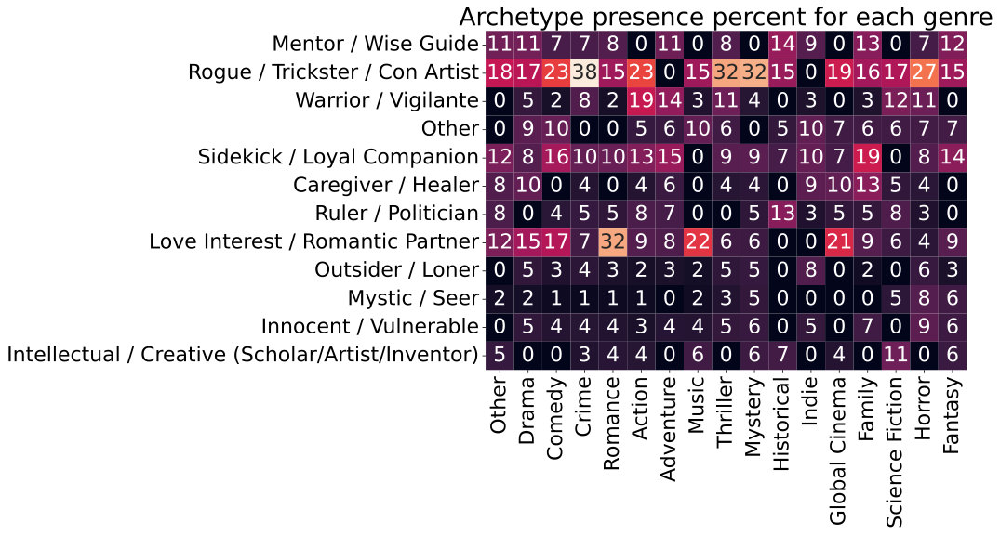

In [25]:
# hidecode
df_filtered = df.explode("genres").rename(dict(genres="genre"), axis=1)

plt.figure(figsize=(15, 15))
plot_2d_heatmap(df_filtered, "genre", "archetype", num_xbins=16, num_ybins=100)
plt.title("Archetype presence percent for each genre")
plt.tight_layout()
None

We may see that in comedy movies love interest is more likely to be a female than in romance movies

In [26]:
# hidecode
archetype = "Love Interest / Romantic Partner"
df_filtered = df[(df.archetype == archetype) & (~df.gender.isna())]
df_filtered = df_filtered.explode("genres").rename(dict(genres="genre"), axis=1)
df_filtered = df_filtered[df_filtered.genre.isin(["Romance", "Comedy"])]

fig = px.histogram(
    df_filtered,
    x="gender",
    color="genre",
    barmode="group",
    histnorm="probability density",
    height=400,
    title=f'Distribution of gender in "{archetype}" by gender',
    text_auto=True,
)
fig = fig.update_xaxes(categoryorder="total descending")

fig.update_layout(
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)
fig.update_layout(font_size=18)

display.display_html(fig.to_html(full_html=False, include_plotlyjs="cdn"), raw=True)

## Conclusion

Indeed, we can see that casting trends vary across different genres and film industries, showing cultural and genre influence on casting choices. Some of the interesting cherry-picks are:

- In Japan movies trickster charecters' actors are higher than average actor compared to actors of India or USA
- In Japan there were no entries of Caucasus, Indian, Native American, and Pacific Islander as trickster-playing actors. Also, there were no Latino entries for India
- UK is very different from other countries by casting Arab and Caucasus as tricksters relatively more frequently
- India has higher portion of males playing "Love Interest" roles than in other countries
- Comedy movies love interest actor is more likely to be a female than in romance movies

# Question 5. How Did Casting Trends For Different Archetypes Vary Across Time?

This section is dedicated to the analysis of casting impact on ```Archetype```'s. 

Under the "casting process", we consider several ```Acror``` parameters, ```genre``` factor and world progress development, e.g., Box Office Revenue. In particular, we analyze the following main sub-topics:

* We study how the ```Archetype``` changes for each ```Actor``` over time.
* We investigate which ```Archetypes``` are more popular over time.
* We identify which ```genres``` are more suitable for a specific ```Archetype```.
* We show which ```Archetypes``` are likely to be presented in movies with huge Box Office performance.
* Finally, we present how ```Actors```' height and age affect the dominating ```Archetype``` in these cases and provide insights into which ```Actors``` are more suitable for a given ```Archetype```.

In [1]:
# ignore
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import numpy as np
import math

warnings.filterwarnings("ignore")
rcparams = {"axes.facecolor": "#F5F5DC"}
sns.set_theme(context="notebook", style="darkgrid", font="sans-serif", rc=rcparams)

In [2]:
# ignore
%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [3]:
# ignore
df_archetype_predictions_joined = pd.read_csv(
    "../data/MovieSummaries/archetype_predictions_joined.csv"
)
df_movie_processed = pd.read_csv("../data/MovieSummaries/movie_processed.csv")
df_character_processed = pd.read_csv("../data/MovieSummaries/character_processed.csv")

In [4]:
# ignore
df_archetype_predictions_joined.head()

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo
1,1,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'2-Gun' Gertie Baxter,Roxie Hart,/m/026l5ym,/m/049wny,gpt-4o
2,2,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,gpt-3.5-turbo
3,3,Warrior / Vigilante,Warrior / Vigilante,'Ace' Cooper,The Dude Bandit,/m/07s5z0d,/m/05ddzx,gpt-3.5-turbo
4,4,Warrior / Vigilante,Warrior / Vigilante,'Baby Face' Martin,Dead End,/m/0gnrt,/m/03n6r,gpt-4o


In [5]:
# ignore
df_movie_processed.head()

,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres
0,975900,/m/03vyhn,Ghosts of Mars,14010832.0,98.0,['english'],2001-08-24,['United States of America'],['United States of America'],"['Thriller', 'Science Fiction', 'Action', 'Wes..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,NaN,95.0,['english'],2000-02-16,['United States of America'],['United States of America'],"['Drama', 'Mystery', 'Crime', 'Biography']"
2,28463795,/m/0crgdbh,Brun bitter,NaN,83.0,['norwegian'],1988-01-01,['Norway'],['Norway'],"['Drama', 'Crime']"
3,9363483,/m/0285_cd,White Of The Eye,NaN,110.0,['english'],1987-01-01,['United Kingdom'],['United Kingdom'],"['Thriller', 'Erotic']"
4,261236,/m/01mrr1,A Woman in Flames,NaN,106.0,['german'],1983-01-01,['Germany'],['Germany'],['Drama']


In [6]:
# ignore
df_character_processed.head()

,Wikipedia movie ID,Freebase movie ID,Character name,Actor gender,Actor height (in meters),Actor ethnicity (Freebase ID),Actor name,Freebase character/actor map ID,Freebase character ID,Freebase actor ID,actor_date_of_birth,movie_release_date,ethn_name,race
0,975900,/m/03vyhn,Akooshay,F,1.620,NaN,Wanda De Jesus,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,1958-08-26,2001-08-24,NaN,NaN
1,975900,/m/03vyhn,Lieutenant Melanie Ballard,F,1.780,/m/044038p,Natasha Henstridge,/m/0jys3m,/m/0bgchn4,/m/0346l4,1974-08-15,2001-08-24,NaN,NaN
2,975900,/m/03vyhn,Desolation Williams,M,1.727,/m/0x67,Ice Cube,/m/0jys3g,/m/0bgchn_,/m/01vw26l,1969-06-15,2001-08-24,African American,African
3,975900,/m/03vyhn,Sgt Jericho Butler,M,1.750,NaN,Jason Statham,/m/02vchl6,/m/0bgchnq,/m/034hyc,1967-09-12,2001-08-24,NaN,NaN
4,975900,/m/03vyhn,Bashira Kincaid,F,1.650,NaN,Clea DuVall,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,1977-09-25,2001-08-24,NaN,NaN


In [7]:
# ignore
def analyze_actor_archetypes(actor_fb_id, df_archetype, df_movie, df_character):
    """
    Analyze archetypes for a specific actor across their movies
    """
    actor_name = (
        df_character[df_character["Freebase actor ID"] == actor_fb_id][
            "Actor name"
        ].iloc[0]
        if not df_character[df_character["Freebase actor ID"] == actor_fb_id].empty
        else actor_fb_id
    )

    actor_movies = df_archetype[
        df_archetype["actor_fb_id"].str.contains(actor_fb_id, case=False, na=False)
    ]

    actor_movies_detailed = actor_movies.merge(
        df_movie, left_on="movie_fb_id", right_on="Freebase movie ID", how="left"
    )

    actor_movies_detailed = actor_movies_detailed.sort_values("movie_release_date")

    actor_movies_detailed["actor_name"] = actor_name

    return actor_movies_detailed

In [8]:
# ignore
def plot_actor_archetypes(actor_fb_id, df_archetype, df_movie, df_character):
    """
    Create a visualization of actor's archetypes over time
    """
    actor_data = analyze_actor_archetypes(
        actor_fb_id, df_archetype, df_movie, df_character
    )

    if actor_data.empty:
        print(f"No data found for actor: {actor_fb_id}")
        return

    actor_name = actor_data["actor_name"].iloc[0]

    plt.figure(figsize=(12, 6), dpi=300)

    plt.plot(
        actor_data["movie_release_date"],
        actor_data["prediction"],
        color="black",
        linewidth=1,
        linestyle="--",
        zorder=1,
    )

    plt.scatter(
        actor_data["movie_release_date"],
        actor_data["prediction"],
        label="Prediction Archetype",
        color="red",
        marker="^",
        s=120,
        zorder=2,
    )

    plt.title(f"Archetypes for {actor_name} Over Time", fontsize=25)
    plt.xlabel("Movie Release Year", fontsize=25)
    plt.ylabel("Archetype", fontsize=25)
    plt.legend(fontsize=20)
    plt.grid(True, alpha=0.7)
    plt.xticks(rotation=45, fontsize=15)
    plt.yticks(fontsize=15)

    plt.tight_layout()
    plt.show()

In [9]:
# ignore
actor_data = analyze_actor_archetypes(
    "/m/06_3lt",
    df_archetype=df_archetype_predictions_joined,
    df_movie=df_movie_processed,
    df_character=df_character_processed,
)

In [10]:
# ignore
actor_data

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres,actor_name
2,57155,Caregiver / Healer,Caregiver / Healer,Mrs. Douglas,That Was Then... This Is Now,/m/04jvgb,/m/06_3lt,gpt-4o,1223359,/m/04jvgb,That Was Then... This Is Now,8630068.0,101.0,['english'],1985-11-08,['United States of America'],['United States of America'],"['Drama', 'Teen']",Barbara Babcock
0,6478,Other,Other,Barbara Corvin,Space Cowboys,/m/05r3qc,/m/06_3lt,gpt-4o,1722156,/m/05r3qc,Space Cowboys,128884132.0,124.0,['english'],2000-08-01,"['Australia', 'United States of America']","['Australia', 'United States of America']","['Thriller', 'Drama', 'Science Fiction', 'Acti...",Barbara Babcock
1,55352,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,Molly,Home Alone 4,/m/02xcsf,/m/06_3lt,gpt-4o,619956,/m/02xcsf,Home Alone 4,NaN,84.0,['english'],2002-11-03,['United States of America'],['United States of America'],"['Family', 'Comedy', 'Christmas', 'Holiday', '...",Barbara Babcock


## Archetypes & Actors

We provide results on which ```Archetypes``` ```Actors``` prefer throughout their career paths. Some famous actors may prefer different roles and change them from time to time, while others may stick to the same ```Archetype``` roles and become the top pick for them (as we will see in the last section, especially).

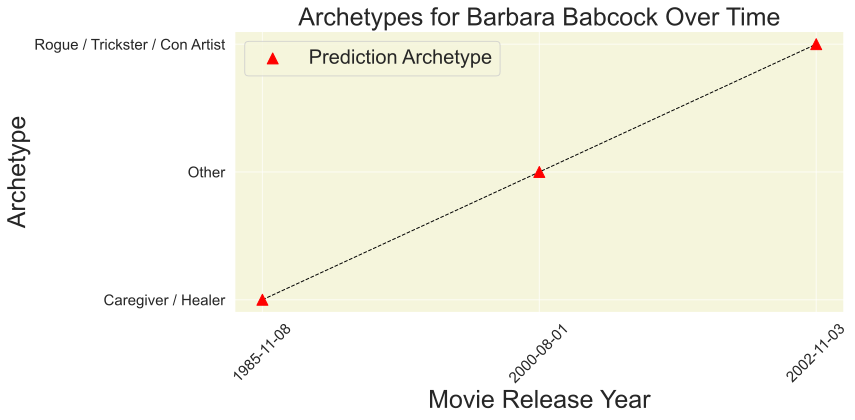

In [11]:
# hidecode
plot_actor_archetypes(
    "/m/06_3lt",
    df_archetype=df_archetype_predictions_joined,
    df_movie=df_movie_processed,
    df_character=df_character_processed,
)

In [12]:
# hidecode
num_actors = 100
actor_fb_id_list = (
    df_archetype_predictions_joined["actor_fb_id"].head(num_actors).tolist()
)

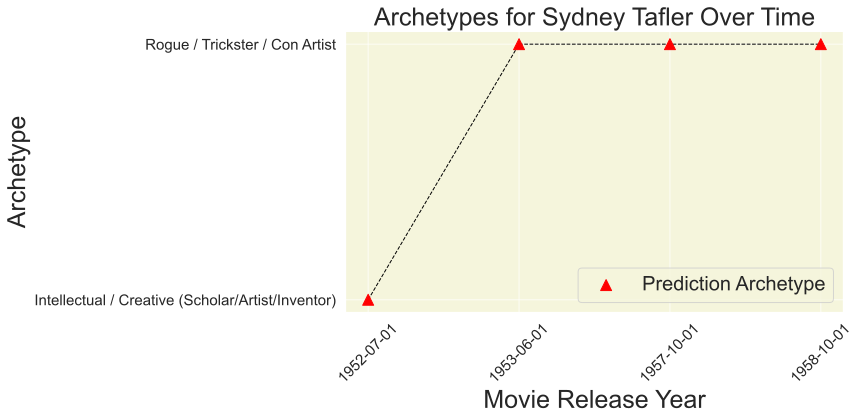

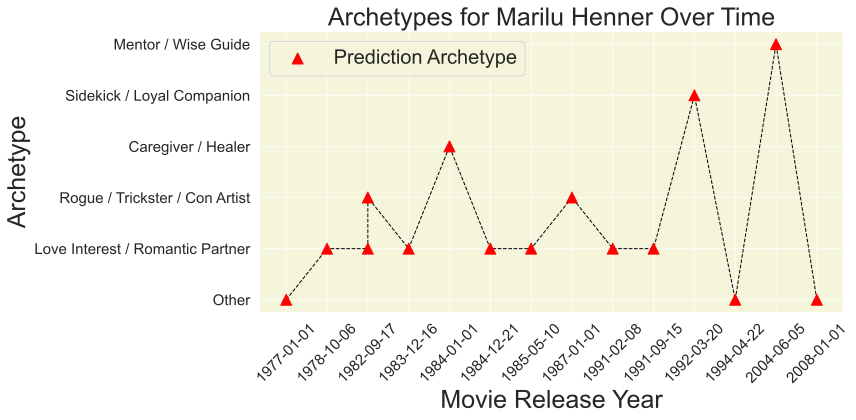

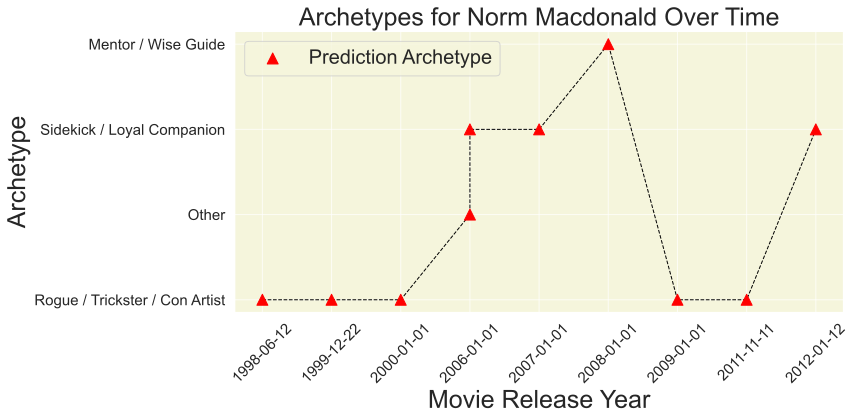

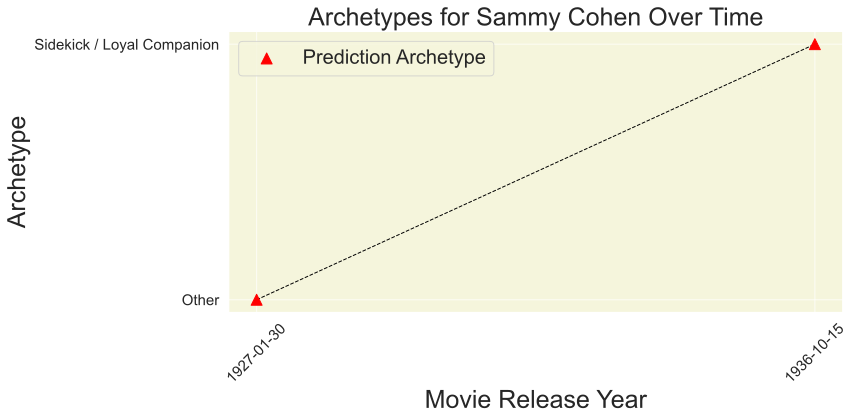

In [13]:
# hidecode
for fb_id in actor_fb_id_list[40:44]:
    plot_actor_archetypes(
        fb_id,
        df_archetype=df_archetype_predictions_joined,
        df_movie=df_movie_processed,
        df_character=df_character_processed,
    )

E.g., for some of the ''canonical'' examples of ```Actors```, we may observe that they prefer different roles over time.

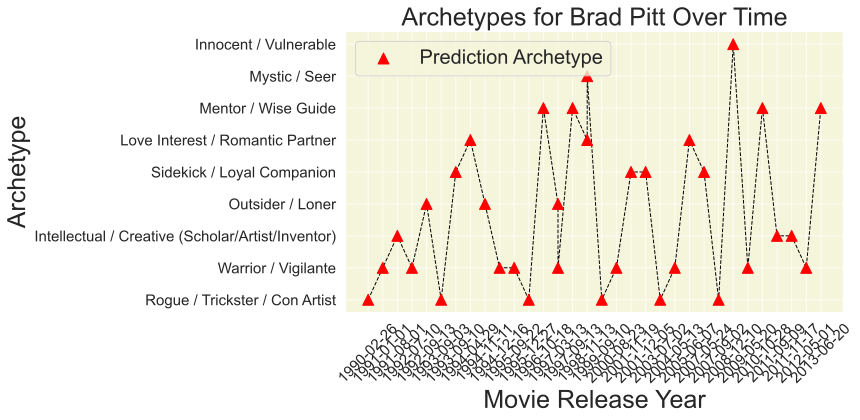

In [14]:
# hidecode
plot_actor_archetypes(
    "/m/0c6qh",
    df_archetype=df_archetype_predictions_joined,
    df_movie=df_movie_processed,
    df_character=df_character_processed,
)

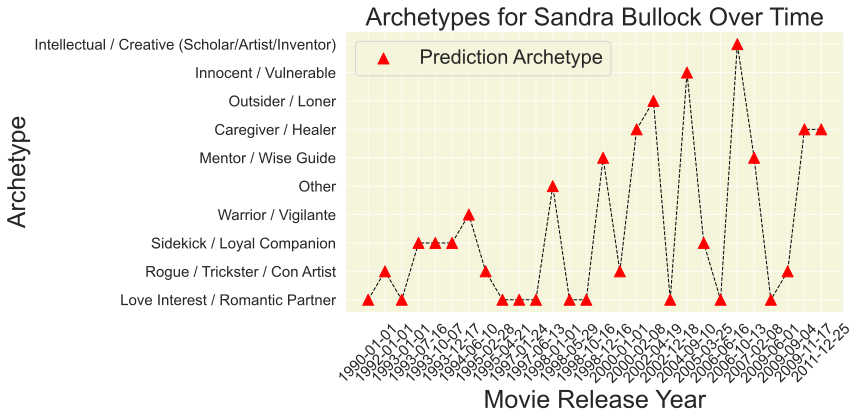

In [15]:
# hidecode
plot_actor_archetypes(
    "/m/0794g",
    df_archetype=df_archetype_predictions_joined,
    df_movie=df_movie_processed,
    df_character=df_character_processed,
)

## Archetype Prevalence Over Time

In [16]:
# ignore
df_merged = pd.merge(
    df_archetype_predictions_joined,
    df_movie_processed,
    left_on="movie_fb_id",
    right_on="Freebase movie ID",
)

df_merged["movie_release_date"] = pd.to_datetime(df_merged["movie_release_date"])

df_merged["release_year"] = df_merged["movie_release_date"].dt.year

df_archetype_trends = (
    df_merged.groupby(["release_year", "prediction"]).size().unstack(fill_value=0)
)

In [17]:
# ignore
df_merged.head(10)

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres,release_year
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
1,1384,Caregiver / Healer,Caregiver / Healer,Ailes Gilmour,Leonie,/m/05zr2p5,/m/07gnvd,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
2,1841,Caregiver / Healer,Caregiver / Healer,Albiana,Leonie,/m/05zr2p5,/m/053y4h,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
3,5092,Other,Other,Art Gallery Patron,Leonie,/m/05zr2p5,/m/0gm10lf,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
4,21926,Mentor / Wise Guide,Mentor / Wise Guide,Dr. Rumely,Leonie,/m/05zr2p5,/m/06k4j6,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
5,34659,Mentor / Wise Guide,Mentor / Wise Guide,Isamu Noguchi,Leonie,/m/05zr2p5,/m/0n37qmt,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
6,45754,Caregiver / Healer,Caregiver / Healer,Leonie,Leonie,/m/05zr2p5,/m/03k545,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
7,53921,Mentor / Wise Guide,Mentor / Wise Guide,Michihiko Kawada,Leonie,/m/05zr2p5,/m/0gbwtgv,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
8,73118,Caregiver / Healer,Caregiver / Healer,Setsu Koizumi,Leonie,/m/05zr2p5,/m/0555rx,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
9,86305,Mentor / Wise Guide,Mentor / Wise Guide,Yone Noguchi,Leonie,/m/05zr2p5,/m/0b20t3,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010


Let us see how movie ```Archetypes``` change over the years.

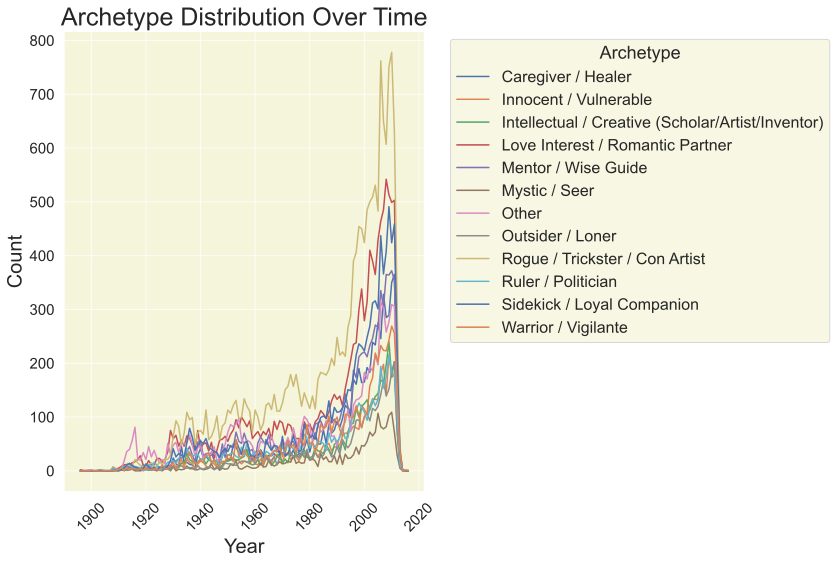

In [18]:
# hidecode
plt.figure(figsize=(12, 8), dpi=300)
df_archetype_trends.plot(ax=plt.gca(), linewidth=1.5)
plt.title("Archetype Distribution Over Time", fontsize=25)
plt.xlabel("Year", fontsize=20)
plt.ylabel("Count", fontsize=20)
plt.legend(
    title="Archetype",
    title_fontsize=18,
    fontsize=16,
    bbox_to_anchor=(1.05, 1),
    loc="upper left",
)
plt.grid(True, alpha=0.7)
plt.xticks(rotation=45, fontsize=15)
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

* What is obvious: the number of movies has increased, and thus the number of ```Archetypes``` has also increased.
* What is less obvious: we observe the prevalence of the same 3 main ```Archetypes``` (Rogue/Trickster/Con Artist, Love Interest, Sidekick) consistently since the 1930s.

In [19]:
# ignore
df_actor_archetype_transitions = df_merged.groupby("actor_fb_id")["prediction"].agg(
    list
)
df_actor_archetype_transitions.head()

actor_fb_id
/m/010p3     [Love Interest / Romantic Partner, Mentor / Wi...
/m/010xjr    [Mentor / Wise Guide, Mentor / Wise Guide, War...
/m/0112yl    [Mentor / Wise Guide, Rogue / Trickster / Con ...
/m/011_2h                     [Rogue / Trickster / Con Artist]
/m/011_3s    [Mentor / Wise Guide, Sidekick / Loyal Compani...
Name: prediction, dtype: object

In [20]:
# ignore
df_merged

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model,Wikipedia movie ID,Freebase movie ID,Movie name,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres,release_year
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
1,1384,Caregiver / Healer,Caregiver / Healer,Ailes Gilmour,Leonie,/m/05zr2p5,/m/07gnvd,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
2,1841,Caregiver / Healer,Caregiver / Healer,Albiana,Leonie,/m/05zr2p5,/m/053y4h,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
3,5092,Other,Other,Art Gallery Patron,Leonie,/m/05zr2p5,/m/0gm10lf,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
4,21926,Mentor / Wise Guide,Mentor / Wise Guide,Dr. Rumely,Leonie,/m/05zr2p5,/m/06k4j6,gpt-3.5-turbo,22611767,/m/05zr2p5,Leonie,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87212,87205,Love Interest / Romantic Partner,Love Interest / Romantic Partner,Éva,À gauche en sortant de l'ascenseur,/m/03y9008,/m/016nhj,gpt-3.5-turbo,16512511,/m/03y9008,À gauche en sortant de l'ascenseur,NaN,78.0,['french'],1988-08-31,['France'],['France'],['Comedy'],1988
87213,87207,Mentor / Wise Guide,Mentor / Wise Guide,Óscar Romero,Romero,/m/028jwd,/m/01yvzx,gpt-3.5-turbo,438116,/m/028jwd,Romero,NaN,102.0,['english'],1989-01-01,['United States of America'],['United States of America'],"['Drama', 'War', 'Biography', 'Religious', 'Do...",1989
87214,87214,Sidekick / Loyal Companion,Sidekick / Loyal Companion,Şaban,Hababam Sınıfı Tatilde,/m/0g5rqxx,/m/02lbb_,gpt-4o,30353952,/m/0g5rqxx,Hababam Sınıfı Tatilde,NaN,90.0,[],1977-01-01,['Turkey'],['Turkey'],['Comedy'],1977
87215,87215,Sidekick / Loyal Companion,Sidekick / Loyal Companion,Şaban,Hababam sinifi,/m/02q9v9h,/m/02lbb_,gpt-3.5-turbo,10376295,/m/02q9v9h,Hababam sinifi,NaN,87.0,['turkish'],1975-04-01,['Turkey'],['Turkey'],['Comedy'],1975


In [21]:
# ignore
df_character_processed

,Wikipedia movie ID,Freebase movie ID,Character name,Actor gender,Actor height (in meters),Actor ethnicity (Freebase ID),Actor name,Freebase character/actor map ID,Freebase character ID,Freebase actor ID,actor_date_of_birth,movie_release_date,ethn_name,race
0,975900,/m/03vyhn,Akooshay,F,1.620,NaN,Wanda De Jesus,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,1958-08-26,2001-08-24,NaN,NaN
1,975900,/m/03vyhn,Lieutenant Melanie Ballard,F,1.780,/m/044038p,Natasha Henstridge,/m/0jys3m,/m/0bgchn4,/m/0346l4,1974-08-15,2001-08-24,NaN,NaN
2,975900,/m/03vyhn,Desolation Williams,M,1.727,/m/0x67,Ice Cube,/m/0jys3g,/m/0bgchn_,/m/01vw26l,1969-06-15,2001-08-24,African American,African
3,975900,/m/03vyhn,Sgt Jericho Butler,M,1.750,NaN,Jason Statham,/m/02vchl6,/m/0bgchnq,/m/034hyc,1967-09-12,2001-08-24,NaN,NaN
4,975900,/m/03vyhn,Bashira Kincaid,F,1.650,NaN,Clea DuVall,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,1977-09-25,2001-08-24,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334982,913762,/m/03pcrp,UN Spacy Commander,M,NaN,NaN,Sonny Byrkett,/m/0kr407w,/m/0kr407_,/m/0gn4bz,1954-01-01,1992-05-21,NaN,NaN
334983,913762,/m/03pcrp,Silvie Gena,F,NaN,NaN,Susan Byrkett,/m/0kr40b9,/m/0kr40bf,/m/0gn4nd,1958-01-01,1992-05-21,NaN,NaN
334984,913762,/m/03pcrp,Elensh,F,NaN,NaN,Dorothy Elias-Fahn,/m/0kr406c,/m/0kr406h,/m/0b_vcv,1970-05-01,1992-05-21,NaN,NaN
334985,913762,/m/03pcrp,Hibiki,M,NaN,NaN,Jonathan Fahn,/m/0kr405_,/m/0kr4090,/m/0bx7_j,1965-04-12,1992-05-21,NaN,NaN


## Archetypes & Genres

In [23]:
# ignore
genre_archetype_correlation = (
    df_merged.groupby(["genres", "prediction"]).size().unstack()
)
genre_archetype_correlation.head()

prediction,Caregiver / Healer,Innocent / Vulnerable,Intellectual / Creative (Scholar/Artist/Inventor),Love Interest / Romantic Partner,Mentor / Wise Guide,Mystic / Seer,Other,Outsider / Loner,Rogue / Trickster / Con Artist,Ruler / Politician,Sidekick / Loyal Companion,Warrior / Vigilante
genres,,,,,,,,,,,,
"['Action', 'Adventure', 'Comedy', 'Crime']",1.0,NaN,1.0,5.0,2.0,NaN,13.0,NaN,34.0,1.0,14.0,5.0
"['Action', 'Adventure', 'Comedy', 'Dark Comedy']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
"['Action', 'Adventure', 'Comedy', 'Global Cinema']",NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN
"['Action', 'Adventure', 'Comedy']",NaN,NaN,NaN,NaN,NaN,1.0,2.0,1.0,11.0,NaN,1.0,NaN
"['Action', 'Adventure', 'Drama', 'Comedy']",NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,1.0,NaN,3.0,2.0


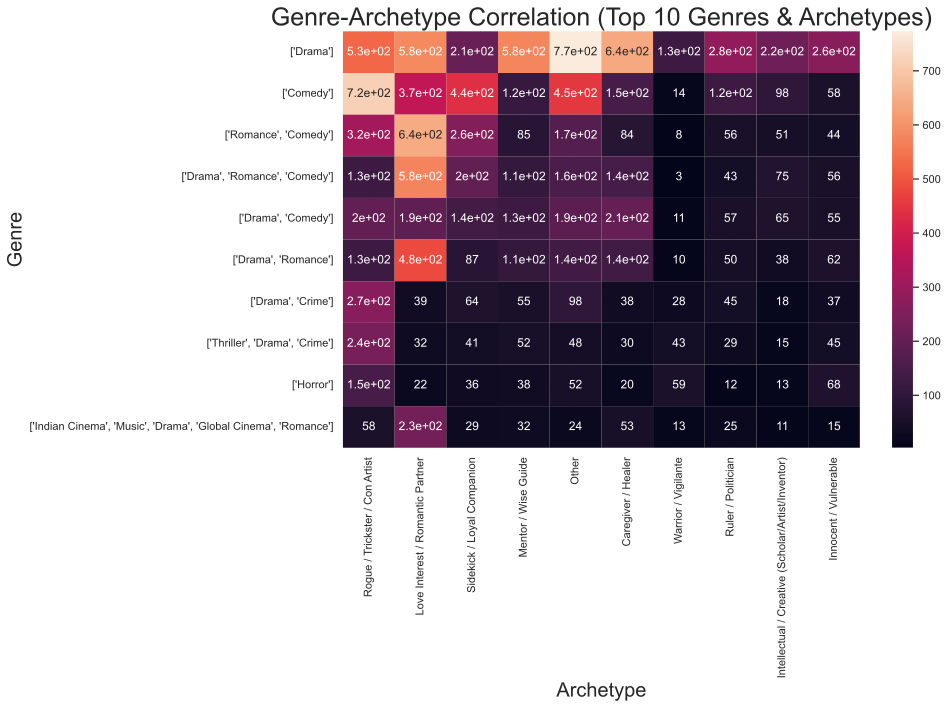

In [24]:
# hidecode
top_genres = genre_archetype_correlation.sum(axis=1).nlargest(10).index
top_archetypes = genre_archetype_correlation.sum(axis=0).nlargest(10).index
filtered_genre_archetype_correlation = genre_archetype_correlation.loc[
    top_genres, top_archetypes
]

plt.figure(figsize=(14, 10), dpi=300)
sns.heatmap(
    filtered_genre_archetype_correlation,
    annot=True,
)
plt.title("Genre-Archetype Correlation (Top 10 Genres & Archetypes)", fontsize=25)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Genre", fontsize=20)
plt.tight_layout()
plt.show()

We present the co-occurrence between the top 10 popular ```genres``` and ```Archetypes```. For 'Drama,' the main genre, we observe that drama movies include characters representing all ```Archetypes```. However, movies in less popular ```genres```, such as 'Horror,' tend to feature many evil ```Archetypes```. We point that for broad and popular movie ```genres```, it is unlikely to find an ```Archetype``` that does not suit them.

In [25]:
# ignore
plt.figure(figsize=(14, 10), dpi=300)
sns.heatmap(
    genre_archetype_correlation,
    annot=False,
)

plt.title("Genre-Archetype Correlation", fontsize=25)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Genre", fontsize=20)
plt.tight_layout()
plt.show()

## Archetypes & Box Office

In [26]:
# ignore
archetype_box_office = (
    df_merged.groupby("prediction")["Movie box office revenue"]
    .mean()
    .sort_values(ascending=False)
)
archetype_box_office.head()

prediction
Warrior / Vigilante           1.360958e+08
Ruler / Politician            1.342126e+08
Sidekick / Loyal Companion    1.304970e+08
Mentor / Wise Guide           1.144700e+08
Mystic / Seer                 1.124068e+08
Name: Movie box office revenue, dtype: float64

In this section, we consider:

* Box Office Performance by ```Archetype```
* Box Office Performance by ```Genres```

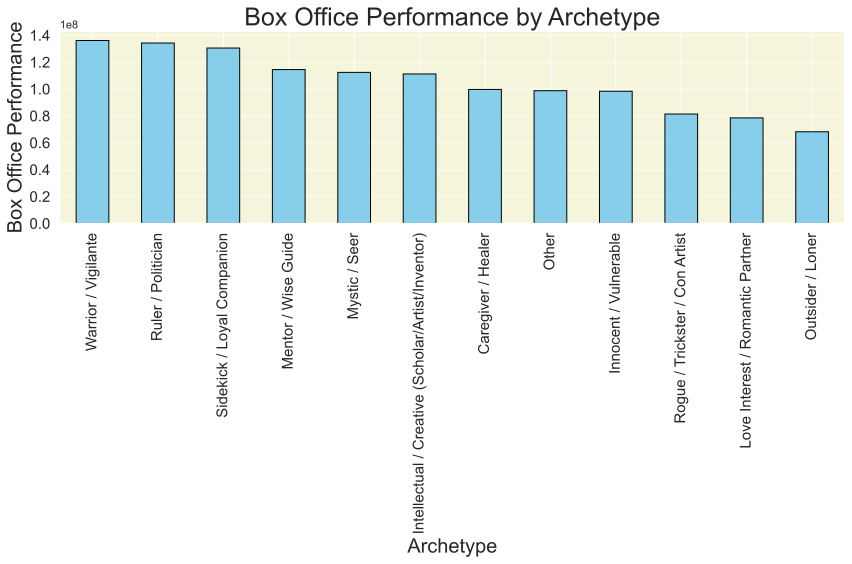

In [27]:
# hidecode
plt.figure(figsize=(12, 8), dpi=300)

archetype_box_office.plot(
    kind="bar", ax=plt.gca(), color="skyblue", edgecolor="black", linewidth=1
)
plt.title("Box Office Performance by Archetype", fontsize=25)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Box Office Performance", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
# plt.xticks(rotation=45, fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [28]:
# ignore
genres_box_office = (
    df_merged.groupby("genres")["Movie box office revenue"]
    .mean()
    .sort_values(ascending=False)
)
genres_box_office.head()

genres
['Thriller', 'Epic', 'Science Fiction', 'Action', 'Fantasy', 'Adventure', 'Animation', 'Documentary']    2.782275e+09
['Drama', 'Disaster', 'Action', 'Historical', 'Adventure', 'Romance']                                    2.185372e+09
['Drama', 'Mystery', 'Fantasy', 'Adventure']                                                             1.328111e+09
['Alien', 'Science Fiction', 'Action', 'Adventure']                                                      1.123747e+09
['Action', 'Adventure', 'Fantasy', 'Comedy']                                                             1.043872e+09
Name: Movie box office revenue, dtype: float64

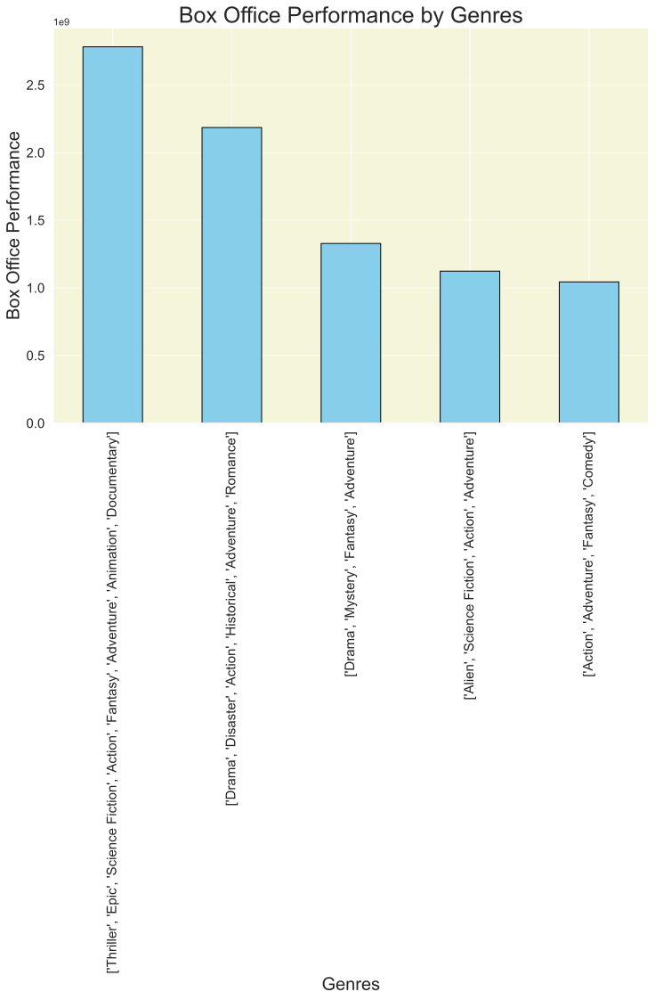

In [29]:
# hidecode
plt.figure(figsize=(12, 8), dpi=300)

genres_box_office[:5].plot(
    kind="bar", ax=plt.gca(), color="skyblue", edgecolor="black", linewidth=1
)
plt.title("Box Office Performance by Genres", fontsize=25)
plt.xlabel("Genres", fontsize=20)
plt.ylabel("Box Office Performance", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

It is more likely that 'Warrior/Vigilante', 'Sidekick', or 'Politician' ```Archetypes``` will be featured in successful box office movies. However, movies in the comedy ```genre``` tend to be less successful compared to the other top four ```genres```. Additionally, we observe a significant gap between movies that incorporate 'Thriller,' 'Documentary,' or 'Epic/Disaster' (our top two ```genres```) and others.

## Archetypes & their best bearers

In [30]:
# ignore
df_character_processed

,Wikipedia movie ID,Freebase movie ID,Character name,Actor gender,Actor height (in meters),Actor ethnicity (Freebase ID),Actor name,Freebase character/actor map ID,Freebase character ID,Freebase actor ID,actor_date_of_birth,movie_release_date,ethn_name,race
0,975900,/m/03vyhn,Akooshay,F,1.620,NaN,Wanda De Jesus,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,1958-08-26,2001-08-24,NaN,NaN
1,975900,/m/03vyhn,Lieutenant Melanie Ballard,F,1.780,/m/044038p,Natasha Henstridge,/m/0jys3m,/m/0bgchn4,/m/0346l4,1974-08-15,2001-08-24,NaN,NaN
2,975900,/m/03vyhn,Desolation Williams,M,1.727,/m/0x67,Ice Cube,/m/0jys3g,/m/0bgchn_,/m/01vw26l,1969-06-15,2001-08-24,African American,African
3,975900,/m/03vyhn,Sgt Jericho Butler,M,1.750,NaN,Jason Statham,/m/02vchl6,/m/0bgchnq,/m/034hyc,1967-09-12,2001-08-24,NaN,NaN
4,975900,/m/03vyhn,Bashira Kincaid,F,1.650,NaN,Clea DuVall,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,1977-09-25,2001-08-24,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334982,913762,/m/03pcrp,UN Spacy Commander,M,NaN,NaN,Sonny Byrkett,/m/0kr407w,/m/0kr407_,/m/0gn4bz,1954-01-01,1992-05-21,NaN,NaN
334983,913762,/m/03pcrp,Silvie Gena,F,NaN,NaN,Susan Byrkett,/m/0kr40b9,/m/0kr40bf,/m/0gn4nd,1958-01-01,1992-05-21,NaN,NaN
334984,913762,/m/03pcrp,Elensh,F,NaN,NaN,Dorothy Elias-Fahn,/m/0kr406c,/m/0kr406h,/m/0b_vcv,1970-05-01,1992-05-21,NaN,NaN
334985,913762,/m/03pcrp,Hibiki,M,NaN,NaN,Jonathan Fahn,/m/0kr405_,/m/0kr4090,/m/0bx7_j,1965-04-12,1992-05-21,NaN,NaN


In this section, we study some of the ```Actor``` parameters that attract them to become a good fit for a role. We are interested in the following ```Actor``` features:

* height
* age at the moment of movie's release

additionally, we present examples of ```Actors``` who frequently play specific ```Archetypes```.

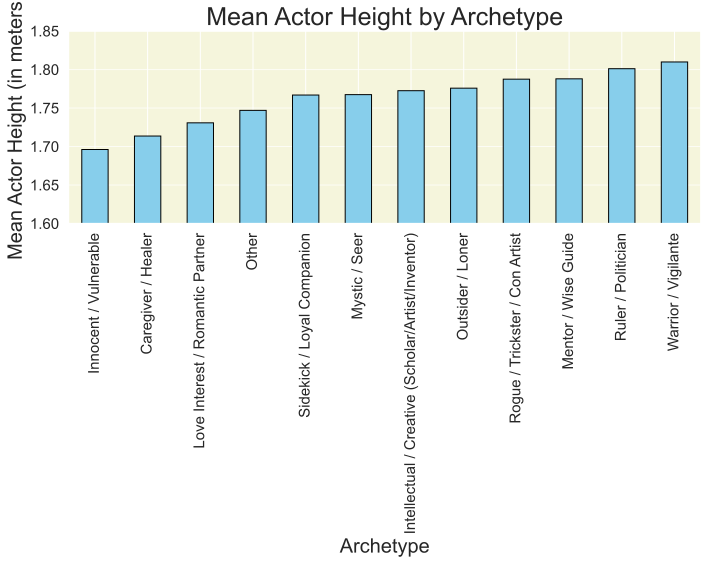

In [31]:
# hidecode
df_merged_with_height = pd.merge(
    df_merged,
    df_character_processed[["Freebase actor ID", "Actor height (in meters)"]],
    left_on="actor_fb_id",
    right_on="Freebase actor ID",
    how="left",
)

df_merged_with_height.drop(columns=["Freebase actor ID"], inplace=True)
df_merged_with_height.dropna(subset=["Actor height (in meters)"], inplace=True)
height_archetype_correlation = (
    df_merged_with_height.groupby("prediction")["Actor height (in meters)"]
    .mean()
    .sort_values()
)

plt.figure(figsize=(10, 8), dpi=300)

height_archetype_correlation.plot(
    kind="bar", color="skyblue", edgecolor="black", linewidth=1
)
plt.title("Mean Actor Height by Archetype", fontsize=25)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Mean Actor Height (in meters)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.ylim(1.6, 1.85)
plt.tight_layout()
plt.show()

Here it is natural. But what about age?

In [32]:
# ignore
df_age_analysis = df_merged.merge(
    df_character_processed[["actor_date_of_birth"]],
    left_index=True,
    right_index=True,
    how="left",
)
df_age_analysis["actor_age"] = (
    pd.to_datetime(df_age_analysis["movie_release_date"])
    - pd.to_datetime(df_age_analysis["actor_date_of_birth"])
).dt.days / 365.25
df_age_analysis = df_age_analysis.dropna(subset=["actor_age"])

df_old_actors = df_age_analysis[df_age_analysis["actor_age"] > 50]
df_young_actors = df_age_analysis[df_age_analysis["actor_age"] < 35]

old_actors_dist = df_old_actors["prediction"].value_counts(normalize=True) * 100
young_actors_dist = df_young_actors["prediction"].value_counts(normalize=True) * 100

In [33]:
# ignore
df_age_analysis.head()

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model,Wikipedia movie ID,Freebase movie ID,...,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres,release_year,actor_date_of_birth,actor_age
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,1958-08-26,51.351129
1,1384,Caregiver / Healer,Caregiver / Healer,Ailes Gilmour,Leonie,/m/05zr2p5,/m/07gnvd,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,1974-08-15,35.381246
2,1841,Caregiver / Healer,Caregiver / Healer,Albiana,Leonie,/m/05zr2p5,/m/053y4h,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,1969-06-15,40.547570
3,5092,Other,Other,Art Gallery Patron,Leonie,/m/05zr2p5,/m/0gm10lf,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,1967-09-12,42.305270
4,21926,Mentor / Wise Guide,Mentor / Wise Guide,Dr. Rumely,Leonie,/m/05zr2p5,/m/06k4j6,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,1977-09-25,32.268309


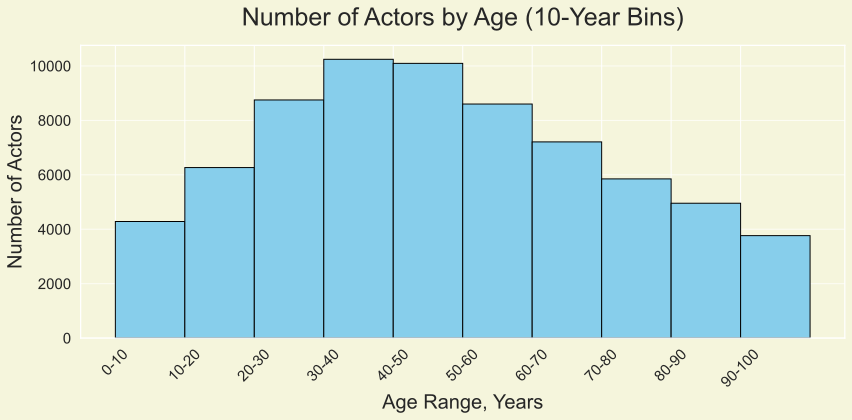

In [34]:
# ignore
age_bins = np.arange(0, 110, 10)

age_counts, bin_edges = np.histogram(df_age_analysis["actor_age"], bins=age_bins)

plt.figure(figsize=(12, 6), dpi=300, facecolor="#F5F5DC")
plt.bar(
    bin_edges[:-1],
    age_counts,
    width=10,
    align="edge",
    color="skyblue",
    edgecolor="black",
    linewidth=1,
)

plt.xlabel("Age Range, Years", fontsize=20)
plt.ylabel("Number of Actors", fontsize=20)
plt.title("Number of Actors by Age (10-Year Bins)", fontsize=25, pad=20)
plt.xticks(
    bin_edges[:-1],
    [f"{int(age)}-{int(age + 10)}" for age in bin_edges[:-1]],
    rotation=45,
    fontsize=15,
)
plt.yticks(fontsize=15)
plt.grid(True, axis="y", alpha=0.7)
plt.tight_layout()
plt.show()

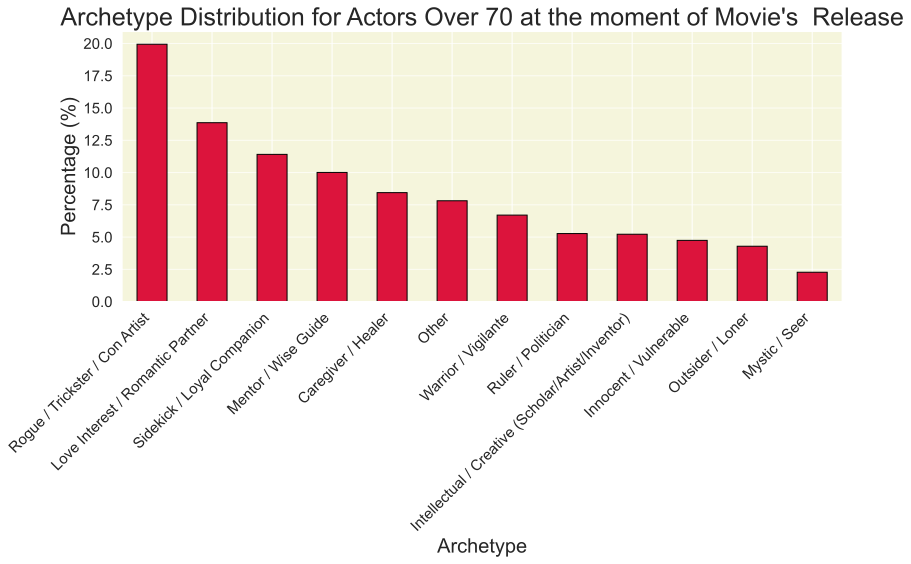

In [35]:
# ignore
df_super_old_actors = df_age_analysis[df_age_analysis["actor_age"] > 70]

super_old_actors_dist = (
    df_super_old_actors["prediction"].value_counts(normalize=True) * 100
)

plt.figure(figsize=(12, 8), dpi=300)

super_old_actors_dist.plot(
    kind="bar",
    color="crimson",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 70 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [36]:
# ignore
print(len(df_super_old_actors))

21152


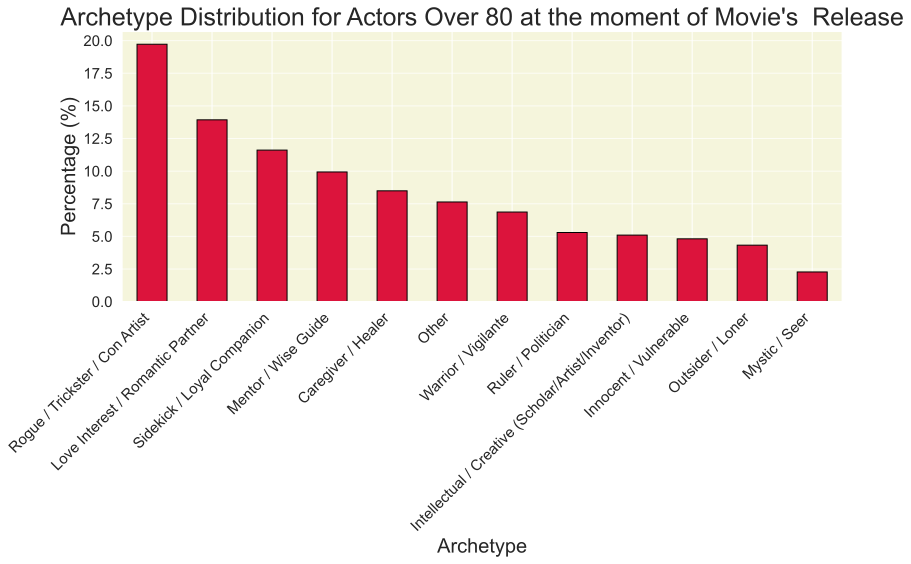

In [37]:
# ignore
df_super_old_actors_80 = df_age_analysis[df_age_analysis["actor_age"] > 80]

super_old_actors_dist_80 = (
    df_super_old_actors_80["prediction"].value_counts(normalize=True) * 100
)

plt.figure(figsize=(12, 8), dpi=300)

super_old_actors_dist_80.plot(
    kind="bar",
    color="crimson",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 80 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [38]:
# ignore
print(len(df_super_old_actors_80))

15297


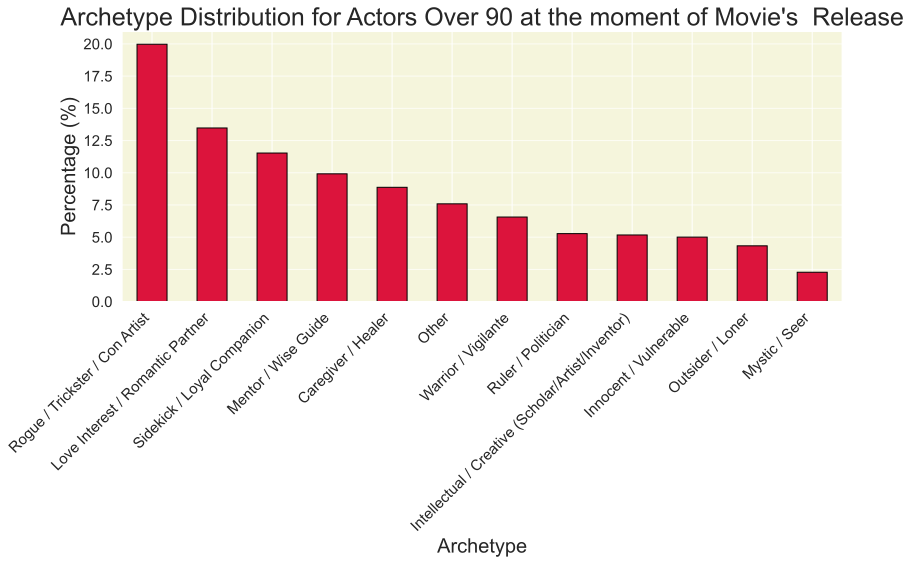

In [39]:
# ignore
df_super_old_actors_90 = df_age_analysis[df_age_analysis["actor_age"] > 90]

super_old_actors_dist_90 = (
    df_super_old_actors_90["prediction"].value_counts(normalize=True) * 100
)

plt.figure(figsize=(12, 8), dpi=300)

super_old_actors_dist_90.plot(
    kind="bar",
    color="crimson",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 90 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [40]:
# ignore
print(len(df_super_old_actors_90))

10344


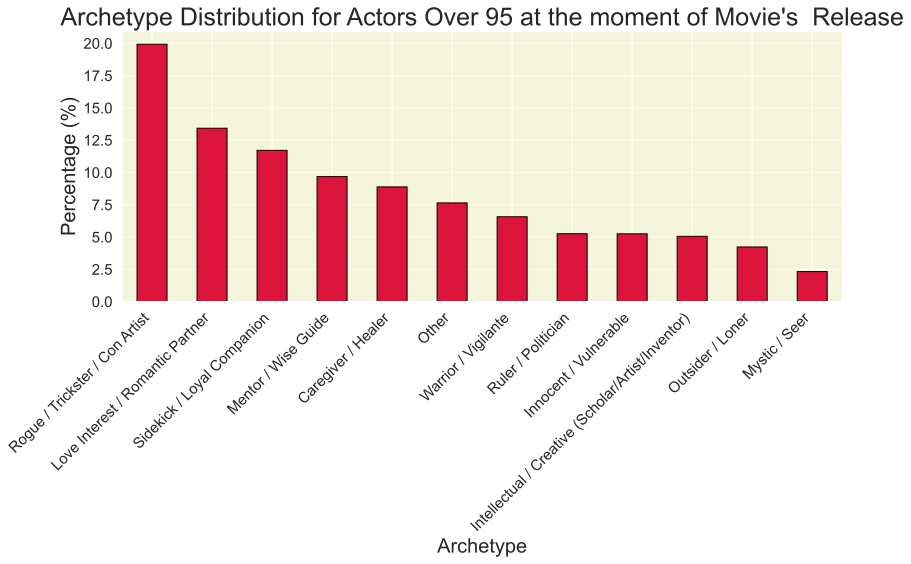

In [41]:
# ignore
df_super_old_actors_95 = df_age_analysis[df_age_analysis["actor_age"] > 95]

super_old_actors_dist_95 = (
    df_super_old_actors_95["prediction"].value_counts(normalize=True) * 100
)

plt.figure(figsize=(12, 8), dpi=300)

super_old_actors_dist_95.plot(
    kind="bar",
    color="crimson",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 95 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [42]:
# ignore
print(len(df_super_old_actors_95))

8383


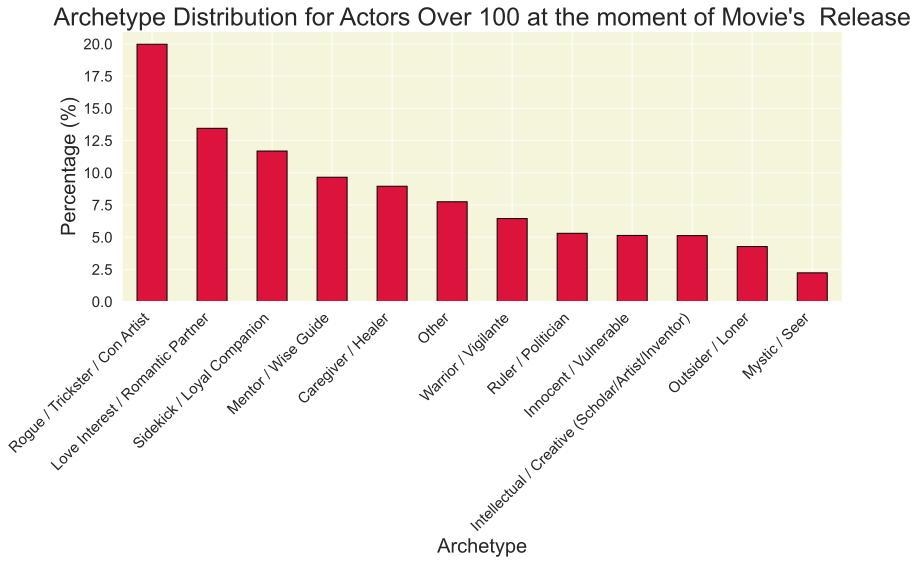

In [43]:
# ignore
df_super_old_actors_100 = df_age_analysis[df_age_analysis["actor_age"] > 100]

super_old_actors_dist_100 = (
    df_super_old_actors_100["prediction"].value_counts(normalize=True) * 100
)

plt.figure(figsize=(12, 8), dpi=300)

super_old_actors_dist_100.plot(
    kind="bar",
    color="crimson",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 100 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [44]:
# ignore
print(len(df_super_old_actors_100))

6578


We see that distributions for old enough ```Actors``` looks similarly.

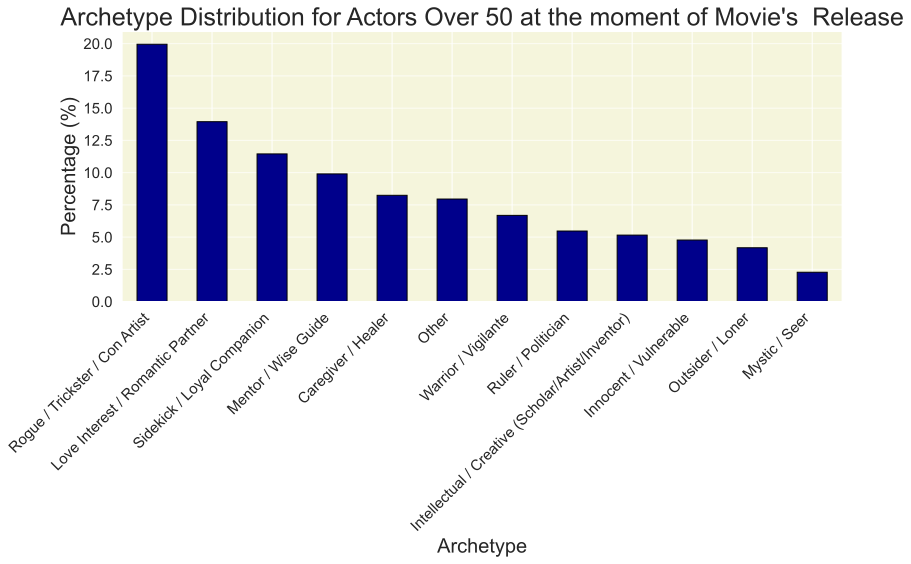

In [45]:
# hidecode
plt.figure(figsize=(12, 8), dpi=300)

old_actors_dist.plot(
    kind="bar",
    color="darkblue",
    edgecolor="black",
    linewidth=1,
)

plt.title(
    "Archetype Distribution for Actors Over 50 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

In [46]:
# ignore
print(len(df_old_actors))

36964


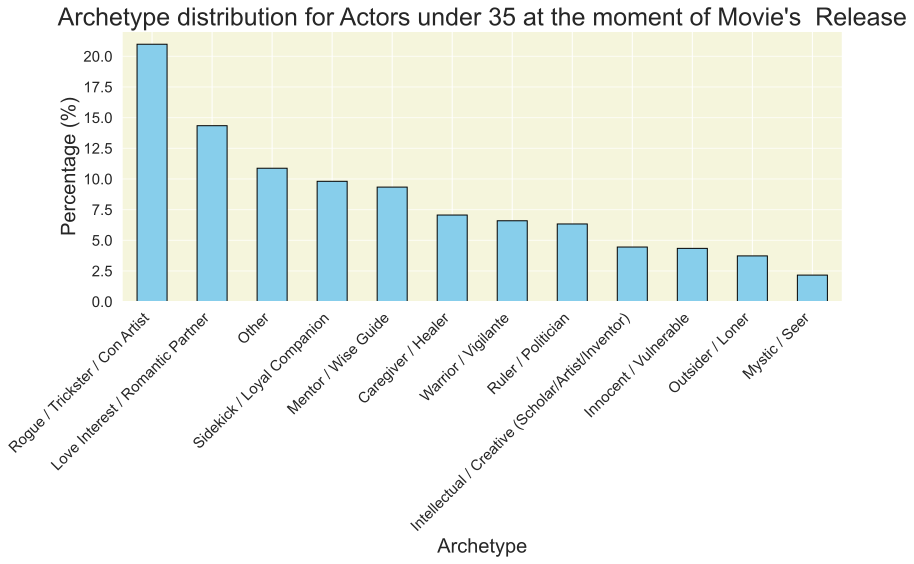

In [47]:
# hidecode
plt.figure(figsize=(12, 8), dpi=300)

young_actors_dist.plot(kind="bar", color="skyblue", edgecolor="black", linewidth=1)

plt.title(
    "Archetype distribution for Actors under 35 at the moment of Movie's  Release",
    fontsize=25,
)
plt.xlabel("Archetype", fontsize=20)
plt.ylabel("Percentage (%)", fontsize=20)
plt.grid(True, axis="y", alpha=0.7)
plt.xticks(fontsize=15, rotation=45, ha="right")
plt.yticks(fontsize=15)
plt.tight_layout()
plt.show()

However, shifts may be observed between older and younger ```Actors```, e.g., a young person is unlikely to be cast to play a 'Wise Guide' character compared to an older one.

In [48]:
# ignore
print(len(df_young_actors))

34927


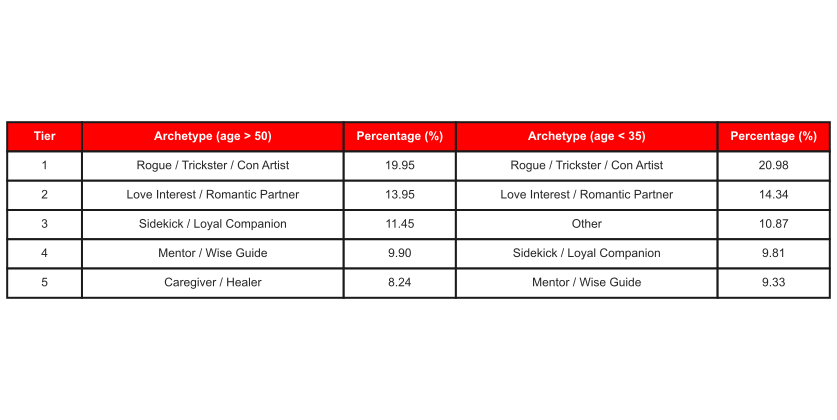

In [49]:
# hidecode
df_old = old_actors_dist.head().round(2).reset_index()
df_young = young_actors_dist.head().round(2).reset_index()
df_old.columns = ["Archetype", "Percentage"]
df_young.columns = ["Archetype", "Percentage"]


plt.figure(figsize=(12, 6), dpi=300)  # , facecolor='#F5F5DC')

ax = plt.gca()
ax.axis("off")

table_data = []
table_data.append(
    [
        "Tier",
        "Archetype (age > 50)",
        "Percentage (%)",
        "Archetype (age < 35)",
        "Percentage (%)",
    ]
)
for i in range(5):
    table_data.append(
        [
            f"{i+1}",
            df_old.iloc[i]["Archetype"],
            f'{df_old.iloc[i]["Percentage"]:.2f}',
            df_young.iloc[i]["Archetype"],
            f'{df_young.iloc[i]["Percentage"]:.2f}',
        ]
    )

table = plt.table(
    cellText=table_data,
    cellLoc="center",
    loc="center",
    colWidths=[0.1, 0.35, 0.15, 0.35, 0.15],
)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 2)

for i in range(len(table_data[0])):
    table._cells[(0, i)].set_facecolor("#FF0000")  # 4472C4 or FF0000
    table._cells[(0, i)].set_text_props(color="white", weight="bold")

for key, cell in table.get_celld().items():
    cell.set_linewidth(2)

plt.tight_layout()
plt.show()

Here we show the top-tier ```Archetypes``` among ```Actors``` who are older than 50 and younger than 35. By Percentage, we mean the proportion of ```Actors``` in these ```Archetypes```, expressed as a percentage.

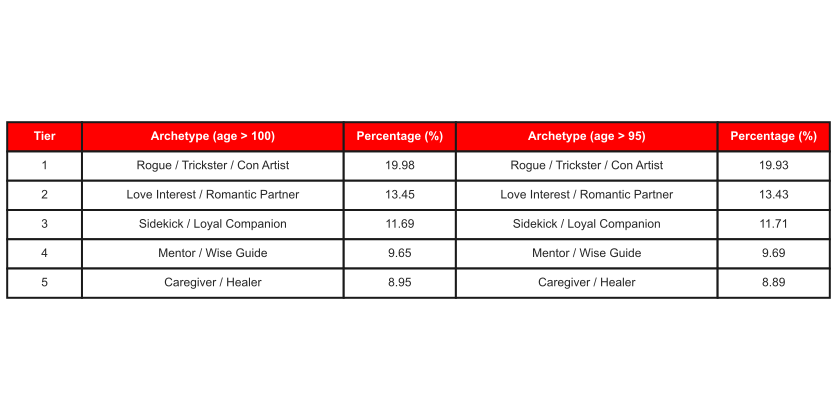

In [50]:
# hidecode
df_old_100 = super_old_actors_dist_100.head().round(2).reset_index()
df_old_95 = super_old_actors_dist_95.head().round(2).reset_index()
df_old_100.columns = ["Archetype", "Percentage"]
df_old_95.columns = ["Archetype", "Percentage"]

plt.figure(figsize=(12, 6), dpi=300)  # , facecolor='#F5F5DC')
ax = plt.gca()
ax.axis("off")

table_data = []
table_data.append(
    [
        "Tier",
        "Archetype (age > 100)",
        "Percentage (%)",
        "Archetype (age > 95)",
        "Percentage (%)",
    ]
)
for i in range(5):
    table_data.append(
        [
            f"{i+1}",
            df_old_100.iloc[i]["Archetype"],
            f'{df_old_100.iloc[i]["Percentage"]:.2f}',
            df_old_95.iloc[i]["Archetype"],
            f'{df_old_95.iloc[i]["Percentage"]:.2f}',
        ]
    )

table = plt.table(
    cellText=table_data,
    cellLoc="center",
    loc="center",
    colWidths=[0.1, 0.35, 0.15, 0.35, 0.15],
)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 2)

for i in range(len(table_data[0])):
    table._cells[(0, i)].set_facecolor("#FF0000")
    table._cells[(0, i)].set_text_props(color="white", weight="bold")

for key, cell in table.get_celld().items():
    cell.set_linewidth(2)

plt.tight_layout()
plt.show()

At the same time, we do not observe the same difference between ```Actors``` over 95 and 100 years old as we do with ```Actors``` over 50. Which is interesting!

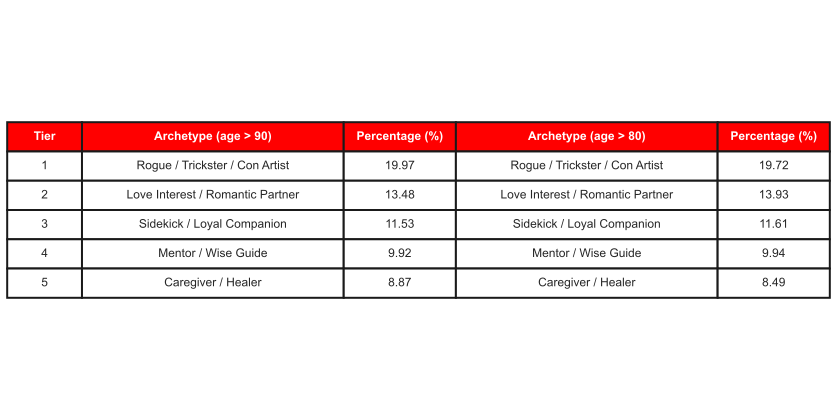

In [51]:
# ignore
df_old_90 = super_old_actors_dist_90.head().reset_index()
df_old_80 = super_old_actors_dist_80.head().reset_index()
# df_old_70 = super_old_actors_dist.head().round(2).reset_index()
df_old_90.columns = ["Archetype", "Percentage"]
df_old_80.columns = ["Archetype", "Percentage"]
# df_old_70.columns = ['Archetype', 'Percentage']

plt.figure(figsize=(12, 6), dpi=300)  # , facecolor='#F5F5DC')
ax = plt.gca()
ax.axis("off")

table_data = []
table_data.append(
    [
        "Tier",
        "Archetype (age > 90)",
        "Percentage (%)",
        "Archetype (age > 80)",
        "Percentage (%)",
    ]
)
for i in range(5):
    table_data.append(
        [
            f"{i+1}",
            df_old_90.iloc[i]["Archetype"],
            f'{df_old_90.iloc[i]["Percentage"]:.2f}',
            df_old_80.iloc[i]["Archetype"],
            f'{df_old_80.iloc[i]["Percentage"]:.2f}',
            # df_old_70.iloc[i]['Archetype'],
            # f'{df_old_70.iloc[i]["Percentage"]:.2f}',
        ]
    )

table = plt.table(
    cellText=table_data,
    cellLoc="center",
    loc="center",
    colWidths=[0.1, 0.35, 0.15, 0.35, 0.15, 0.15, 0.15],
)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 2)

for i in range(len(table_data[0])):
    table._cells[(0, i)].set_facecolor("#FF0000")
    table._cells[(0, i)].set_text_props(color="white", weight="bold")

for key, cell in table.get_celld().items():
    cell.set_linewidth(2)

plt.tight_layout()
plt.show()

In [52]:
# ignore
df_actor_id = df_merged.copy()
df_character_tmp = df_character_processed.copy()

df_actor_id["actor_fb_id"] = (
    df_actor_id["actor_fb_id"].astype(str).str.lower().str.strip()
)
df_character_tmp["Freebase actor ID"] = (
    df_character_tmp["Freebase actor ID"].astype(str).str.lower().str.strip()
)
df_character_tmp = df_character_tmp.drop_duplicates(
    subset="Freebase actor ID", keep="first"
)

df_actor_id.dropna(subset=["actor_fb_id"], inplace=True)
df_character_tmp.dropna(subset=["Freebase actor ID"], inplace=True)

df_actor_id = df_actor_id.merge(
    df_character_tmp[["Freebase actor ID", "Actor name"]],
    left_on="actor_fb_id",
    right_on="Freebase actor ID",
    how="left",
)

df_actor_id.head()

,Unnamed: 0,prediction,original_response,character_name,movie_name,movie_fb_id,actor_fb_id,model,Wikipedia movie ID,Freebase movie ID,...,Movie box office revenue,Movie runtime,languages,movie_release_date,countries_old,countries,genres,release_year,Freebase actor ID,Actor name
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,/m/0c7tjc,Mieko Harada
1,1384,Caregiver / Healer,Caregiver / Healer,Ailes Gilmour,Leonie,/m/05zr2p5,/m/07gnvd,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,/m/07gnvd,Kelly Vitz
2,1841,Caregiver / Healer,Caregiver / Healer,Albiana,Leonie,/m/05zr2p5,/m/053y4h,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,/m/053y4h,Mary Kay Place
3,5092,Other,Other,Art Gallery Patron,Leonie,/m/05zr2p5,/m/0gm10lf,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,/m/0gm10lf,Mike Agresta
4,21926,Mentor / Wise Guide,Mentor / Wise Guide,Dr. Rumely,Leonie,/m/05zr2p5,/m/06k4j6,gpt-3.5-turbo,22611767,/m/05zr2p5,...,NaN,NaN,"['german', 'french', 'english', 'japanese']",2010-01-01,"['United Kingdom', 'United States of America',...","['United Kingdom', 'United States of America',...","['Drama', 'Biography', 'Japanese Cinema']",2010,/m/06k4j6,Jay Karnes


In [53]:
# ignore
df_actor_id.drop(columns=["Freebase actor ID"], inplace=True)
df_actor_id["Actor name"].fillna(df_actor_id["actor_fb_id"], inplace=True)
df_actor_archetype_counts = (
    df_actor_id.groupby(["prediction", "actor_fb_id", "Actor name"])
    .size()
    .reset_index(name="count")
)
df_actor_archetype_counts.head()

,prediction,actor_fb_id,Actor name,count
0,Caregiver / Healer,/m/010xjr,Richard Harris,2
1,Caregiver / Healer,/m/011_3s,Lily Tomlin,3
2,Caregiver / Healer,/m/011_c4,Vivien Merchant,1
3,Caregiver / Healer,/m/011zd3,Lucy Liu,1
4,Caregiver / Healer,/m/0121rx,Jackie Gleason,1


In [54]:
# ignore
df_top_actors_per_archetype = (
    df_actor_archetype_counts.groupby("prediction")
    .apply(lambda x: x.nlargest(10, "count"))
    .reset_index(drop=True)
)
df_top_actors_per_archetype.head()

,prediction,actor_fb_id,Actor name,count
0,Caregiver / Healer,/m/02x02kb,Achala Sachdev,21
1,Caregiver / Healer,/m/04328m,Nirupa Roy,20
2,Caregiver / Healer,/m/019f2f,Ellen Burstyn,19
3,Caregiver / Healer,/m/014g22,Mary Steenburgen,17
4,Caregiver / Healer,/m/0cb1ky,Farida Jalal,17


In [55]:
# ignore
def plot_archetype_pie(archetype, df_actor_per_arc):
    data = df_actor_per_arc[df_actor_per_arc["prediction"] == archetype]
    fig, ax = plt.subplots(figsize=(10, 8))
    # fig.patch.set_facecolor('#F5F5DC')
    ax.pie(
        data["count"],
        labels=data["Actor name"],
        autopct=lambda p: f'{p*sum(data["count"])/100:.0f}',
        textprops={"fontsize": 15},
        wedgeprops={"linewidth": 1, "edgecolor": "black"},
    )

    ax.set_title(f"Top 10 Actors for {archetype}", fontsize=25, pad=30)
    ax.axis("equal")
    plt.show()

In [56]:
# ignore
def plot_archetype_pie_two_cols(df_actor_per_arc):
    unique_archetypes = df_actor_per_arc["prediction"].unique()
    num_archetypes = len(unique_archetypes)
    num_rows = math.ceil(num_archetypes / 2)

    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(15, 5 * num_rows))
    axes = axes.flatten()

    for i, archetype in enumerate(unique_archetypes):
        data = df_actor_per_arc[df_actor_per_arc["prediction"] == archetype]
        ax = axes[i]
        ax.pie(
            data["count"],
            labels=data["Actor name"],
            autopct=lambda p: f'{p*sum(data["count"])/100:.0f}',
            textprops={"fontsize": 15},
            wedgeprops={"linewidth": 1, "edgecolor": "black"},
        )
        ax.set_title(f"Top 10 Actors for {archetype}", fontsize=16, pad=20)
        ax.axis("equal")

    for j in range(num_archetypes, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

In [57]:
# ignore
def plot_actor_archetypes(actor_name, df_actor_per_arc):
    data = df_actor_per_arc[df_actor_per_arc["Actor name"] == actor_name]

    if data.empty:
        print(f"No data available for actor: {actor_name}")
        return

    fig, ax = plt.subplots(figsize=(10, 8))
    # fig.patch.set_facecolor('#F5F5DC')
    ax.pie(
        data["count"],
        labels=data["prediction"],
        autopct=lambda p: f'{p * sum(data["count"])/100:.0f}',
        textprops={"fontsize": 15},
        wedgeprops={"linewidth": 1, "edgecolor": "black"},
    )

    ax.set_title(f"Archetypes for {actor_name}", fontsize=25, pad=30)
    ax.axis("equal")
    plt.show()

Finally, let us discuss which ```Archetypes``` ```Actors``` prefer more and which ```Actors``` are well-suited for specific ```Archetypes```.

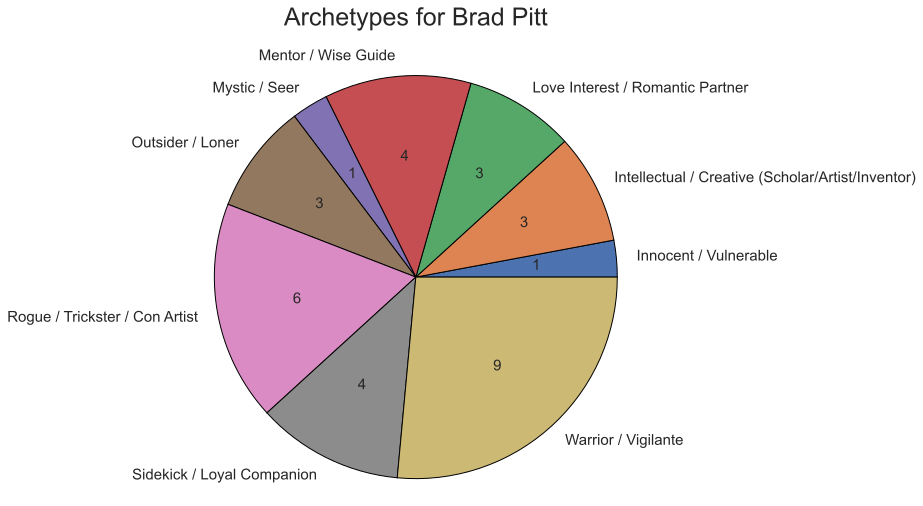

In [58]:
# hidecode
plot_actor_archetypes("Brad Pitt", df_actor_archetype_counts)

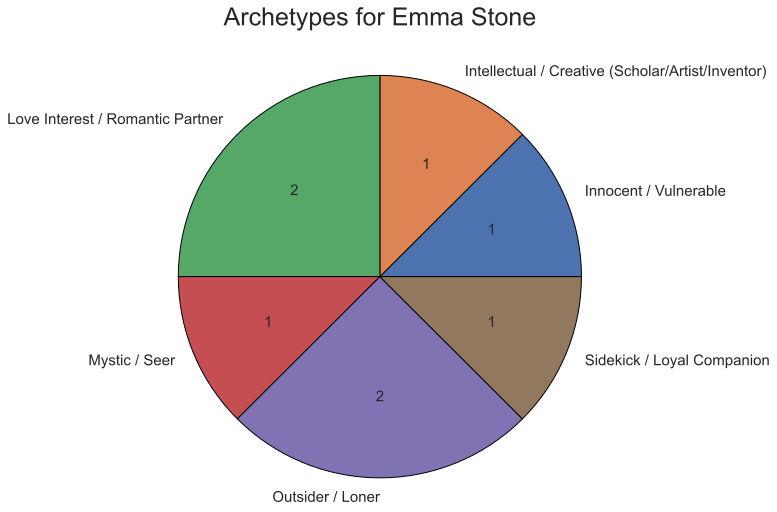

In [59]:
# ignore
plot_actor_archetypes("Emma Stone", df_actor_archetype_counts)

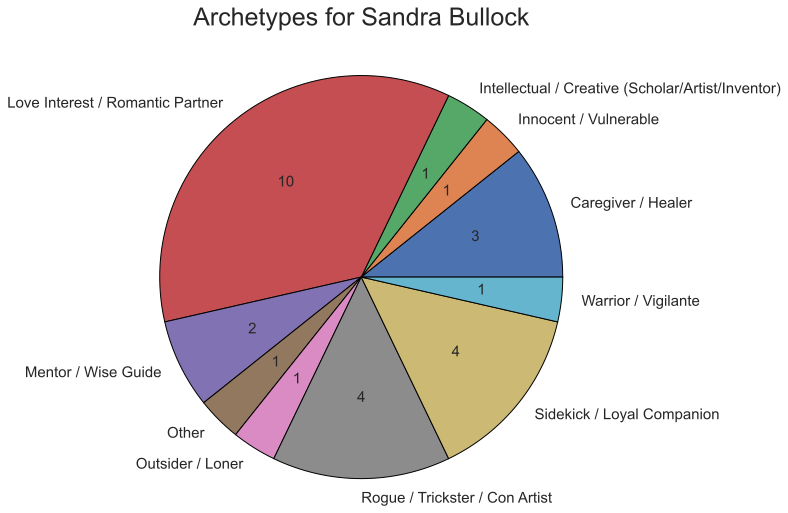

In [60]:
# hidecode
plot_actor_archetypes("Sandra Bullock", df_actor_archetype_counts)

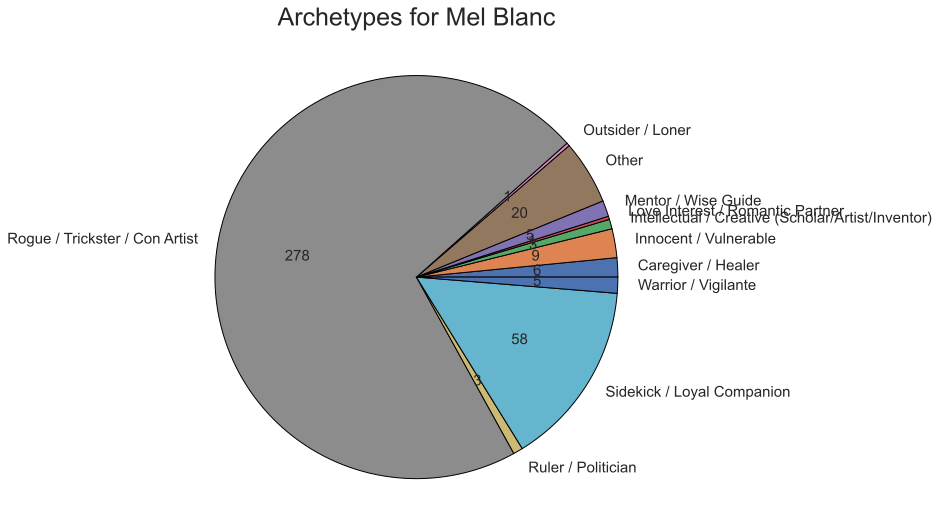

In [61]:
# ignore
plot_actor_archetypes("Mel Blanc", df_actor_archetype_counts)

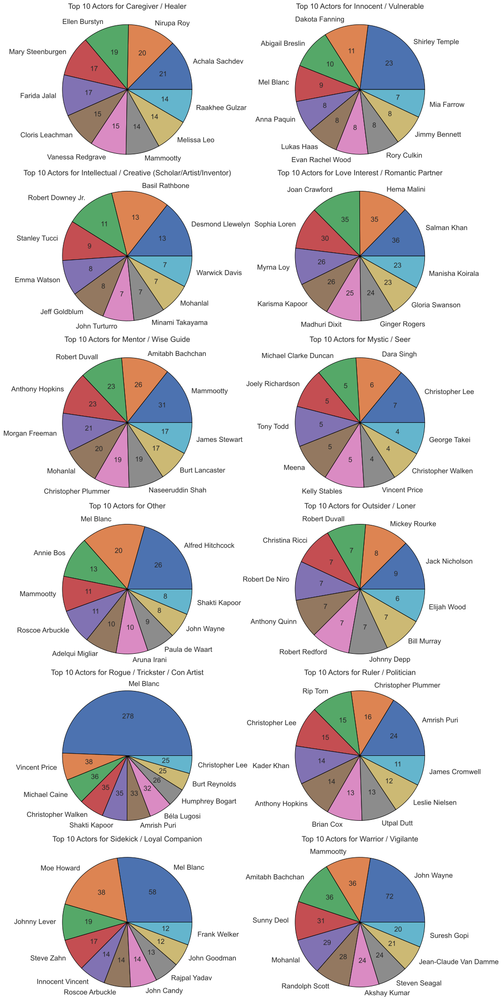

In [62]:
# hidecode
plot_archetype_pie_two_cols(df_top_actors_per_archetype)

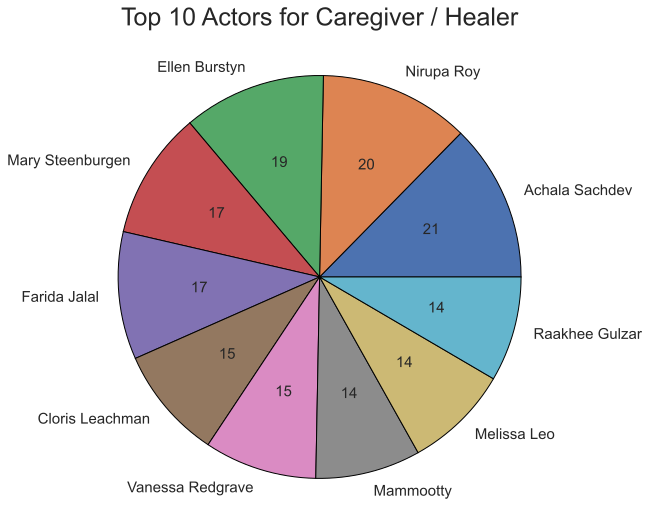

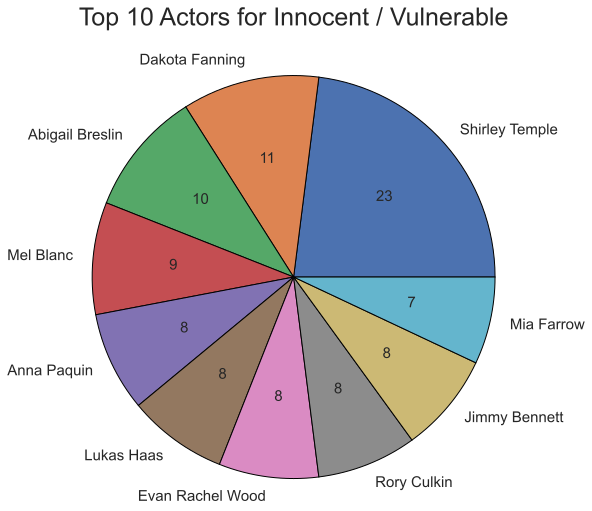

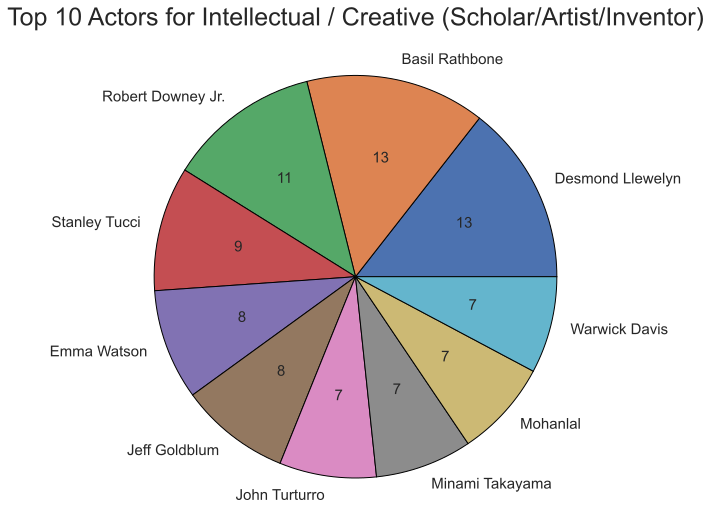

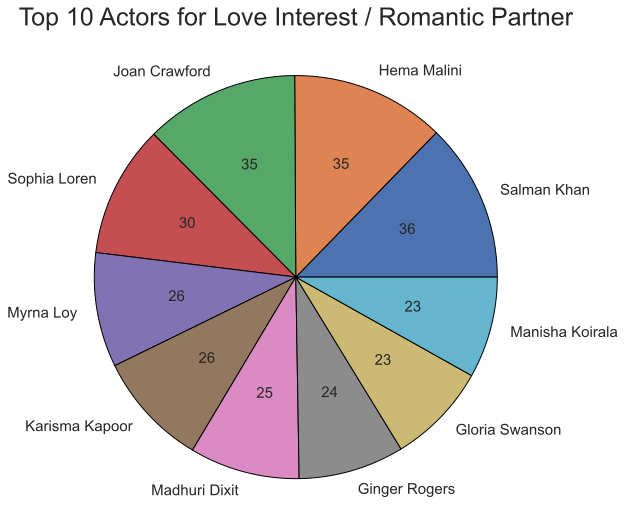

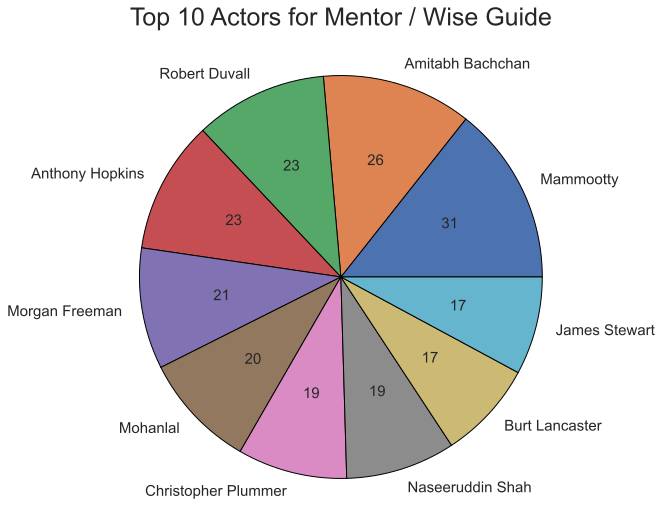

...

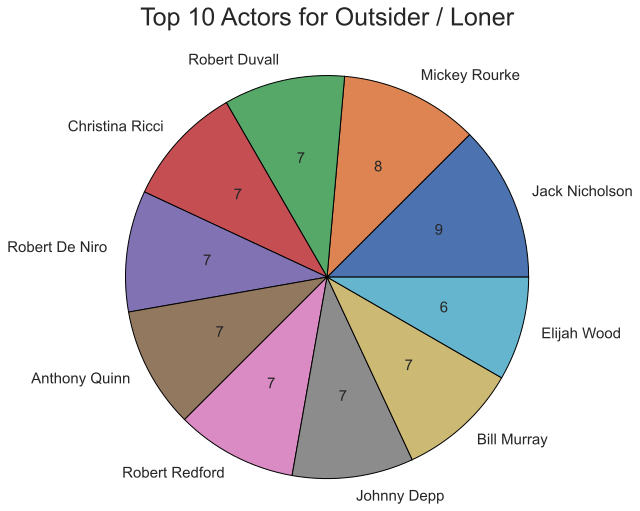

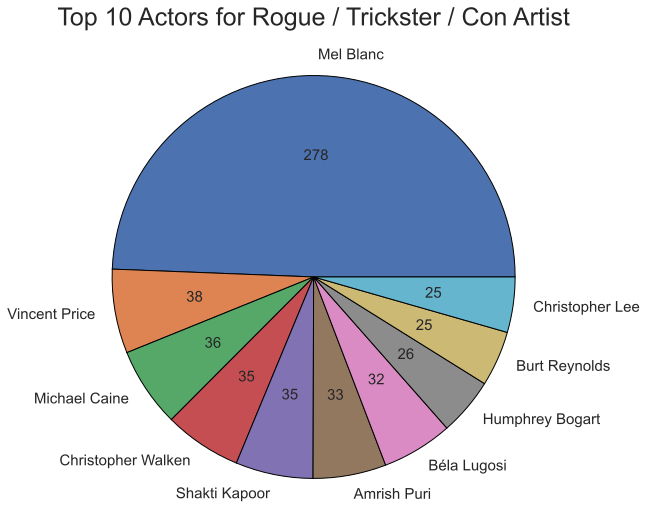

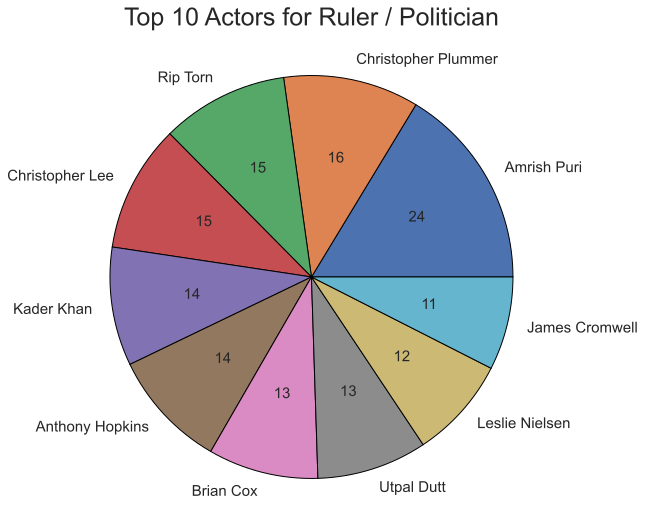

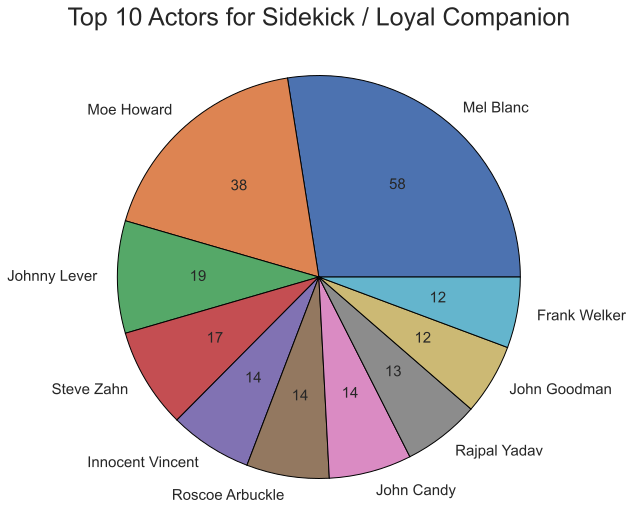

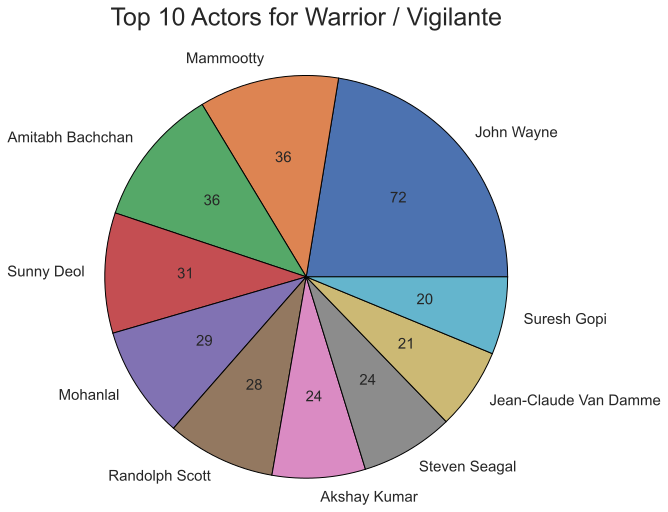

In [63]:
# ignore
for archetype in df_top_actors_per_archetype["prediction"].unique():
    plot_archetype_pie(archetype, df_top_actors_per_archetype)

see more details here: https://github.com/epfl-ada/ada-2024-project-cyberbab00shka/blob/main/src/story/Question_5.ipynb

## Question 6. Are Certain Actors More Likely to Be Typecast into Specific Archetypes?

## Part 1. Actors to be typecasted to specific archetypes

In [1]:
# ignore
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from IPython.display import display, HTML
import io
from datetime import datetime

In [2]:
# ignore
archetype_data = pd.read_csv(
    "../../data/enriched/persona_identification/archetype_predictions_joined.csv"
)
character_data = pd.read_csv("../../data/MovieSummaries/character_processed.csv")
character_data = character_data.rename(
    columns={
        "Wikipedia movie ID": "wikipedia_movie_id",
        "Freebase movie ID": "fb_movie_id",
        "Character name": "character_name",
        "Actor gender": "actor_gender",
        "Actor height (in meters)": "actor_height",
        "Actor ethnicity (Freebase ID)": "fb_actor_eth_id",
        "Actor name": "actor_name",
        "Freebase character/actor map ID": "fb_char_actor_map_id",
        "Freebase character ID": "fb_char_id",
        "Freebase actor ID": "fb_actor_id",
    }
)
character_data = character_data.drop_duplicates(
    subset=["fb_movie_id", "fb_actor_id", "character_name"]
)

df = pd.merge(
    archetype_data,
    character_data,
    how="inner",
    left_on=["actor_fb_id", "movie_fb_id", "character_name"],
    right_on=["fb_actor_id", "fb_movie_id", "character_name"],
)
df = df.rename(columns={"original_response": "archetype"})
df.head(3)

,Unnamed: 0,prediction,archetype,character_name,movie_name,movie_fb_id,actor_fb_id,model,wikipedia_movie_id,fb_movie_id,...,actor_height,fb_actor_eth_id,actor_name,fb_char_actor_map_id,fb_char_id,fb_actor_id,actor_date_of_birth,movie_release_date,ethn_name,race
0,0,Mentor / Wise Guide,Mentor / Wise Guide,Umeko Tsuda,Leonie,/m/05zr2p5,/m/0c7tjc,gpt-3.5-turbo,22611767,/m/05zr2p5,...,1.540,NaN,Mieko Harada,/m/0fpvy15,/m/0n37v4l,/m/0c7tjc,1958-12-26,2010-01-01,NaN,NaN
1,1,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'2-Gun' Gertie Baxter,Roxie Hart,/m/026l5ym,/m/049wny,gpt-4o,7950950,/m/026l5ym,...,1.630,NaN,Iris Adrian,/m/06plhhz,/m/06plhcj,/m/049wny,1912-05-29,1942-02-20,NaN,NaN
2,2,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,gpt-3.5-turbo,33509255,/m/05nszz2,...,1.638,NaN,Ginger Rogers,/m/05ns_30,/m/0h1pslb,/m/0h7dd,1911-07-16,1951-01-01,NaN,NaN


In [3]:
# ignore
init_df = df.copy()

To answer this question let's find the actors sorted in a way of how many roles (characters) they've played

In [4]:
# hidecode
unique_roles_counts = df.groupby("actor_name")["character_name"].nunique().reset_index()

unique_roles_counts.columns = ["actor_name", "unique_character_count"]
sorted_actors = unique_roles_counts.sort_values(
    by="unique_character_count", ascending=False
)
sorted_actors.head()

,actor_name,unique_character_count
12536,John Wayne,129
16022,Mammootty,127
18105,Mohanlal,119
976,Amitabh Bachchan,111
17255,Mel Blanc,97


Now let's check how many actors have 10 or more roles played 

In [5]:
# ignore
actors_with_10_plus_roles = sorted_actors[sorted_actors["unique_character_count"] >= 10]
number_of_actors_10_plus = len(actors_with_10_plus_roles)
print(f"Number of actors with 10 or more unique roles: {number_of_actors_10_plus}")

Number of actors with 10 or more unique roles: 1744


#ignore
This is a sufficient amount of actors to analyze. Now let's make a distribution of archetypes for each actor

In [6]:
# ignore
filtered_df = df[df["actor_name"].isin(actors_with_10_plus_roles["actor_name"])]
filtered_df.head(2)

,Unnamed: 0,prediction,archetype,character_name,movie_name,movie_fb_id,actor_fb_id,model,wikipedia_movie_id,fb_movie_id,...,actor_height,fb_actor_eth_id,actor_name,fb_char_actor_map_id,fb_char_id,fb_actor_id,actor_date_of_birth,movie_release_date,ethn_name,race
2,2,Rogue / Trickster / Con Artist,Rogue / Trickster / Con Artist,'A.J.' Furnival,The Groom Wore Spurs,/m/05nszz2,/m/0h7dd,gpt-3.5-turbo,33509255,/m/05nszz2,...,1.638,NaN,Ginger Rogers,/m/05ns_30,/m/0h1pslb,/m/0h7dd,1911-07-16,1951-01-01,NaN,NaN
4,4,Warrior / Vigilante,Warrior / Vigilante,'Baby Face' Martin,Dead End,/m/0gnrt,/m/03n6r,gpt-4o,61525,/m/0gnrt,...,1.740,/m/07mqps,Humphrey Bogart,/m/0jx1fs,/m/0gz4xcm,/m/03n6r,1899-12-25,1937-01-01,Dutch,European


In [7]:
# ignore
archetype_distribution = (
    filtered_df.groupby(["actor_name", "archetype"]).size().reset_index(name="count")
)
archetype_distribution.head(3)

,actor_name,archetype,count
0,A. J. Cook,Caregiver / Healer,1
1,A. J. Cook,Innocent / Vulnerable,2
2,A. J. Cook,Love Interest / Romantic Partner,2


Now let's normalize the counts:

In [8]:
# ignore
total_roles_per_actor = (
    archetype_distribution.groupby("actor_name")["count"].sum().reset_index()
)
total_roles_per_actor.columns = ["actor_name", "total_roles"]

archetype_distribution = pd.merge(
    archetype_distribution, total_roles_per_actor, on="actor_name"
)
archetype_distribution["probability"] = (
    archetype_distribution["count"] / archetype_distribution["total_roles"]
)

archetype_distribution.head(3)

,actor_name,archetype,count,total_roles,probability
0,A. J. Cook,Caregiver / Healer,1,10,0.1
1,A. J. Cook,Innocent / Vulnerable,2,10,0.2
2,A. J. Cook,Love Interest / Romantic Partner,2,10,0.2


Now we can visualize the archetype distribution for each actor using a bar plot

In [9]:
# ignore
def plot_archetype_distribution(actor_name, archetype_distribution_df):
    actor_data = archetype_distribution_df[
        archetype_distribution_df["actor_name"] == actor_name
    ]

    if actor_data.empty:
        print(f"No data found for actor: {actor_name}")
        return

    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=actor_data, x="archetype", y="probability", hue="archetype", dodge=False
    )
    plt.title(f"Archetype Distribution for {actor_name}", fontsize=16)
    plt.xlabel("Archetype", fontsize=14)
    plt.ylabel("Probability", fontsize=14)
    plt.xticks(rotation=45)
    plt.ylim(0, 1)
    plt.tight_layout()
    plt.show()

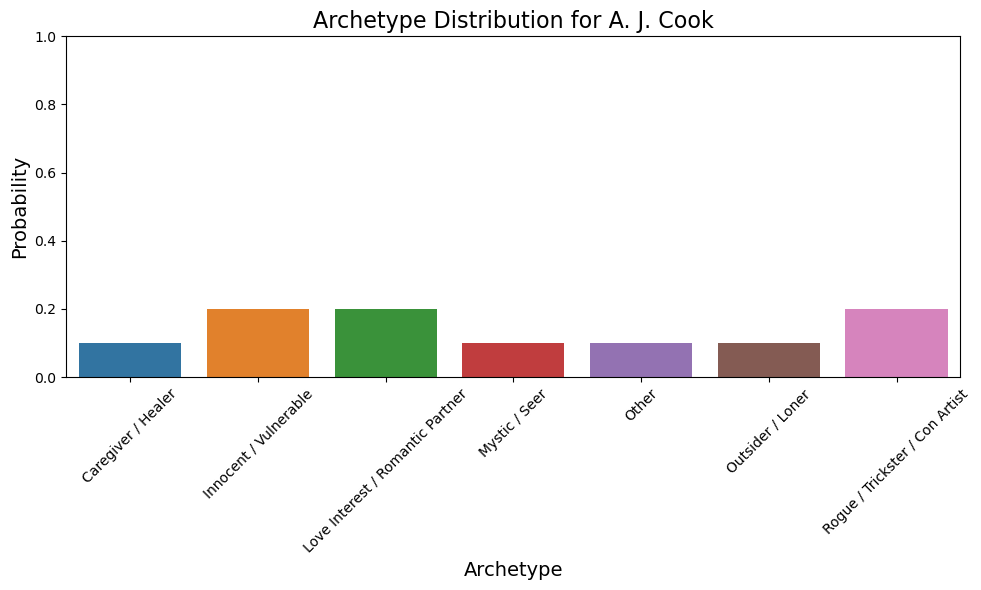

In [10]:
plot_archetype_distribution("A. J. Cook", archetype_distribution)

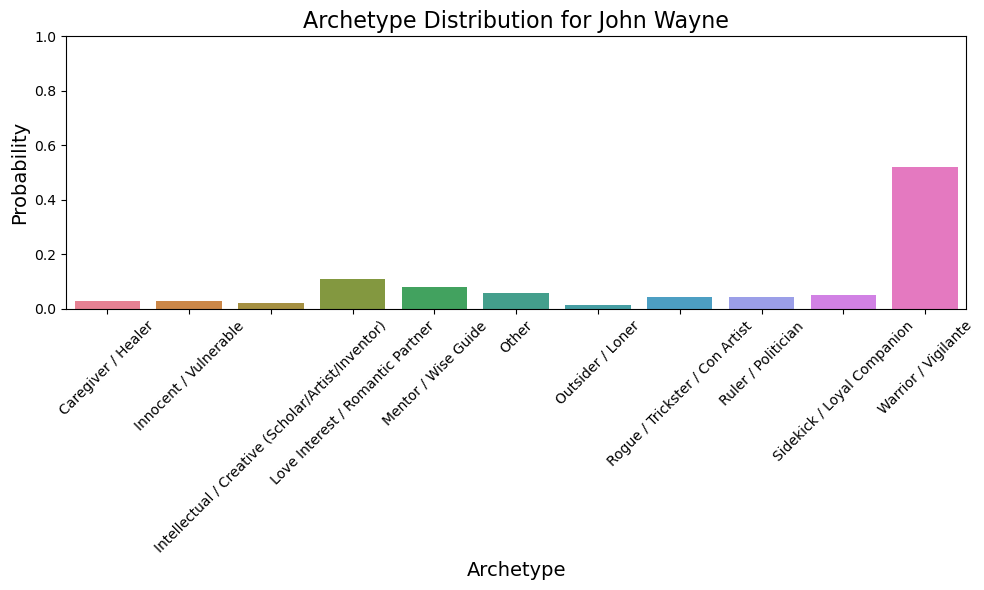

In [11]:
plot_archetype_distribution("John Wayne", archetype_distribution)

By looking at these plots we see that certain actors could or could not more likely to be typecast into specific archetypes. Now let's use some of the statistical approaches and look at the results. For each actor let's define a metric of "probability to being typecasted to the specific (set of) archetypes" as the highest probability among the archetypes in the previous charts. Then let's see the distribution of this value for each actor and visualize it.

In [12]:
# hidecode
max_probabilities = (
    archetype_distribution.groupby("actor_name")["probability"].max().reset_index()
)

max_probabilities.columns = ["actor_name", "max_probability"]
max_probabilities.head(5)

,actor_name,max_probability
0,A. J. Cook,0.200000
1,A.K Hangal,0.411765
2,Aamir Khan,0.360000
3,Aaron Eckhart,0.315789
4,Aaron Johnson,0.272727


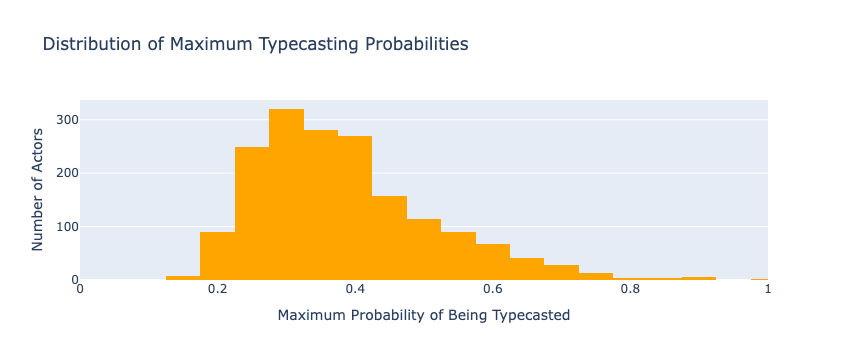

In [13]:
# hidecode
fig = px.histogram(
    max_probabilities,
    x="max_probability",
    nbins=20,
    title="Distribution of Maximum Typecasting Probabilities",
    labels={"max_probability": "Maximum Probability of Being Typecasted"},
    color_discrete_sequence=["orange"],
)

fig.update_layout(
    xaxis_title="Maximum Probability of Being Typecasted",
    yaxis_title="Number of Actors",
    xaxis=dict(nticks=10, range=[0, 1]),
    yaxis_title_standoff=10,
)

fig.show()

Let's analyze this distribution. First, let's look at the descriptive statistics

In [14]:
max_probabilities.describe()

,max_probability
count,1744.000000
mean,0.385056
std,0.129078
min,0.150000
25%,0.294118
50%,0.357143
75%,0.454545
max,1.000000


We can see that the mean is 0.39, meaning that on average 4 times out of 10 (almost a half of the times) actors got selected for the roles with the specific archetypes. However, this does not give us a clear understanding, so let's also perform the Chi-Square Test:

In [15]:
from scipy.stats import chi2_contingency

max_probabilities["binned"] = pd.cut(
    max_probabilities["max_probability"],
    bins=[0, 0.33, 0.66, 1],
    labels=["Low", "Medium", "High"],
)
contingency_table = pd.crosstab(
    max_probabilities["actor_name"], max_probabilities["binned"]
)


chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table)
print(
    f"Chi-square Statistic: {chi2_stat}, p-value: {p_value}, Degrees of Freedom: {dof}"
)

Chi-square Statistic: 3488.0000000000005, p-value: 0.48726319957658, Degrees of Freedom: 3486


Given the high p-value = 0.487 > 0.05 we conclude that there is no significant association (in this mathematical abstraction). In other words, the distribution of maximum probabilities categorized as 'Low', 'Medium', and 'High' does not significantly depend on the actors.
The possible explanation and further development could be that we define max_probability not as the maximum probability for the specific archetype, but take, for example, 3 archetypes with maximum probabilities, which I believe will give the positive answer for this question. Let us check the contingency table and then redefine the ```max_probability```. The contingency table gives understanding of how the categories are visually distributed among actors

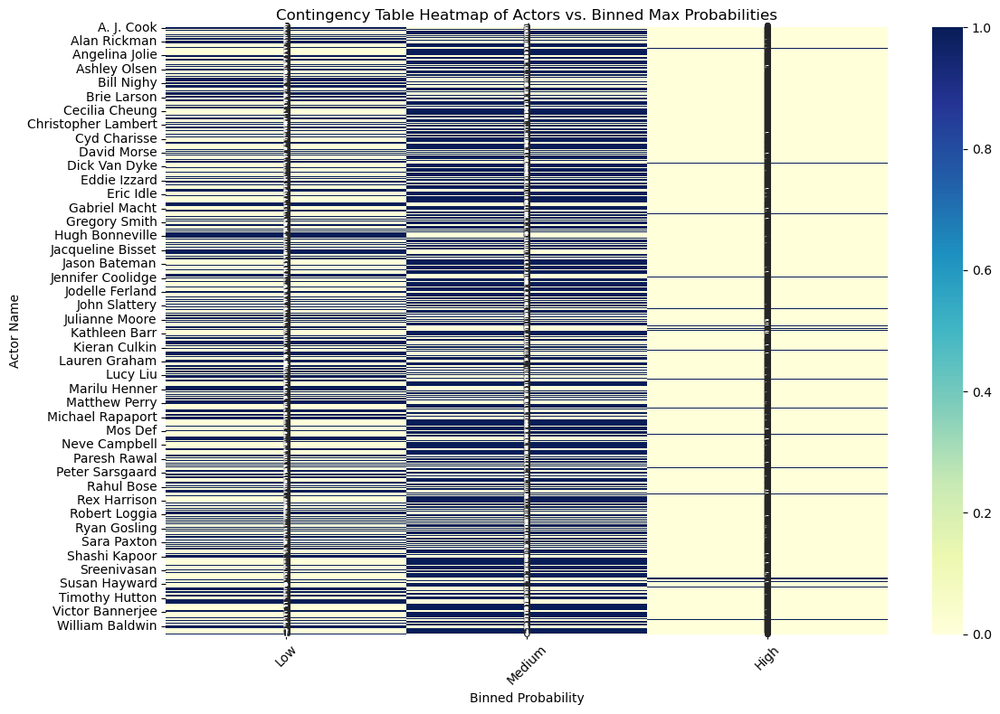

In [16]:
# hidecode
plt.figure(figsize=(12, 8))
sns.heatmap(contingency_table, annot=True, fmt="d", cmap="YlGnBu", cbar=True)
plt.title("Contingency Table Heatmap of Actors vs. Binned Max Probabilities")
plt.xlabel("Binned Probability")
plt.ylabel("Actor Name")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [17]:
# hidecode
top_3_sum_probabilities = (
    archetype_distribution.groupby("actor_name")["probability"]
    .apply(lambda x: x.nlargest(3).sum())
    .reset_index()
)

top_3_sum_probabilities.columns = ["actor_name", "sum_top_3_probabilities"]

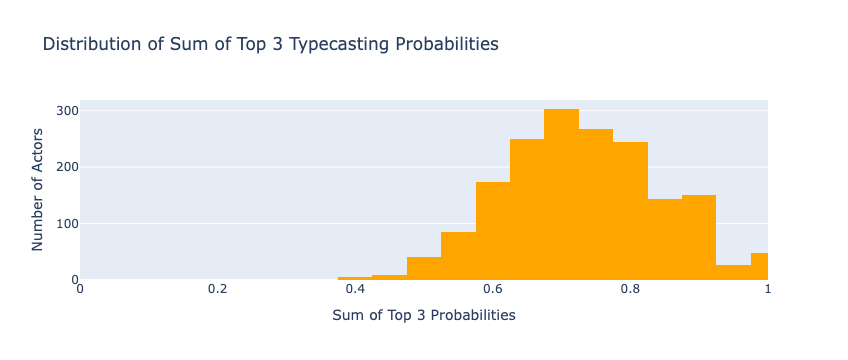

In [18]:
# hidecode
fig = px.histogram(
    top_3_sum_probabilities,
    x="sum_top_3_probabilities",
    nbins=20,
    title="Distribution of Sum of Top 3 Typecasting Probabilities",
    labels={"sum_top_3_probabilities": "Sum of Top 3 Probabilities"},
    color_discrete_sequence=["orange"],
)

fig.update_layout(
    xaxis_title="Sum of Top 3 Probabilities",
    yaxis_title="Number of Actors",
    xaxis=dict(nticks=10, range=[0, 1]),
    yaxis_title_standoff=10,
)

fig.show()

In [19]:
top_3_sum_probabilities.describe()

,sum_top_3_probabilities
count,1744.000000
mean,0.731918
std,0.116027
min,0.400000
25%,0.647059
50%,0.727273
75%,0.812500
max,1.000000


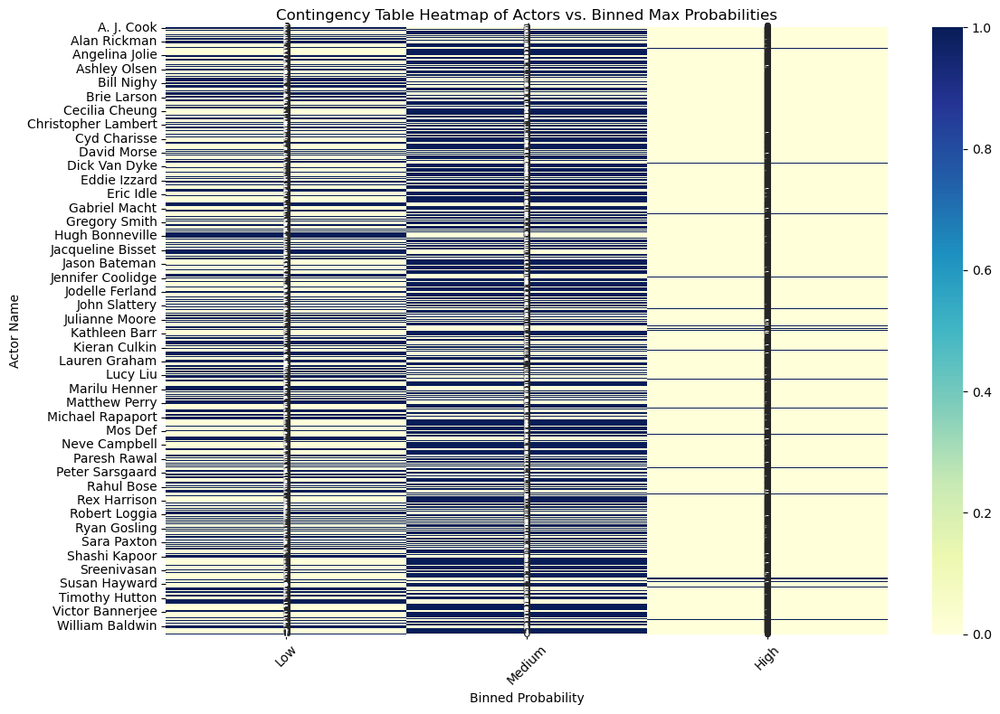

In [20]:
# hidecode
plt.figure(figsize=(12, 8))
sns.heatmap(contingency_table, annot=True, fmt="d", cmap="YlGnBu", cbar=True)
plt.title("Contingency Table Heatmap of Actors vs. Binned Max Probabilities")
plt.xlabel("Binned Probability")
plt.ylabel("Actor Name")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [21]:
# hidecode
top_3_sum_probabilities["binned"] = pd.cut(
    top_3_sum_probabilities["sum_top_3_probabilities"],
    bins=[0, 0.33, 0.66, 1],
    labels=["Low", "Medium", "High"],
)

contingency_table = pd.crosstab(
    top_3_sum_probabilities["actor_name"], top_3_sum_probabilities["binned"]
)
chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table)
print(
    f"Chi-square Statistic: {chi2_stat}, p-value: {p_value}, Degrees of Freedom: {dof}"
)

Chi-square Statistic: 1744.0, p-value: 0.4887414065286344, Degrees of Freedom: 1743


Even though this looks better, we still should check the statistical criterium:

For visual insight let's look at the Contingency Table with actors and the Max Probabilities:

### Conclusion
Given this definition ot typecasting (based on ```max_probabilities```) the Chi-square test didn't provide a positive answer to our question. The answer to this question varies on different parameter, so we can proceed to part 2 to analyze the insights brought by these parameters.

## Part 2. Analyzing the typecasting of actors with specific traits to the archetypes



### Gender

Let us create a separate dataframe to analyze the distribution of ```actor_gender``` by each archetype with significant occurrences.

In [22]:
# hidecode
df_by_gender = df[df["archetype"].str.len() <= 30].groupby(
    ["archetype", "actor_gender"]
)
df_by_gender = df_by_gender.size().reset_index(name="count")
df_by_gender = (
    df_by_gender.pivot(index="archetype", columns="actor_gender", values="count")
    .fillna(0)
    .astype(int)
)
df_by_gender["total"] = df_by_gender.get("M", 0) + df_by_gender.get("F", 0)
df_by_gender = df_by_gender[df_by_gender["total"] >= 100]
df_by_gender

actor_gender,F,M,total
archetype,,,
Caregiver / Healer,4705,2041,6746
Innocent / Vulnerable,2587,1434,4021
Mentor / Wise Guide,1644,6721,8365
Mystic / Seer,849,1113,1962
Other,3567,4442,8009
Outsider / Loner,982,2491,3473
Rogue / Trickster / Con Artist,3933,13848,17781
Ruler / Politician,623,4453,5076
Sidekick / Loyal Companion,1605,7721,9326


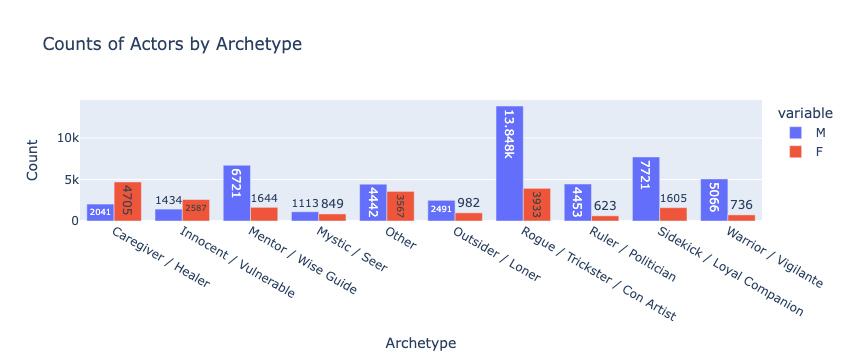

In [23]:
# hidecode
fig = px.bar(
    df_by_gender.reset_index(),
    x="archetype",
    y=["M", "F"],
    title="Counts of Actors by Archetype",
    labels={"value": "Count", "archetype": "Archetype"},
    text_auto=True,
    barmode="group",
)
fig.show()

### Conclusions
From here we can draw some conclusions:
- Women represent the Caregiver / Healer archetype in the movies significatly more often than Men
- Women represent the Innocent / Vulnerable archetype in the movies more often than Men
- Men represent the following archetypes in the movies significatly more often than Women:
    * Mentor / Wise Guide,
  * Outsider / Loner,
  * Rogue / Thinkster / Con Artist,
  * Ruler / Politician, Sidekick / Loyal Companion,
  * Warrior / Vigilante

Some of the biases could include the samplings of the movies in our dataset, however general trends are visible from this barplot and also correlate with stereotypical representation. 

### Height

Let us plot a distribution of actors by height and define 3 categories: lower than 25 percentile - small, 25-75 - medium, 75-100 - high. After we can analyze how actors with the height in the specific range are distributed across the archetypes. The important note is that men are on average heigher then women, so for the clearness of our assumptions let's take men's data, for example (same can be applied for women).

In [35]:
# hidecode
df = init_df.copy()
df = df[
    (df["actor_height"] <= 2.1)
    & (df["actor_height"] >= 1.5)
    & (df["actor_gender"] == "M")
]

percentiles = df["actor_height"].quantile([0.25, 0.75])
p25 = percentiles[0.25]
p75 = percentiles[0.75]

print(f"Small Threshold: {p25}")
print(f"High Threshold: {p75}")


def categorize_height(height):
    if height < p25:
        return "Small"
    elif p25 <= height <= p75:
        return "Medium"
    else:
        return "High"


df.loc[:, "height_category"] = df["actor_height"].apply(categorize_height)

df_heights = df[["actor_name", "actor_height", "height_category"]].head(5)
df_heights.head()

Small Threshold: 1.75
High Threshold: 1.85


,actor_name,actor_height,height_category
4,Humphrey Bogart,1.74,Small
6,Matt McCoy,1.85,Medium
9,Faizon Love,1.77,Medium
14,Robert Taylor,1.82,Medium
15,Humphrey Bogart,1.74,Small


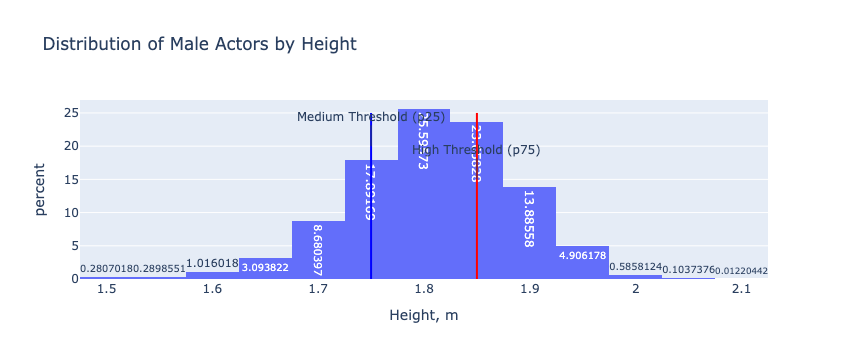

In [37]:
# hidecode
df_sorted = df.sort_values(by="actor_height")
fig = px.histogram(
    df_sorted,
    x="actor_height",
    title="Distribution of Male Actors by Height",
    labels={"actor_height": "Height, m"},
    nbins=30,
    text_auto=True,
    histnorm="percent",
)

fig.add_shape(
    type="line",
    x0=p25,
    y0=0,
    x1=p25,
    y1=25,
    line=dict(color="blue"),
    name="25th Percentile",
)

fig.add_shape(
    type="line",
    x0=p75,
    y0=0,
    x1=p75,
    y1=25,
    line=dict(color="red"),
    name="75th Percentile",
)
fig.add_annotation(
    x=p25,
    y=20,
    text="Medium Threshold (p25)",
    ax=0,
)

fig.add_annotation(
    x=p75,
    y=15,
    text="High Threshold (p75)",
    ax=0,
)

fig.show()

In [38]:
# hidecode
df_by_height = df[df["archetype"].str.len() <= 30]
df_by_height = (
    df_by_height.groupby(["archetype", "height_category"])
    .size()
    .reset_index(name="count")
)
df_by_height = (
    df_by_height.pivot(index="archetype", columns="height_category", values="count")
    .fillna(0)
    .astype(int)
)
df_by_height["total"] = df_by_height.sum(axis=1)
df_by_height = df_by_height[df_by_height["total"] >= 100]
df_by_height

height_category,High,Medium,Small,total
archetype,,,,
Caregiver / Healer,267,607,237,1111
Innocent / Vulnerable,78,404,253,735
Mentor / Wise Guide,1110,2301,719,4130
Mystic / Seer,187,318,113,618
Other,381,803,371,1555
Outsider / Loner,308,902,310,1520
Rogue / Trickster / Con Artist,2036,4782,1693,8511
Ruler / Politician,733,1240,341,2314
Sidekick / Loyal Companion,988,2256,1090,4334


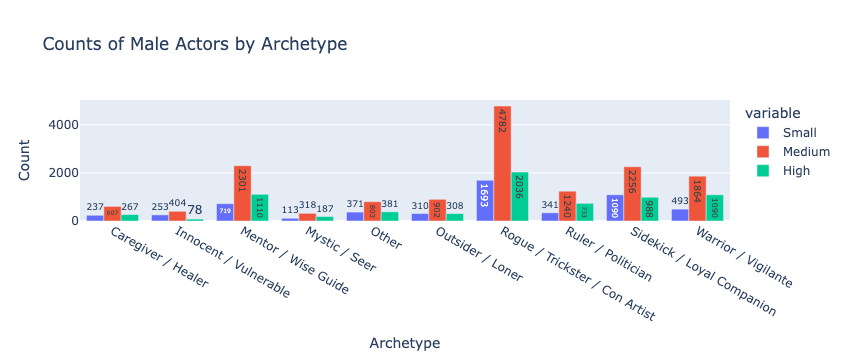

In [39]:
# hidecode
fig = px.bar(
    df_by_height.reset_index(),
    x="archetype",
    y=["Small", "Medium", "High"],
    title="Counts of Male Actors by Archetype",
    labels={"value": "Count", "archetype": "Archetype"},
    text_auto=True,
    barmode="group",
)
fig.show()

From here we can see that it is uncommon for the Innocent / Vulnerable archetype, for example, to be played by high actors.
Another insight could be that for Ruler / Politician and Warrior / Vigilante it is uncommon that actors with small height play them. We would use these insights in our further analysis. Now let's do the same with women and get:

In [40]:
# ignore
df = init_df.copy()
df = df[
    (df["actor_height"] <= 2.1)
    & (df["actor_height"] >= 1.5)
    & (df["actor_gender"] == "F")
]

percentiles = df["actor_height"].quantile([0.25, 0.75])
p25 = percentiles[0.25]
p75 = percentiles[0.75]

print(f"Small Threshold: {p25}")
print(f"High Threshold: {p75}")


def categorize_height(height):
    if height < p25:
        return "Small"
    elif p25 <= height <= p75:
        return "Medium"
    else:
        return "High"


df.loc[:, "height_category"] = df["actor_height"].apply(categorize_height)
df_heights = df[["actor_name", "actor_height", "height_category"]].head(5)
df_heights.head()

Small Threshold: 1.62
High Threshold: 1.71


,actor_name,actor_height,height_category
0,Mieko Harada,1.540,Small
1,Iris Adrian,1.630,Medium
2,Ginger Rogers,1.638,Medium
5,Morgan Brittany,1.626,Medium
13,Louise Brooks,1.570,Small


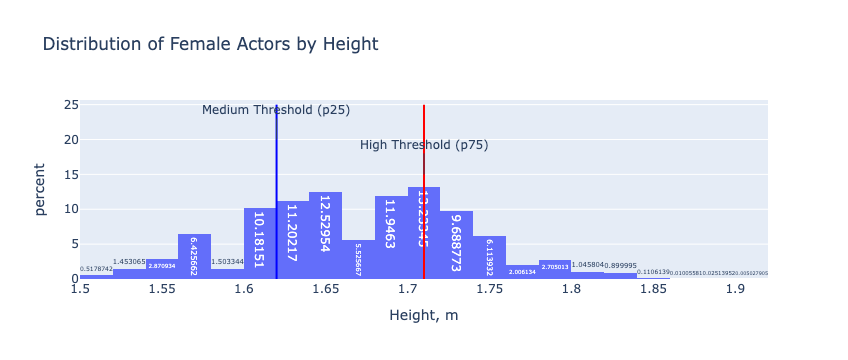

In [41]:
# hidecode
df_sorted = df.sort_values(by="actor_height")
fig = px.histogram(
    df_sorted,
    x="actor_height",
    title="Distribution of Female Actors by Height",
    labels={"actor_height": "Height, m"},
    nbins=30,
    text_auto=True,
    histnorm="percent",
)

fig.add_shape(
    type="line",
    x0=p25,
    y0=0,
    x1=p25,
    y1=25,
    line=dict(color="blue"),
    name="25th Percentile",
)

fig.add_shape(
    type="line",
    x0=p75,
    y0=0,
    x1=p75,
    y1=25,
    line=dict(color="red"),
    name="75th Percentile",
)
fig.add_annotation(
    x=p25,
    y=20,
    text="Medium Threshold (p25)",
    ax=0,
)

fig.add_annotation(
    x=p75,
    y=15,
    text="High Threshold (p75)",
    ax=0,
)

fig.show()

In [42]:
# ignore
df_by_height = df[df["archetype"].str.len() <= 30]
df_by_height = (
    df_by_height.groupby(["archetype", "height_category"])
    .size()
    .reset_index(name="count")
)
df_by_height = (
    df_by_height.pivot(index="archetype", columns="height_category", values="count")
    .fillna(0)
    .astype(int)
)
df_by_height["total"] = df_by_height.sum(axis=1)
df_by_height = df_by_height[df_by_height["total"] >= 100]
df_by_height

height_category,High,Medium,Small,total
archetype,,,,
Caregiver / Healer,634,1413,681,2728
Innocent / Vulnerable,290,790,513,1593
Mentor / Wise Guide,265,575,248,1088
Mystic / Seer,129,252,116,497
Other,381,853,317,1551
Outsider / Loner,168,370,157,695
Rogue / Trickster / Con Artist,714,1504,562,2780
Ruler / Politician,121,210,86,417
Sidekick / Loyal Companion,227,568,274,1069


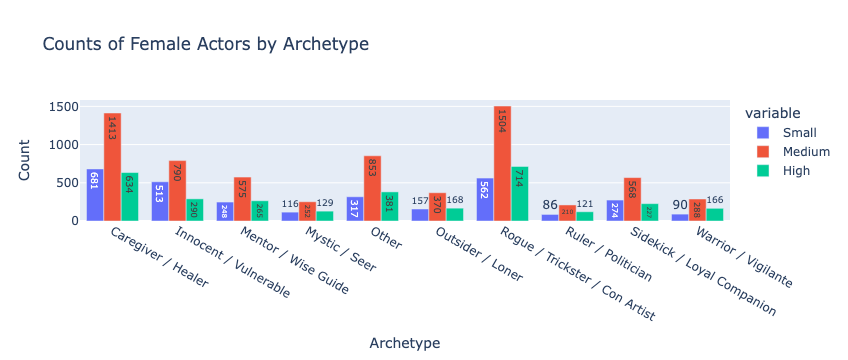

In [43]:
# hidecode
fig = px.bar(
    df_by_height.reset_index(),
    x="archetype",
    y=["Small", "Medium", "High"],
    title="Counts of Female Actors by Archetype",
    labels={"value": "Count", "archetype": "Archetype"},
    text_auto=True,
    barmode="group",
)
fig.show()

From here we can see that it is uncommon for the Innocent / Vulnerable archetype, for example, to be played by high actresses, making an inclinde towards actresses with small and medium heights. However, the examples for Ruler / Politician and Warrior / Vigilante are not the same as with men, though we cannot draw conclusions from it.

### Age

Let's follow the same logic and see the percentiles for age:

In [44]:
# hidecode
df = init_df.copy()
df["actor_date_of_birth"] = pd.to_datetime(df["actor_date_of_birth"], errors="coerce")
df["movie_release_date"] = pd.to_datetime(df["movie_release_date"], errors="coerce")
df["age_at_release"] = (
    (df["movie_release_date"] - df["actor_date_of_birth"]).dt.days // 365
).astype(int)
percentiles = df["age_at_release"].quantile([0.25, 0.75])
p25 = percentiles[0.25]
p75 = percentiles[0.75]

print(f"25th Percentile: {p25}")
print(f"75th Percentile: {p75}")

25th Percentile: 27.0
75th Percentile: 47.0


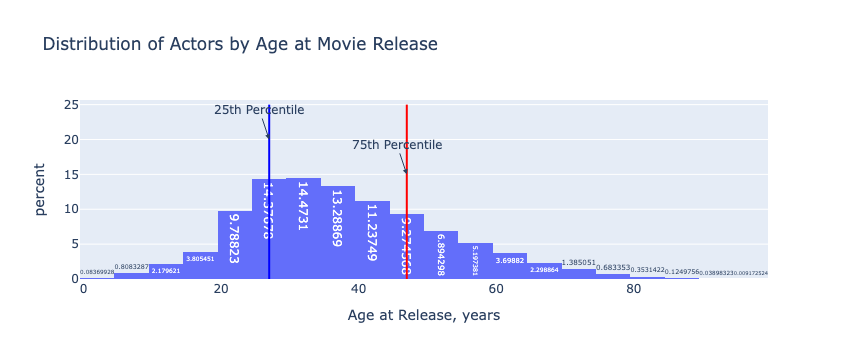

In [45]:
fig = px.histogram(
    df,
    x="age_at_release",
    title="Distribution of Actors by Age at Movie Release",
    labels={"age_at_release": "Age at Release, years"},
    nbins=30,
    text_auto=True,
    histnorm="percent",
)

fig.add_shape(type="line", x0=p25, y0=0, x1=p25, y1=25, line=dict(color="blue"))

fig.add_shape(type="line", x0=p75, y0=0, x1=p75, y1=25, line=dict(color="red"))

fig.add_annotation(x=p25, y=20, text="25th Percentile", showarrow=True, arrowhead=2)

fig.add_annotation(x=p75, y=15, text="75th Percentile", showarrow=True, arrowhead=2)
fig.show()

For this particular case let's consider actors with the age less or equal than 20 as young and more or equal than 60 as old and make a new pivoted table as in the previous cases.

In [46]:
# hidecode
def categorize_age(age):
    if age <= 20:
        return "Young"
    elif age >= 60:
        return "Old"
    else:
        return "Middle-aged"


df["age_category"] = df["age_at_release"].apply(categorize_age)

df_by_age = df[df["archetype"].str.len() <= 30]
df_by_age = (
    df_by_age.groupby(["archetype", "age_category"]).size().reset_index(name="count")
)
df_by_age = (
    df_by_age.pivot(index="archetype", columns="age_category", values="count")
    .fillna(0)
    .astype(int)
)
df_by_age["total"] = df_by_age.sum(axis=1)
df_by_age = df_by_age[df_by_age["total"] >= 100]
df_by_age.head(10)

age_category,Middle-aged,Old,Young,total
archetype,,,,
Caregiver / Healer,5364,871,522,6757
Innocent / Vulnerable,2213,76,1748,4037
Mentor / Wise Guide,6421,1660,294,8375
Mystic / Seer,1525,308,134,1967
Other,6672,790,583,8045
Outsider / Loner,2899,212,372,3483
Rogue / Trickster / Con Artist,16022,1185,605,17812
Ruler / Politician,3916,1112,58,5086
Sidekick / Loyal Companion,7869,489,997,9355


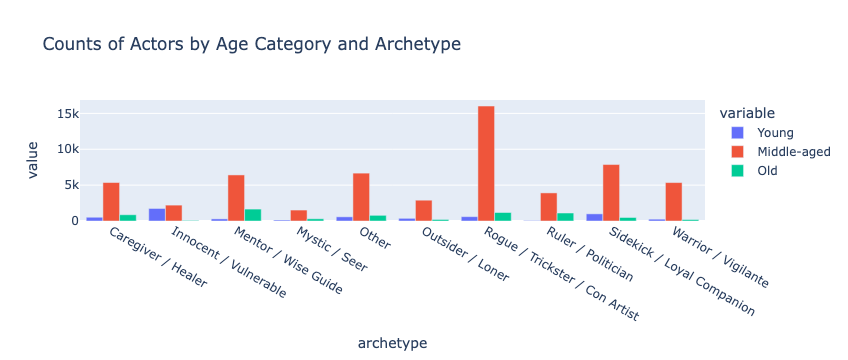

In [68]:
# hidecode
fig = px.bar(
    df_by_age.reset_index(),
    x="archetype",
    y=["Young", "Middle-aged", "Old"],
    title="Counts of Actors by Age Category and Archetype",
    labels={"age_category": "Age Category", "count": "Number of Actors"},
    barmode="group",
)
fig.show()

Here are some insights we can draw from this plot:
- If an actor is old, then for the archetypes of Mentor / Wise Guide it is higly possible that this actor can play it (the ratio with Middle-aged is not as big as for others). Other possible archetypes are Ruler / Politician (with also good ratio) or Rogue / Trickster / Con Artist (though less probable)
- If an actor is young, then it is a high chance he/she would be typecasted to Innocent / Vulnerable archetype.

## Insights Check

Let's check some of our hypothesis'. Let's take, for example, a young female and with the relatively small heights and check their distributions by archetypes. Our analysis indicates that in most cases they would be typecasted to Innocent / Vulnerable archetype.

In [67]:
# hidecode
df["actor_date_of_birth"] = pd.to_datetime(df["actor_date_of_birth"], errors="coerce")
df["movie_release_date"] = pd.to_datetime(df["movie_release_date"], errors="coerce")
df["age_at_release"] = (
    (df["movie_release_date"] - df["actor_date_of_birth"]).dt.days // 365
).astype(int)

age_threshold = 22
height_threshold = 1.65

filtered_actors = df[
    (df["actor_gender"] == "F")
    & (df["actor_age"] <= age_threshold)
    & (df["actor_height"] < height_threshold)
]

In [64]:
filtered_actors.head()

,Unnamed: 0,prediction,archetype,character_name,movie_name,movie_fb_id,actor_fb_id,model,wikipedia_movie_id,fb_movie_id,...,fb_char_actor_map_id,fb_char_id,fb_actor_id,actor_date_of_birth,movie_release_date,ethn_name,race,age_at_release,age_category,actor_age
77368,77368,Innocent / Vulnerable,Innocent / Vulnerable,Sunny Baudelaire,Lemony Snicket's A Series of Unfortunate Events,/m/04k9y6,/m/04pr_b,gpt-4o,1228937,/m/04k9y6,...,/m/0j_x1q,/m/04x2rn,/m/04pr_b,2002-08-02,2004-12-16,NaN,NaN,2,Young,22
77369,77369,Innocent / Vulnerable,Innocent / Vulnerable,Sunny Baudelaire,Lemony Snicket's A Series of Unfortunate Events,/m/04k9y6,/m/075jxk9,gpt-4o,1228937,/m/04k9y6,...,/m/09rrbch,/m/04x2rn,/m/075jxk9,2002-08-02,2004-12-16,NaN,NaN,2,Young,22
83161,83161,Caregiver / Healer,Caregiver / Healer,Vanessa,November Christmas,/m/0dsbr6l,/m/0fqmc4w,gpt-3.5-turbo,29602277,/m/0dsbr6l,...,/m/0hzxvh1,/m/04dwzvd,/m/0fqmc4w,2002-05-06,2010-01-01,NaN,NaN,7,Young,22


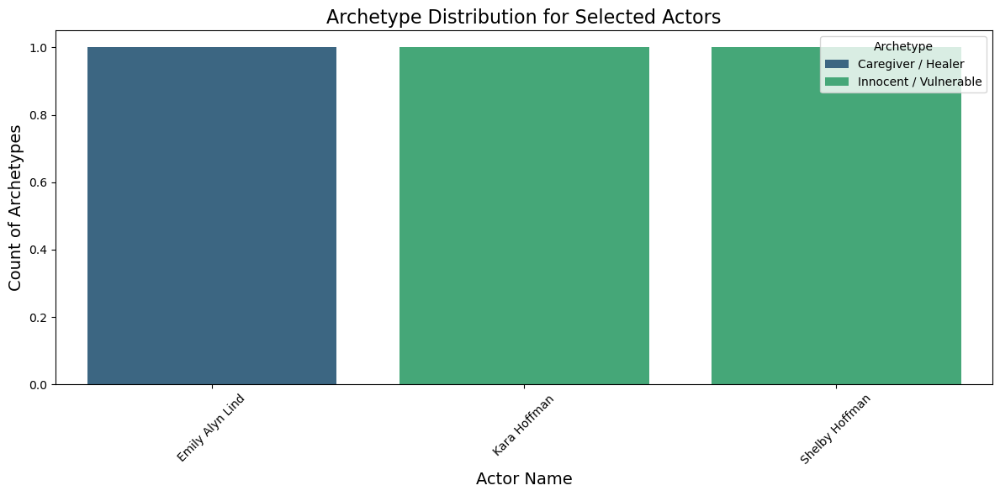

In [66]:
# hidecode
archetype_counts = (
    filtered_actors.groupby(["actor_name", "archetype"])
    .size()
    .reset_index(name="count")
)
plt.figure(figsize=(12, 6))
sns.barplot(
    data=archetype_counts, x="actor_name", y="count", hue="archetype", palette="viridis"
)
plt.title("Archetype Distribution for Selected Actors", fontsize=16)
plt.xlabel("Actor Name", fontsize=14)
plt.ylabel("Count of Archetypes", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Archetype")
plt.tight_layout()
plt.show()

which arguably corresponds with our conclusions

# Question 7. What Is the Composite Image of the "Ideal" Actor for a Given Character Archetype?

Our analysis reveals that an actor’s traits can significantly influence the roles they are cast in and the archetypes they portray. In this section, we aim to identify the most representative actor profiles for specific archetypes based on historical data. To achieve this, we calculate the average traits of actors associated with each archetype and determine the characteristics most commonly linked to that archetype. We then identify actors whose traits closely align with these averages. The results are the following:

In [1]:
# ignore
%load_ext autoreload
%autoreload 2

import sys

sys.path.insert(0, "../..")

In [2]:
# ignore
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from src.scripts.load_data import data

In [3]:
# ignore

# Filter only actors with information about weight and height
pd.options.mode.chained_assignment = None

actors_with_stats = data[~(data.actor_height.isna() | data.weight.isna())]
actors_with_stats["actor_date_of_birth"] = pd.to_datetime(
    actors_with_stats.actor_date_of_birth
)
actors_with_stats["movie_release_date"] = pd.to_datetime(
    actors_with_stats.movie_release_date
)

actors_with_stats["years_at_release"] = actors_with_stats["years_in_film"]

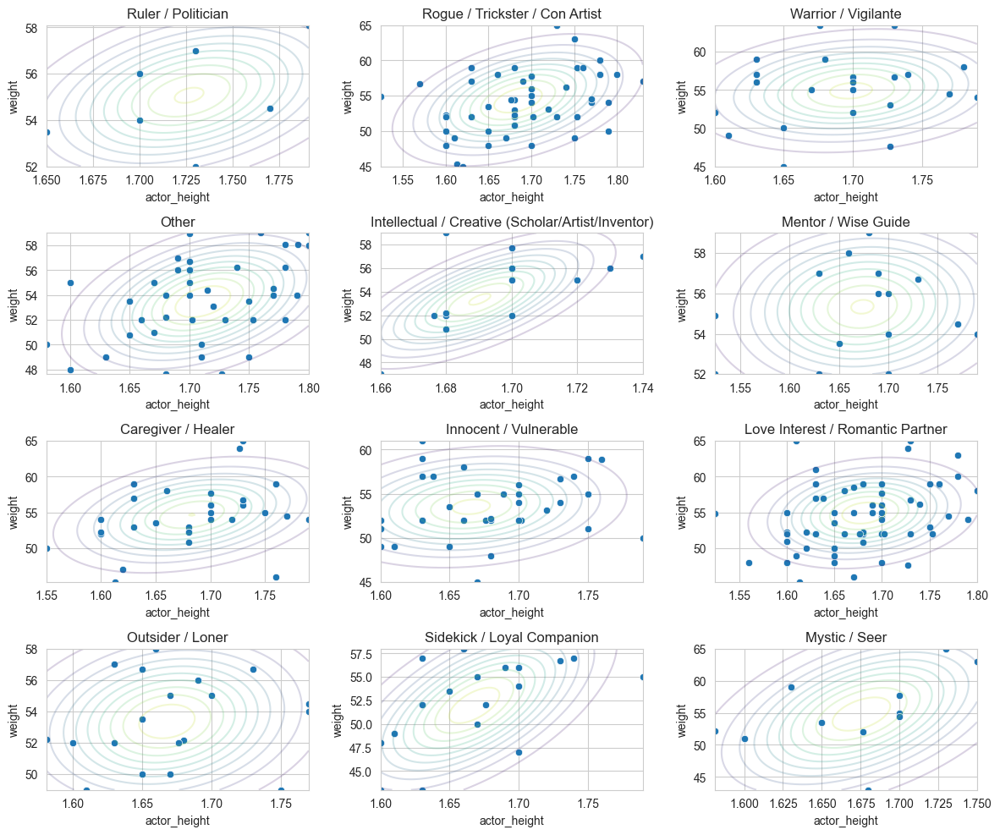

In [4]:
# ignore
from scipy.stats import shapiro
from scipy.stats import multivariate_normal

# Let's check if the distribution of weight/height close to normal for each archetype


def iqr_drop_outliers(df, col):
    height = np.array(df[col])
    q1 = np.percentile(height, 25)
    q3 = np.percentile(height, 75)
    iqr = q3 - q1

    # Define bounds
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    return df[(height >= lower_bound) & (height <= upper_bound)]


cur_gender = "F"
sns.set_style("whitegrid")
plt.figure(figsize=(12, 12))
for i, arch in enumerate(actors_with_stats["archetype"].unique()):
    plt.subplot(5, 3, i + 1)
    sample = actors_with_stats[actors_with_stats.archetype == arch]
    sample = sample[sample.actor_gender == cur_gender]
    sample = iqr_drop_outliers(sample, "actor_height")
    sample = iqr_drop_outliers(sample, "weight")

    plt.title(arch)

    nparray_sample = np.array([sample.actor_height, sample.weight]).T
    mean_estimated = np.mean(nparray_sample, axis=0)
    cov_estimated = np.cov(nparray_sample, rowvar=False)
    x, y = np.linspace(
        nparray_sample[:, 0].min(), nparray_sample[:, 0].max(), 100
    ), np.linspace(nparray_sample[:, 1].min(), nparray_sample[:, 1].max(), 100)
    X, Y = np.meshgrid(x, y)
    pos = np.dstack((X, Y))
    rv = multivariate_normal(mean_estimated, cov_estimated)
    pdf = rv.pdf(pos)
    plt.contour(X, Y, pdf, levels=10, cmap="viridis", alpha=0.2)

    sns.scatterplot(x=sample.actor_height, y=sample.weight)
plt.tight_layout()

In [5]:
# ignore
arch_data = {}

# Plot's seems ok, we'll fit the parameters of the distributions:
for i, arch in enumerate(actors_with_stats["archetype"].unique()):
    most_prob_gender = (
        data[data.archetype == arch].actor_gender.value_counts().keys()[0]
    )
    sample = actors_with_stats[actors_with_stats.actor_gender == most_prob_gender]
    prob_estimated = (sample.archetype == arch).mean()
    sample = sample[sample.archetype == arch]
    sample = iqr_drop_outliers(sample, "actor_height")
    sample = iqr_drop_outliers(sample, "years_at_release")
    sample = iqr_drop_outliers(sample, "weight")

    nparray_sample = np.array(
        [sample.actor_height, sample.weight, sample.years_at_release]
    ).T
    mean_estimated = np.mean(nparray_sample, axis=0)
    cov_estimated = np.cov(nparray_sample, rowvar=False)

    arch_data[arch] = {
        "data": sample.copy(),
        "mean": mean_estimated,
        "cov": cov_estimated,
        "prob": prob_estimated,
        "gender": most_prob_gender,
    }

In [6]:
# ignore
from scipy.stats import multivariate_normal

# Now we can find actors with highest likelihood
actor_stats_np = np.array(
    [
        actors_with_stats.actor_height,
        actors_with_stats.weight,
        actors_with_stats.years_at_release,
    ]
).T

arch_to_most_fitting_actors = {}

for i, arch in enumerate(actors_with_stats["archetype"].unique()):
    cur_arch_data = arch_data[arch]
    estimator = multivariate_normal(cur_arch_data["mean"], cur_arch_data["cov"])
    pdf = estimator.pdf(actor_stats_np)
    # arch_to_most_fitting_actors[arch] = actors_with_stats.iloc[pdf.argsort()].groupby('actor_name').first()[:-4:-1] #groupby reorders
    most_fitting_actors = actors_with_stats.iloc[pdf.argsort()][::-1]
    unique_actors = []
    taken_actor_names = []
    for _, row in most_fitting_actors.iterrows():
        if row["actor_name"] not in taken_actor_names:
            taken_actor_names.append(row["actor_name"])
            unique_actors.append(row)
    arch_to_most_fitting_actors[arch] = pd.DataFrame(unique_actors)

In [7]:
# ignore
arch_to_most_fitting_actors["Love Interest / Romantic Partner"]

,archetype,character_name,movie_name,actor_gender,actor_height,actor_name,actor_date_of_birth,movie_release_date,ethn_name,race,...,nationality,gender,place_of_birth,weight,religion,fb_movie_id,fb_actor_id,years_in_film,actor_bmi,years_at_release
1410,Love Interest / Romantic Partner,Aisha,Body of Lies,F,1.690,Golshifteh Farahani,1983-07-10,2008-10-05,NaN,NaN,...,France,Female,Tehran,55.0,NaN,/m/02q0k7v,/m/0cmy25,25.240246,19.257029,25.240246
49281,Love Interest / Romantic Partner,Maggie Verver,The Golden Bowl,F,1.700,Kate Beckinsale,1973-07-26,2000-05-14,English,European,...,United Kingdom,Female,"Finsbury Park, London",55.0,NaN,/m/0fbjkn,/m/01pk8v,26.800821,19.031142,26.800821
77183,Rogue / Trickster / Con Artist,Sugar,Diamonds,F,1.700,Jenny McCarthy,1972-11-01,1999-09-06,Irish,European,...,United States of America,Female,Evergreen Park,54.0,Catholicism,/m/026wy_s,/m/02t_99,26.844627,18.685121,26.844627
37719,Love Interest / Romantic Partner,Jessie Machalan,Riverworld,F,1.690,Laura Vandervoort,1984-09-22,2010-04-18,NaN,NaN,...,Canada,Female,Toronto,56.0,NaN,/m/0gyl2hg,/m/0k0rvp,25.568789,19.607157,25.568789
30034,Sidekick / Loyal Companion,Grace Santiago,Money Train,F,1.700,Jennifer Lopez,1969-07-24,1995-11-22,Puerto Rican,Latino,...,United States of America,Female,Castle Hill,56.0,Catholicism,/m/0bhh9g,/m/043zg,26.329911,19.377163,26.329911
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4521,Warrior / Vigilante,Anton 'The Pro' Protopov,The Big Bang,M,2.100,Robert Maillet,1969-10-26,2010-11-03,Acadian,European,...,Canada,Male,"Sainte-Marie-de-Kent, New Brunswick",158.8,NaN,/m/0g9y7q0,/m/06tg05,41.021218,36.009070,41.021218
43712,Warrior / Vigilante,Kung Fu Giant,Rush Hour 3,M,2.356,Sun Mingming,1983-08-23,2007-07-30,NaN,NaN,...,China,Male,Bayan County,168.0,NaN,/m/06x43v,/m/05sv0t,23.934292,30.266257,23.934292
82473,Sidekick / Loyal Companion,Tut Beemer,MacGruber,M,1.900,Mark Henry,1971-06-12,2010-05-21,African American,African,...,United States of America,Male,Silsbee,189.6,NaN,/m/09rsmds,/m/040vtr,38.940452,52.520776,38.940452
16924,Mystic / Seer,"Dagoth, the Horned God",Conan the Destroyer,M,2.240,André the Giant,1946-05-19,1984-06-29,NaN,NaN,...,France,Male,Grenoble,240.0,NaN,/m/03_8cd,/m/0_f5,38.113621,47.831633,38.113621



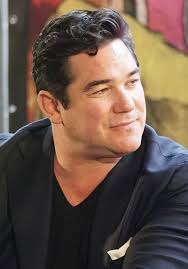
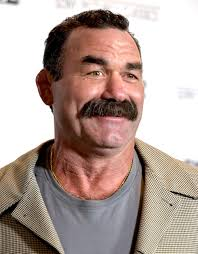
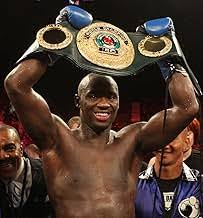
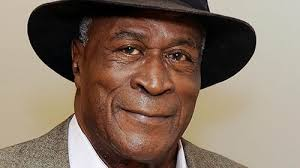
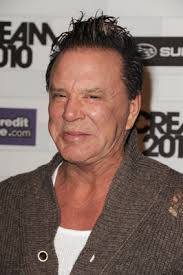
...
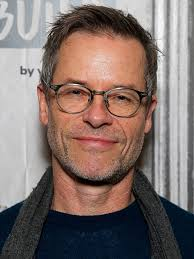
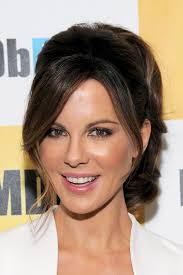
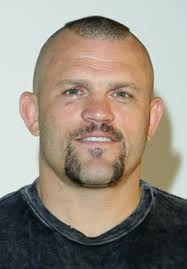
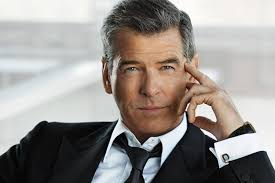
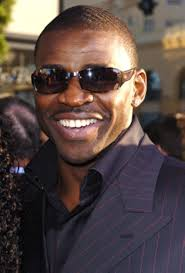

In [9]:
# hidecode
from src.scripts.actor_overview_app import get_actor_overview_html
from IPython.display import display

archetypes = set(actors_with_stats["archetype"].unique()) - set({"Other"})

res_html = get_actor_overview_html(archetypes, arch_data, arch_to_most_fitting_actors)
display(res_html)

# Conclusion

Overall, we successfully executed our proposal from the second checkpoint in its entirety. All the additional datasets we mentioned were utilized in this work successfully.

Moreover, the core idea — that we can infer an archetype for each character — proved to be effective. We managed to gather all the necessary information for this purpose and made predictions for the complete dataset, making our project idea feasible.

For every question posed in the proposal, you will find a detailed, data-driven answer on this page. We will not list all the funny findings here in conclusion, but there definitely were a lot!